# Dimensionality Reduction and Clustering application on Fashion-MNIST

The notebook initiates by loading the Fashion MNIST dataset using Keras, splitting it into training, validation, and testing subsets. It then processes the image data by flattening it and scaling the pixel values. The code integrates various clustering techniques and evaluation metrics in two dictionaries for easy access.
 In the main loop, the algorithm iterates through different dimensionality reduction techniques (and without reduction), applying each clustering technique to the preprocessed data while recording execution times. Visualizations, such as plots, original/reconstructed images, and true label percentages, are generated to provide insights into clustering outcomes. The loop also computes metrics for each combination of clustering and dimensionality reduction methods, storing crucial information, including algorithm names, execution times, and metric scores, in a structured dataframe for analysis.

 **Important:** To run this code you can either run the title above this cell for a complete run, or run "Setup" once and then whichever Dimensionality Reduction technique from "Main" you'd like. Also, you can add yout own clustering algorithms and metrics following the instructions in "Dictionaries of Clustering and Metrics". Happy coding!


## Setup

### Load Data

In [ ]:
import keras
from sklearn.model_selection import train_test_split

# Load Fashion MNIST dataset
(x_train, y_train), (x_test, y_test) = keras.datasets.fashion_mnist.load_data()

# Split the training data into training and validation sets
x_train, x_val, y_train, y_val = train_test_split(x_train, y_train, test_size=0.2, random_state=42)

# Ensure the shapes of the split datasets
assert x_train.shape == (48000, 28, 28) # Train Dataset
assert x_val.shape == (12000, 28, 28) # Validation Dataset
assert y_train.shape == (48000,) #Train Labels
assert y_val.shape == (12000,) # Validation Labels
assert x_test.shape == (10000, 28, 28) # Test Dataset
assert y_test.shape == (10000,) # Test Labels

label_names = {
    0: "T-shirt/top",
    1: "Trouser",
    2: "Pullover",
    3: "Dress",
    4: "Coat",
    5: "Sandal",
    6: "Shirt",
    7: "Sneaker",
    8: "Bag",
    9: "Ankle Boot"
}

In [ ]:
# @title Scale and Flatten
import numpy as np
from sklearn.preprocessing import StandardScaler

def preprocess_data(x):
    x = x.reshape(x.shape[0], -1).astype(np.float32) / 255.0
    return x

# Apply preprocessing to the datasets
x_train = preprocess_data(x_train)
x_val = preprocess_data(x_val)
x_test = preprocess_data(x_test)

In [ ]:
# @title Reduce size
size = 1200
#x_test = x_test[:size]
#y_test = y_test[:size]

### Plot Functions

#### Image Comparison

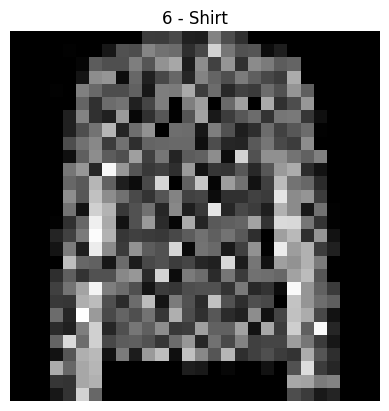

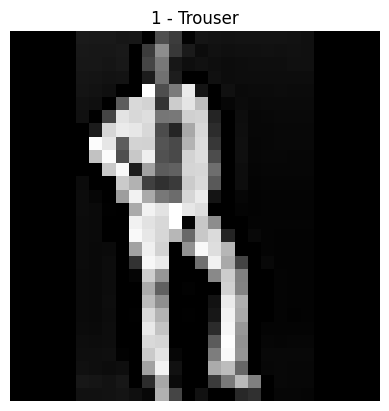

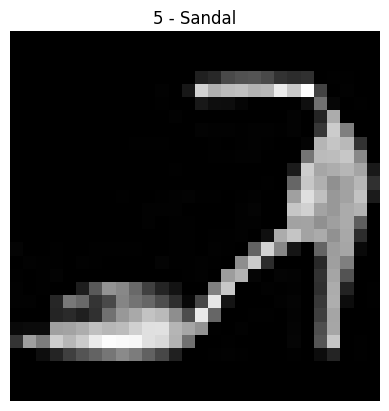

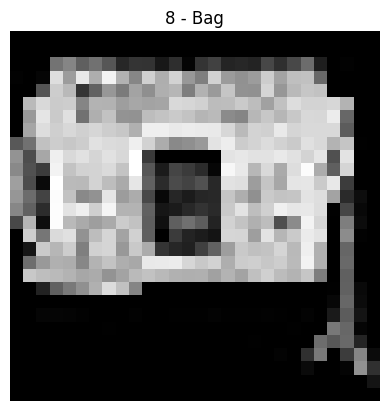

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Returns 10 random image indexes, one for each class in class_range
def select_class_indexes(images, labels, class_range):
    selected_indices = []

    for class_num in class_range:
        class_indices = np.where(labels == class_num)[0]
        selected_index = np.random.choice(class_indices)
        selected_indices.append(selected_index)

    return selected_indices

# Global image indexes so they're the same for every DR technique
selected_ind = select_class_indexes(x_test, y_test, list(range(10)))
#selected_ind = [859, 9543, 4203, 194, 5881, 9255, 8974, 2077, 505, 7550] The items of the report

print("Selected items for this run: ", selected_ind)
def compare_images_plot(original_images, reconstructed_images, labels, name, selected_ind=selected_ind):
    original_images = original_images[selected_ind]
    reconstructed_images = reconstructed_images[selected_ind]
    labels = labels[selected_ind]

    num_images = len(selected_ind)
    num_columns = 5  # Define the number of columns to display (5 images per row)

    if num_images <= num_columns:
        num_columns = num_images
        num_rows = 2
    else:
        num_rows = num_images // num_columns + (num_images % num_columns > 0)

    plt.figure(figsize=(2 * num_columns, 8))
    plt.suptitle(f"Comparison Between Original and Reconstructed Images ({name})", fontsize=num_images + 10)

    for i in range(num_images):
        row = i // num_columns  # Calculate the row for placement
        col = i % num_columns  # Calculate the column for placement

        # Original Images
        ax1 = plt.subplot(2 * num_rows, num_columns, 2 * row * num_columns + col + 1)
        plt.imshow(original_images[i].reshape(28, 28), cmap='gray')  # Remove 'aspect' parameter
        plt.axis('off')  # Turn off axis
        plt.title(f"{labels[i]} - {label_names[labels[i]]} ({selected_ind[i]})", fontsize=12)

        # Reconstructed Images
        ax2 = plt.subplot(2 * num_rows, num_columns, 2 * row * num_columns + col + 1 + num_columns)
        plt.imshow(reconstructed_images[i].reshape(28, 28), cmap='gray')
        ax2.get_xaxis().set_visible(False)
        ax2.get_yaxis().set_visible(False)

    plt.tight_layout()
    plt.show()

def display_image(image, label=None, dr_name = None):
  reshaped_image = image.reshape(28, 28)
  plt.imshow(reshaped_image, cmap='gray')

  if label:
      plt.title(f"{label} - {label_names[label]}")
  if dr_name:
      plt.title(f"{dr_name}")

  plt.axis('off')
  plt.show()

def display_case_studies(reconstr, dr_name):
  for idx in case_studies:
    display_image(reconstr[idx],  dr_name = dr_name)

case_studies = [
    562, # Shirt
    1592, # Trouser? (Human)
    5152, # Sandal
    9856, # Bag
]

for idx in case_studies:
  display_image(x_test[idx], label=y_test[idx])


#### Cluster Plots

In [ ]:
import seaborn as sns
from collections import Counter

def plot_clusters(data, labels, title, dr_title):
    df_visualization = pd.DataFrame({
        'Dimension 1': data[:, 0],
        'Dimension 2': data[:, 1],
        'Cluster': labels
    })

    plt.figure(figsize=(10, 8))
    sns.scatterplot(
        x='Dimension 1', y='Dimension 2',
        hue='Cluster', data=df_visualization,
        palette='viridis', s=20
    )
    plt.title(f'{title} Clustering Results ({dr_title})')
    plt.show()

def plot_cluster_images(labels, images, unique_clusters, title, dr_title, num_images=10):
    num_unique_clusters = len(unique_clusters)

    if num_unique_clusters < 4:
        selected_clusters = unique_clusters
    else:
        selected_clusters = np.random.choice(unique_clusters, 4, replace=False)

    for cluster_num in selected_clusters:
        cluster_indices = np.where(labels == cluster_num)[0]
        num_cluster_indices = len(cluster_indices)

        if num_cluster_indices < num_images:
            print(f"Not enough images in Cluster {cluster_num+1} for plotting. ({num_cluster_indices} images)")
        else:
            selected_indices = np.random.choice(cluster_indices, num_images, replace=False)

            plt.figure(figsize=(10, 1.5))
            for i, index in enumerate(selected_indices):
                plt.subplot(1, num_images, i + 1)
                img = images[index].reshape(28, 28)  # Reshape the flattened image to 28x28
                plt.imshow(img, cmap='gray')
                plt.title(f'{y_test[index]} ({label_names[y_test[index]]})', fontsize=8)
                plt.axis('off')
            plt.suptitle(f'{title} Cluster {cluster_num+1} ({dr_title})', y=1)
            plt.tight_layout()
            plt.show()

# Note: This took a very long time to make. It's just ChatGPT code at this point, it's probably very inefficient, but it looks pretty!
def plot_true_label_percentages(true_labels, predicted_labels, unique_clusters, clustering_technique_name, dr_name):
    num_clusters = len(unique_clusters)
    num_labels = len(label_names)

    # Define a color map based on the number of unique labels
    color_map = plt.cm.get_cmap('tab20', num_labels)
    label_color_dict = {label: color_map(label % num_labels) for label in set(true_labels)}

    num_rows = 1 if num_clusters == 1 else 2
    num_cols = 1 if num_clusters == 1 else (num_clusters + num_rows - 1) // num_rows

    fig, axs = plt.subplots(num_rows, num_cols, figsize=(6 * num_cols, 6 * num_rows))
    if num_clusters == 1:
        axs = np.array([axs])  # To handle single cluster case, convert single subplot to a numpy array

    for i, cluster in enumerate(unique_clusters):
        if num_clusters > 1:
            row = i // num_cols
            col = i % num_cols
        else:
            row = col = 0  # If only one cluster, use the single subplot

        indices = [index for index, label in enumerate(predicted_labels) if label == cluster]
        labels_in_cluster = [true_labels[idx] for idx in indices]

        label_counts = Counter(labels_in_cluster)
        labels = list(label_counts.keys())
        counts = list(label_counts.values())

        # Use consistent colors for each label within the cluster
        colors = [label_color_dict[label] for label in labels]

        if num_clusters == 1:
            axs[0].pie(counts, startangle=140, colors=colors, textprops={'fontsize': 10})
            axs[0].set_title(f'Cluster {cluster+1}', fontsize=16)
            axs[0].axis('equal')
        else:
            axs[row, col].pie(counts, startangle=140, colors=colors, textprops={'fontsize': 10})
            axs[row, col].set_title(f'Cluster {cluster+1}', fontsize=16)
            axs[row, col].axis('equal')

    # Create a color bar legend under the pie charts (outside the loop)
    cbar_ax = fig.add_axes([0.1, -0.1, 0.8, 0.03])  # Position and size adjustment
    sm = plt.cm.ScalarMappable(cmap=color_map)
    sm.set_array([])
    cbar = plt.colorbar(sm, cax=cbar_ax, orientation='horizontal', ticks=np.linspace(0, 1, num_labels))
    cbar.ax.set_xticklabels([f"{key} - {label_names[key]}" for key in label_names], rotation=45, fontsize=12)
    cbar.set_label('Class Labels')

    plt.suptitle(f'Labels Distribution in Clusters - {clustering_technique_name} ({dr_name})', y=0.98, fontsize=20)
    plt.subplots_adjust(wspace=0.1, hspace=0.5 if num_clusters > 1 else 0.2, bottom=0.15)  # Adjust the bottom space for the color bar
    plt.tight_layout()
    plt.show()

#### NN Plots

In [ ]:
def plot_loss(history):
    train_loss = history.history['loss']
    val_loss = history.history['val_loss']
    epochs = range(1, len(train_loss) + 1)

    plt.plot(epochs, train_loss, 'b', label='Training Loss')
    plt.plot(epochs, val_loss, 'r', label='Validation Loss')
    plt.title('Training and Validation Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    plt.show()

def show_plot_model(model):
    plt.figure(figsize=(15,10))
    # Plot the model architecture
    plot_model(model, show_shapes=True, show_layer_names=True, to_file='model.png')
    img = plt.imread('model.png')
    plt.imshow(img)
    plt.axis('off')
    plt.show()

# For CSAE
def visualize_filters(model, layer_index):
    # Extracting the specified layer
    encoder_layers = model.layers[1:]  # Excluding the input layer

    if len(encoder_layers) > layer_index and isinstance(encoder_layers[layer_index], keras.layers.Conv2D):
        filters = encoder_layers[layer_index].get_weights()[0]  # Get the weights (filters)
        num_filters = filters.shape[3]  # Number of filters in the specified convolutional layer

        plt.figure(figsize=(8, 8))
        for i in range(num_filters):
            plt.subplot(8, 8, i + 1)
            plt.imshow(filters[:, :, 0, i], cmap='gray')
            plt.axis('off')
        plt.suptitle(f'Learned Filters in Convolutional Layer {layer_index + 1}')
        plt.show()
    else:
        print(f"The layer at index {layer_index} either does not exist or is not a Conv2D layer.")

# For SAE
def visualize_weights(model):
    # Get the weights of the first Dense layer (encoder)
    encoder_weights = model.layers[1].get_weights()[0]

    # Plot the weights
    plt.figure(figsize=(10, 8))
    num_neurons = encoder_weights.shape[1]
    for i in range(num_neurons):
        plt.subplot(8, 16, i + 1)
        plt.imshow(encoder_weights[:, i].reshape(28, 28), cmap='gray') # Assuming MNIST-like data (28x28)
        plt.axis('off')
    plt.suptitle('Encoder Weights Visualization', fontsize=16)
    plt.tight_layout()
    plt.show()

# For SAE
def plot_features(encoded_features, num_images=10):
  # Define the grid dimensions
  num_cols = 5  # Number of columns
  num_rows = (num_images // num_cols) + (1 if num_images % num_cols != 0 else 0)  # Number of rows to accommodate all images

  plt.figure(figsize=(10, 2))

  for i in range(num_images):
      if i < encoded_features.shape[0]:
          plt.subplot(num_rows, num_cols, i + 1)
          encoded_img = encoded_features[i].reshape(4, 8)  # Assuming it's a 4x8 image
          plt.imshow(encoded_img, cmap='gray')  # Display the encoded image
          plt.axis('off')  # Turn off axis labels
      else:
          plt.axis('off')  # Turn off empty subplots

  plt.suptitle("Encoded Features Visualization")
  plt.tight_layout()
  plt.show()

# For CSAE
def plot_feature_maps(encoded_output, sample_index=0, num_channels=16, grid_shape=(4, 4)):
  plt.figure(figsize=(10, 7))
  for i in range(num_channels):
      plt.subplot(*grid_shape, i + 1)
      plt.imshow(encoded_output[sample_index, :, :, i], cmap='gray')
      plt.title(f"Channel {i+1}")
      plt.axis('off')
  plt.suptitle(f"Feature Maps for Sample {sample_index + 1}", fontsize=16)
  plt.subplots_adjust(wspace=0.1, hspace=0.3)
  plt.show()

### Dictionaries of Clustering and Metrics

 To incorporate new clustering techniques, begin by importing the desired algorithm and constructing an instance of it with chosen parameters, then add it to the clustering_techniques dictionary. Ensure that the added algorithm follows the .fit_predict() method convention for compatibility within this framework. For introducing new metrics, import the metric function from sklearn.metrics and include it in the metrics dictionary while specifying its data requirements, typically using x_test for internal evaluation and y_test for external evaluation.

In [ ]:
from sklearn.cluster import MiniBatchKMeans
from sklearn.cluster import DBSCAN
from sklearn.mixture import GaussianMixture
from sklearn.cluster import SpectralClustering
from sklearn.cluster import AgglomerativeClustering

clustering_techniques = {
    "MiniBatch KMeans": MiniBatchKMeans(n_clusters=7),
    "Gaussian Mixture": GaussianMixture(n_components=10, random_state=13),
    "DBSCAN": DBSCAN(eps=2, min_samples=80),
    "Spectral Clustering": SpectralClustering(n_clusters=11, affinity='nearest_neighbors', random_state=0),
    "Agglomerative Clustering": AgglomerativeClustering(n_clusters=8, linkage='ward')
    }

from sklearn.metrics import calinski_harabasz_score
from sklearn.metrics import davies_bouldin_score
from sklearn.metrics import adjusted_rand_score
from sklearn.metrics import silhouette_score

metrics = {
    "Calinski–Harabasz": (calinski_harabasz_score, (x_test,)),
    "Davies–Bouldin": (davies_bouldin_score, (x_test,)),
    "Silhouette Coefficient": (silhouette_score, (x_test,)),
    "Adjusted Rand Index": (adjusted_rand_score, (y_test,))
}

### Dataframe

In [ ]:
import pandas as pd
import time

metrics_names = list(metrics.keys())
col_names = ['Dimensionality Reduction Technique', 'Clustering Algorithm', 'Training Time',
    'Execution Time', 'Number of Clusters'] + metrics_names

def create_starting_df():
    df = pd.DataFrame(columns=col_names)
    return df

def fill_df(df, data):
    df2 = pd.DataFrame([data], columns=col_names)
    df = pd.concat([df, df2], ignore_index=True)
    return df

df = create_starting_df()
data = {}

### Cluster Loop

In [ ]:
# Fit clustering techniques and calculate metrics in this pretty loop

import time
from IPython.display import HTML

def clustering_metric_loop(df, x, dr_name):
  for clustering_technique_name, clustering_technique in clustering_techniques.items():
    # fit and execution time
    start_time = time.time()
    labels = clustering_technique.fit_predict(x)
    end_time = time.time()

    # Plots
    plot_clusters(x, labels, clustering_technique_name, dr_name)
    display(HTML("<br>"))

    unique_clusters = np.unique(labels)
    plot_cluster_images(labels, x_test, unique_clusters, clustering_technique_name, dr_name)
    display(HTML("<br>"))
    plot_true_label_percentages(y_test, labels, unique_clusters, clustering_technique_name, dr_name)

    # keep data for df
    data['Clustering Algorithm'] = clustering_technique_name
    data['Execution Time'] = end_time - start_time
    data['Number of Clusters'] = len(unique_clusters)

    # calculate metrics
    if len(unique_clusters) > 1:
      for metric_name, (metric_func, args) in metrics.items():
        score = metric_func(*args, labels) #ChatGPT weirdness that works
        data[metric_name] = score
    else:
      for metric_name in metrics.keys():
        data[metric_name] = "NaN"

    # fill df
    df = fill_df(df, data)
  return df

Extra - Find best e for DBSCAN:

In [ ]:
from sklearn.neighbors import NearestNeighbors
from matplotlib import pyplot as plt
import numpy as np

def find_best_e(n_neigh):
  neighbors = NearestNeighbors(n_neighbors=n_neigh)
  neighbors_fit = neighbors.fit(x_test)
  distances, indices = neighbors_fit.kneighbors(x_test)

  distances = np.sort(distances, axis=0)
  distances = distances[:,1]
  plt.plot(distances)

  # Calculate the differences in distances
  differences = np.diff(distances, 2)

  # Plot the differences to visualize
  plt.plot(differences)

  # Find the index of the maximum curvature point
  knee_point_index = np.argmax(differences)

  # Get the epsilon value corresponding to the knee point
  epsilon = distances[knee_point_index + 1]  # Adding 1 to account for 0-based indexing

  # Plot the knee point on the graph
  plt.axvline(x=knee_point_index, color='red', linestyle='--', label=f'Optimal Epsilon: {epsilon}')
  plt.legend()
  plt.show()

#find_best_e(80)

## Main

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 3 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


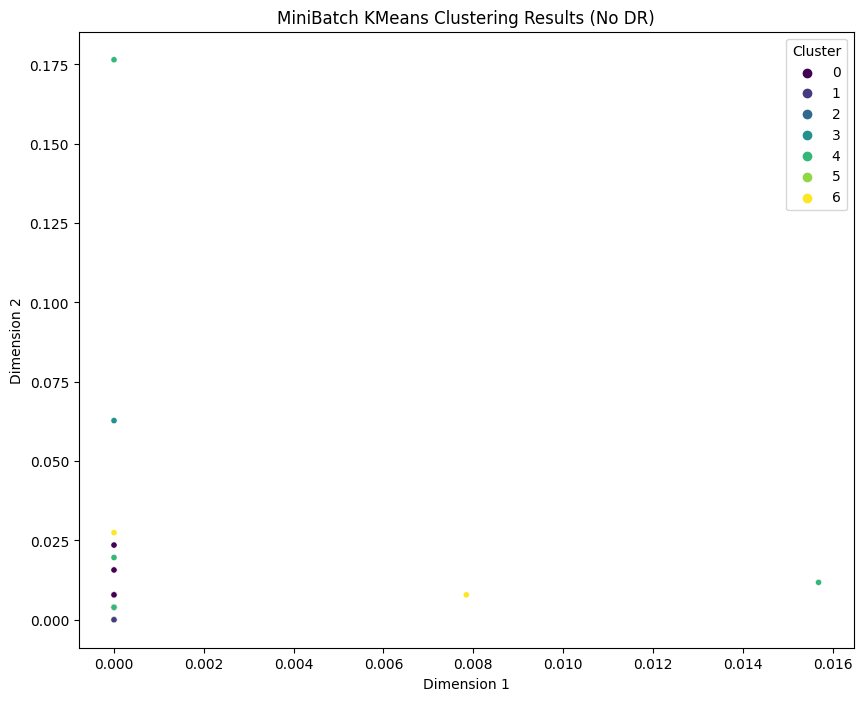

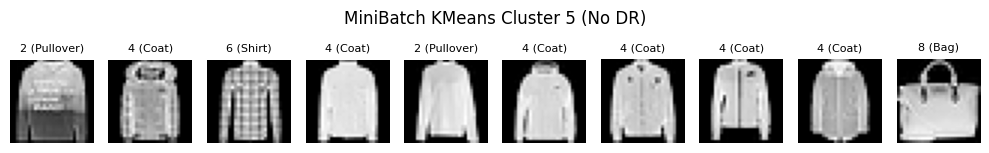

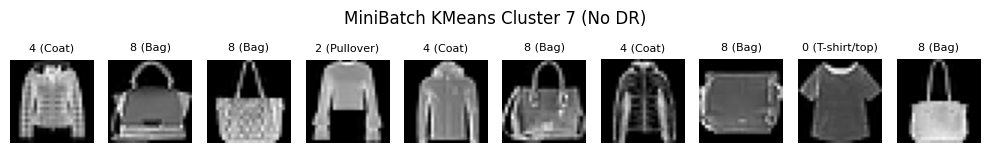

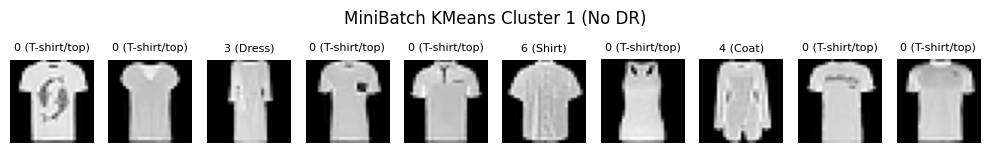

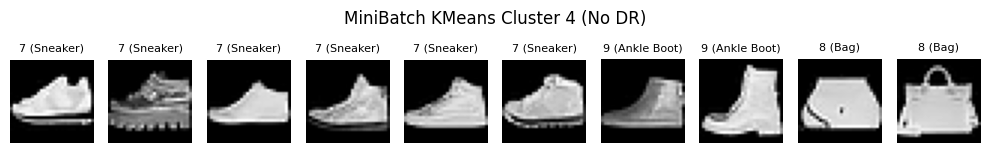

<ipython-input-91-a6092961e32f>:54: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  color_map = plt.cm.get_cmap('tab20', num_labels)
<ipython-input-91-a6092961e32f>:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


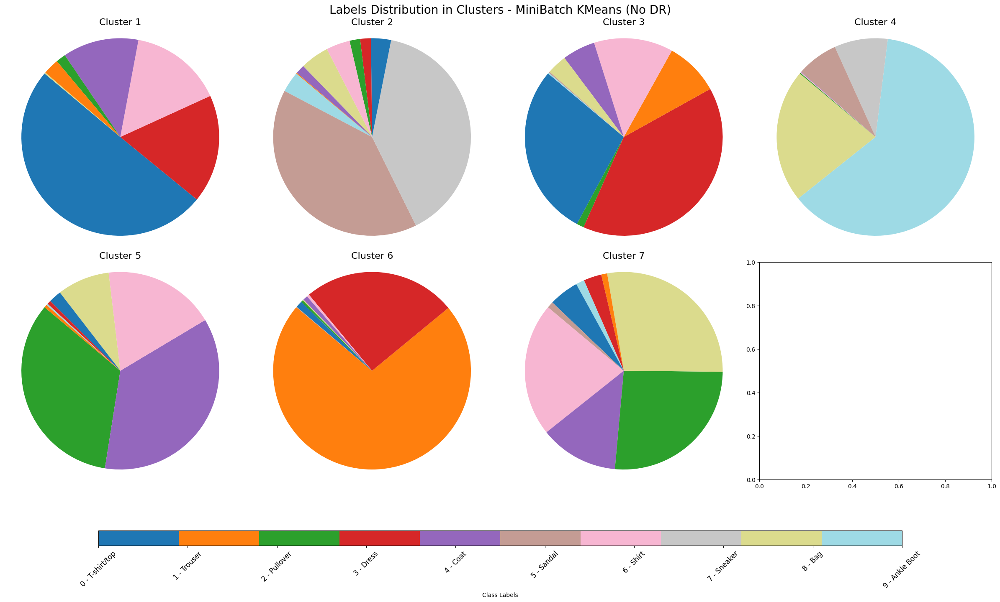

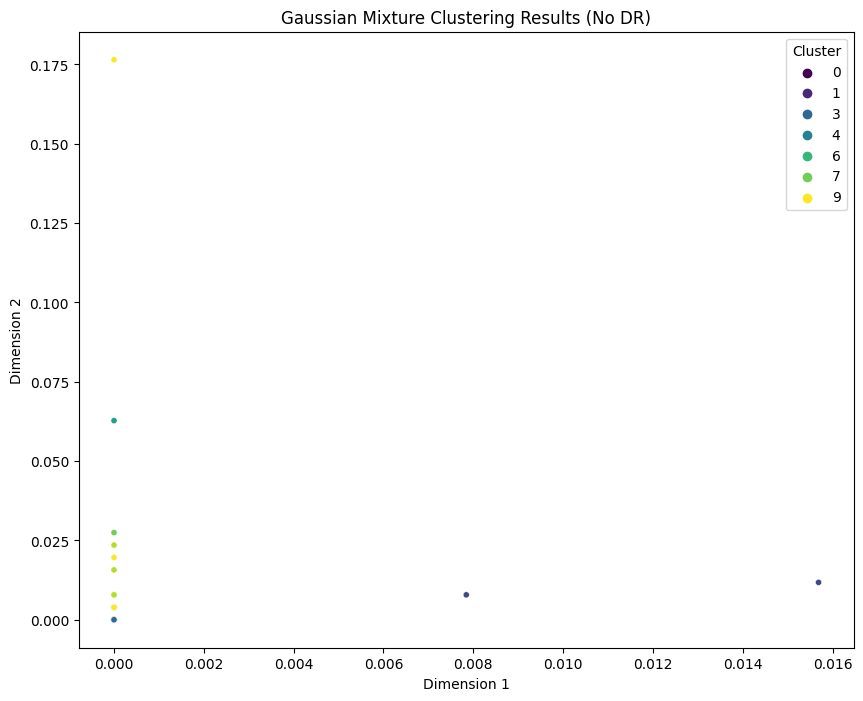

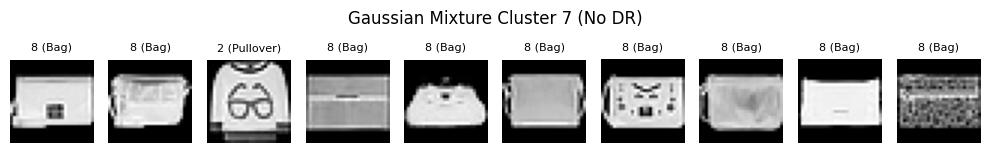

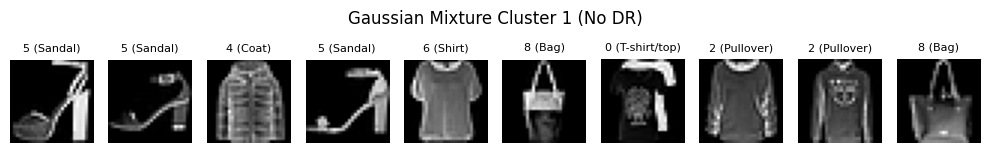

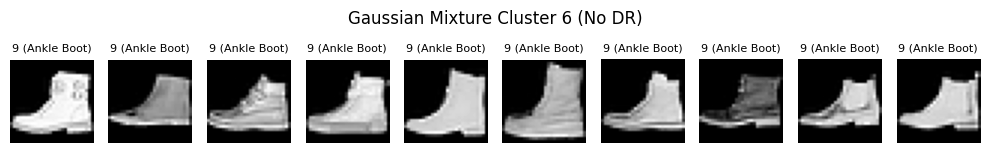

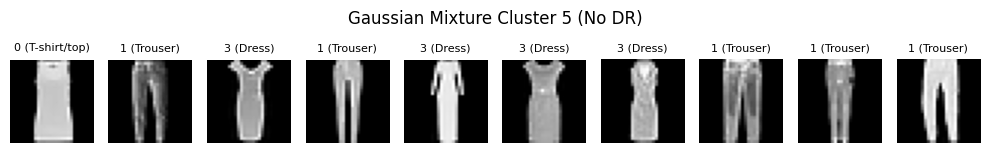

<ipython-input-91-a6092961e32f>:54: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  color_map = plt.cm.get_cmap('tab20', num_labels)
<ipython-input-91-a6092961e32f>:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


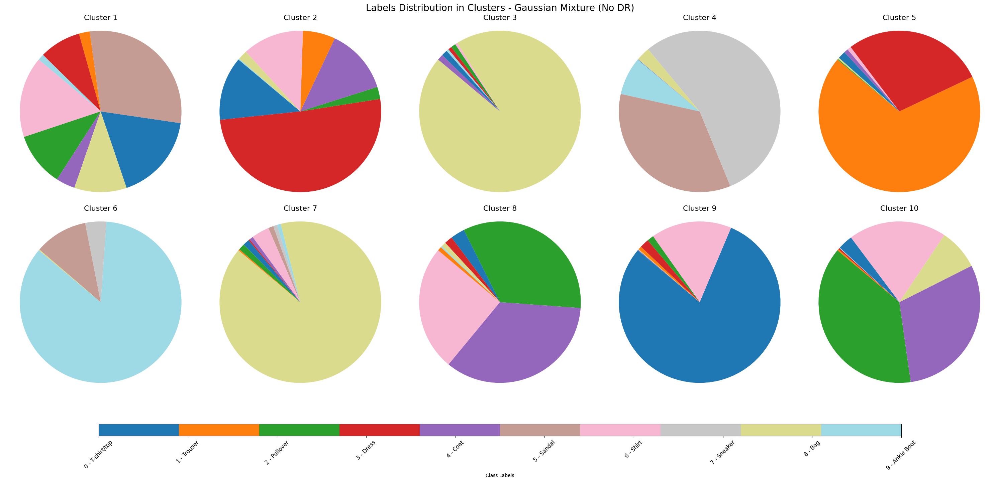

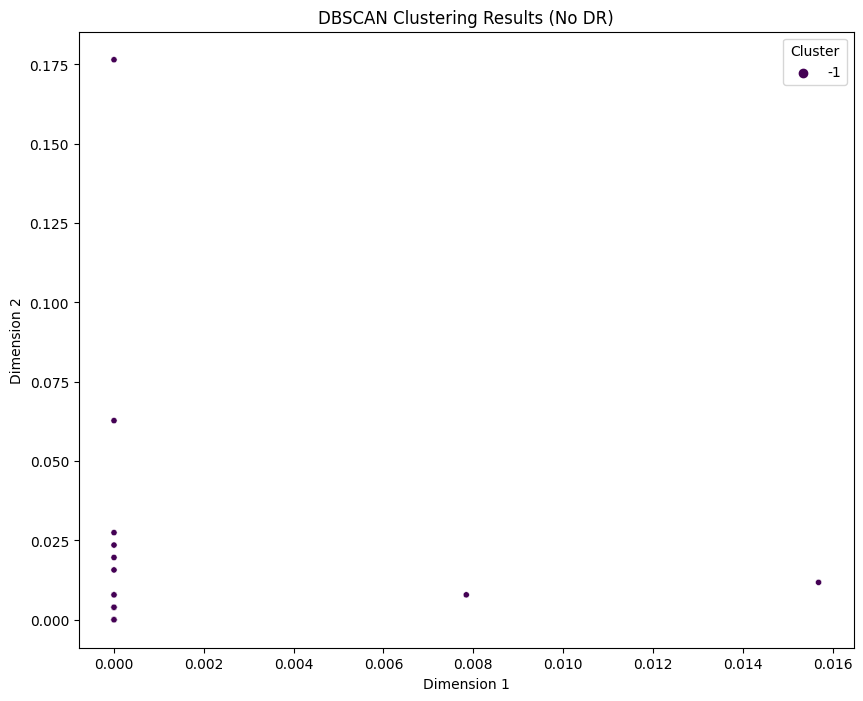

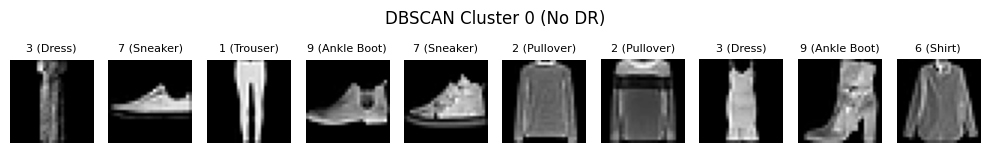

<ipython-input-91-a6092961e32f>:54: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  color_map = plt.cm.get_cmap('tab20', num_labels)
<ipython-input-91-a6092961e32f>:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


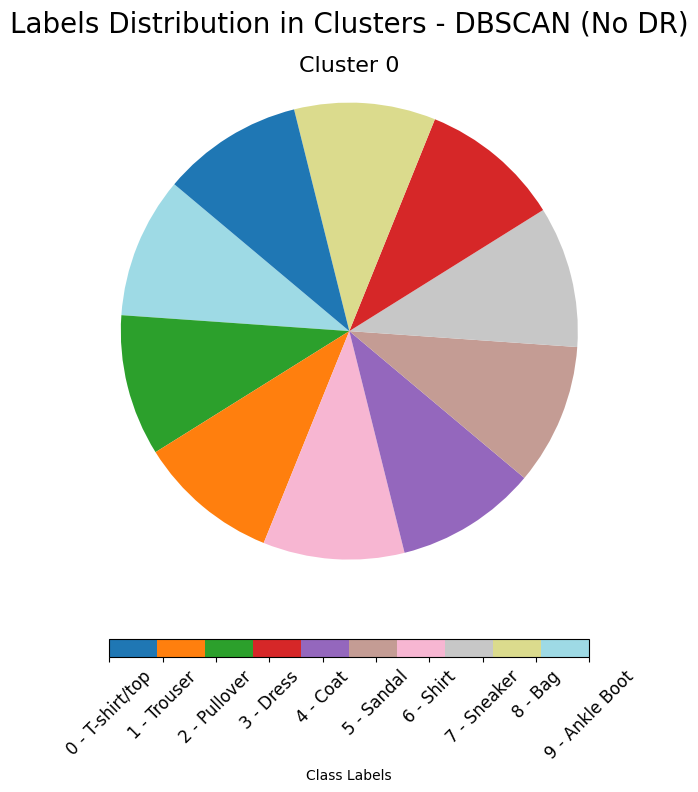

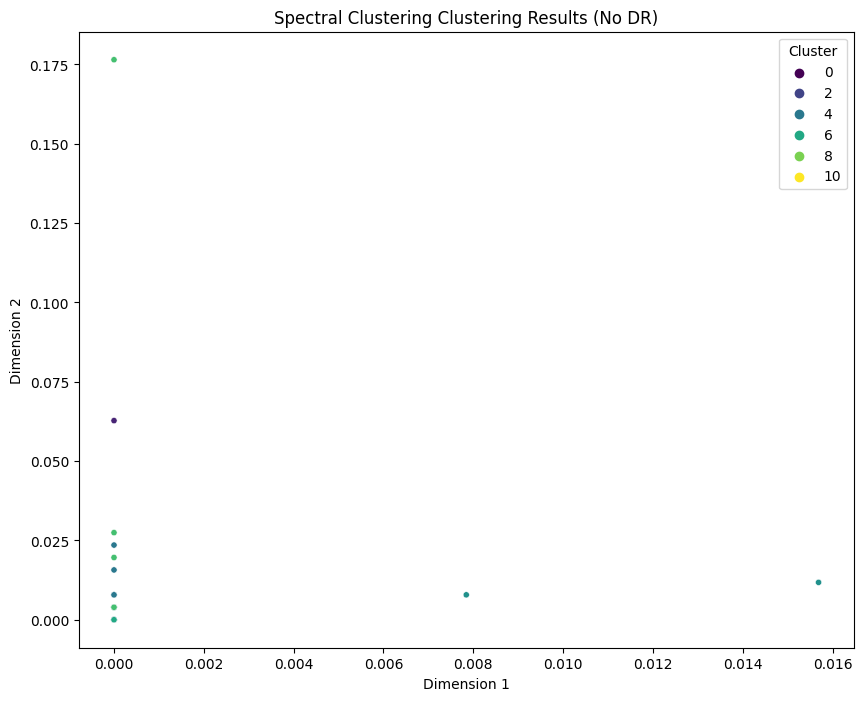

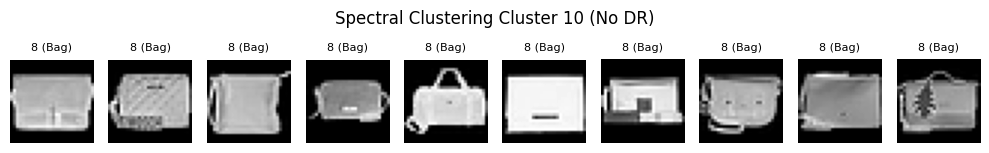

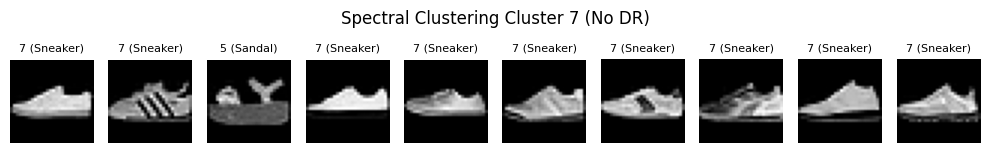

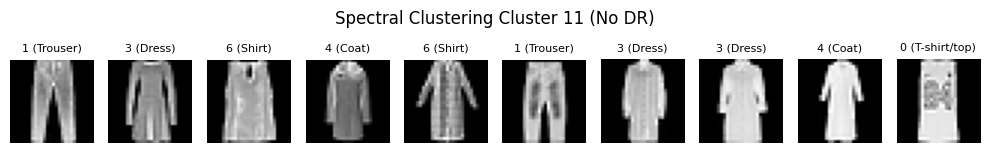

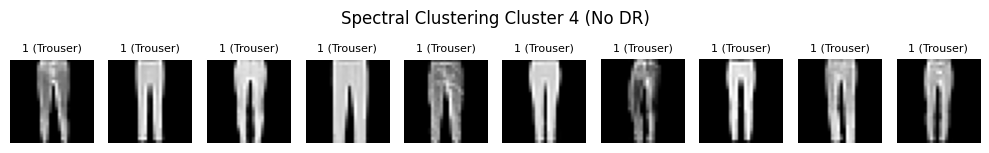

<ipython-input-91-a6092961e32f>:54: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  color_map = plt.cm.get_cmap('tab20', num_labels)
<ipython-input-91-a6092961e32f>:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


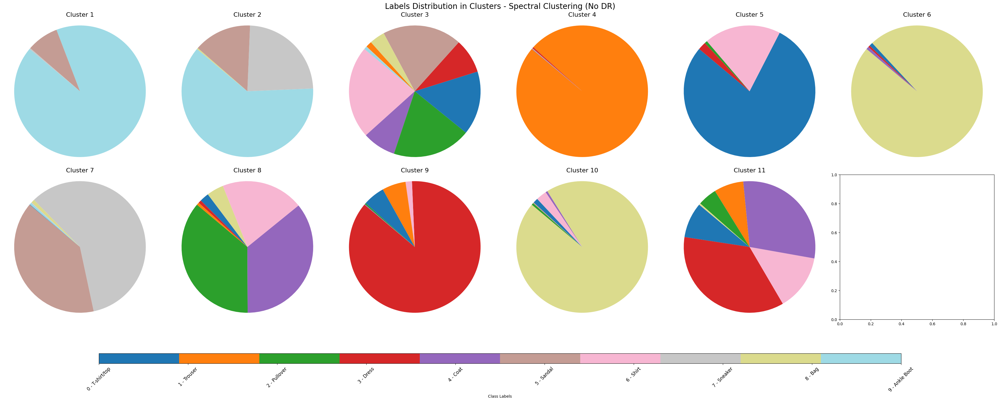

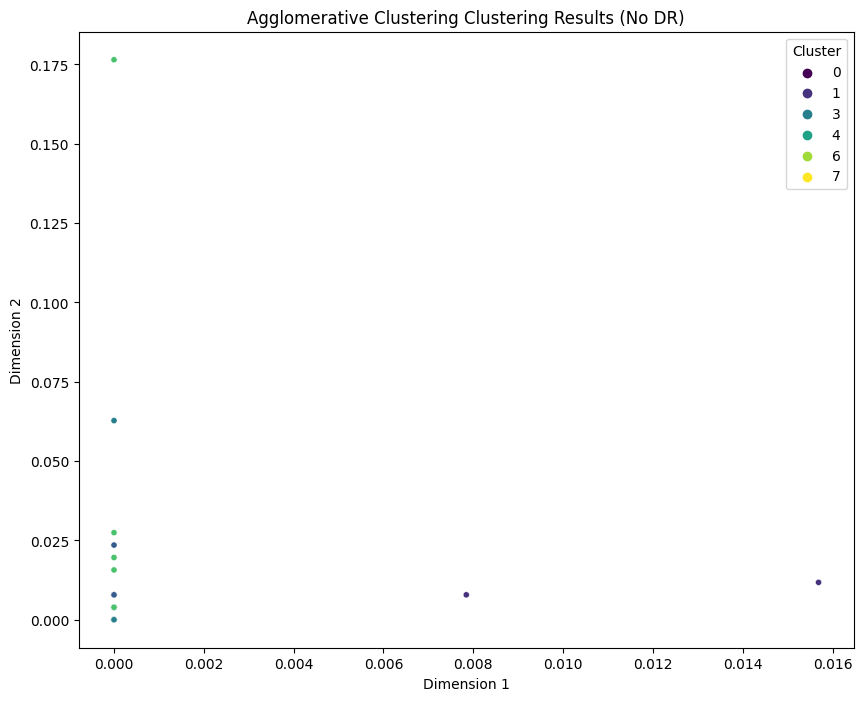

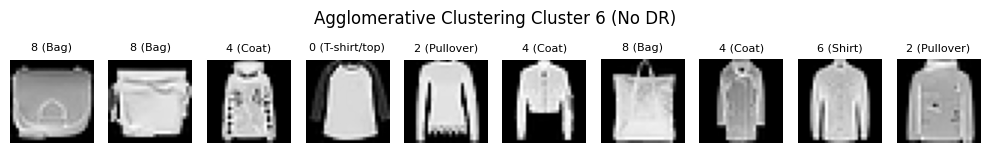

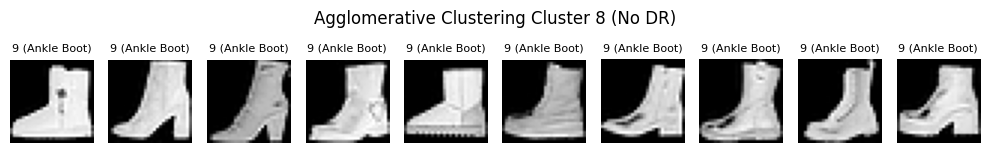

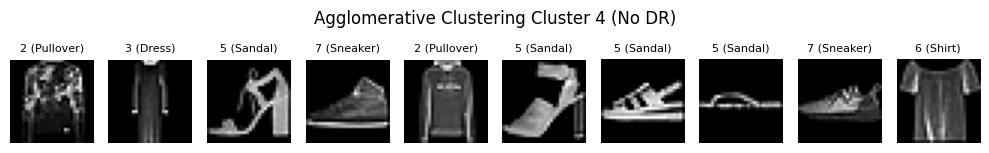

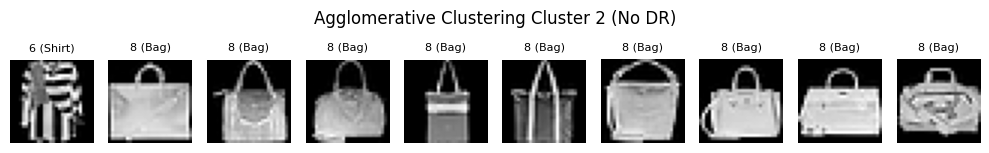

<ipython-input-91-a6092961e32f>:54: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  color_map = plt.cm.get_cmap('tab20', num_labels)
<ipython-input-91-a6092961e32f>:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


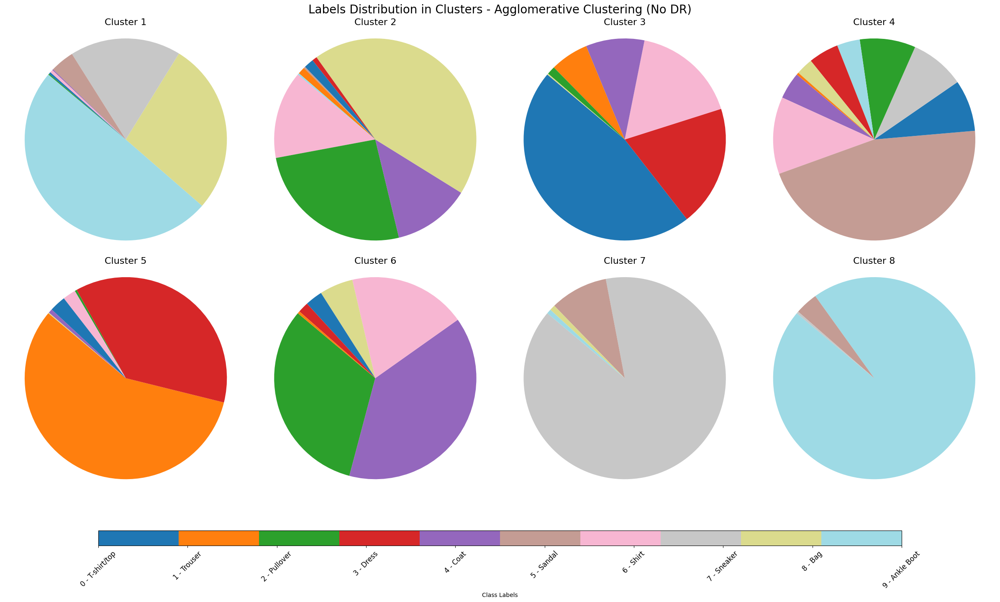

In [ ]:
# @title No DR Technique

# No dr technique
df = clustering_metric_loop(df, x_test, "No DR")

Original Shape:(10000, 784)   Reduced Shape:(10000, 25)


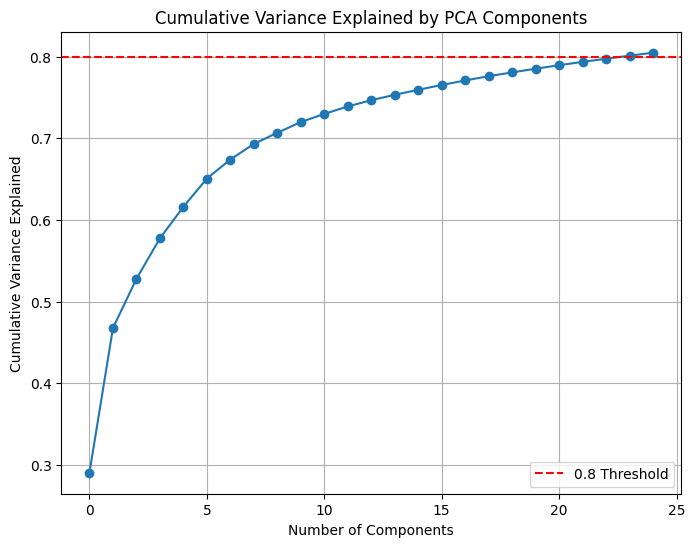

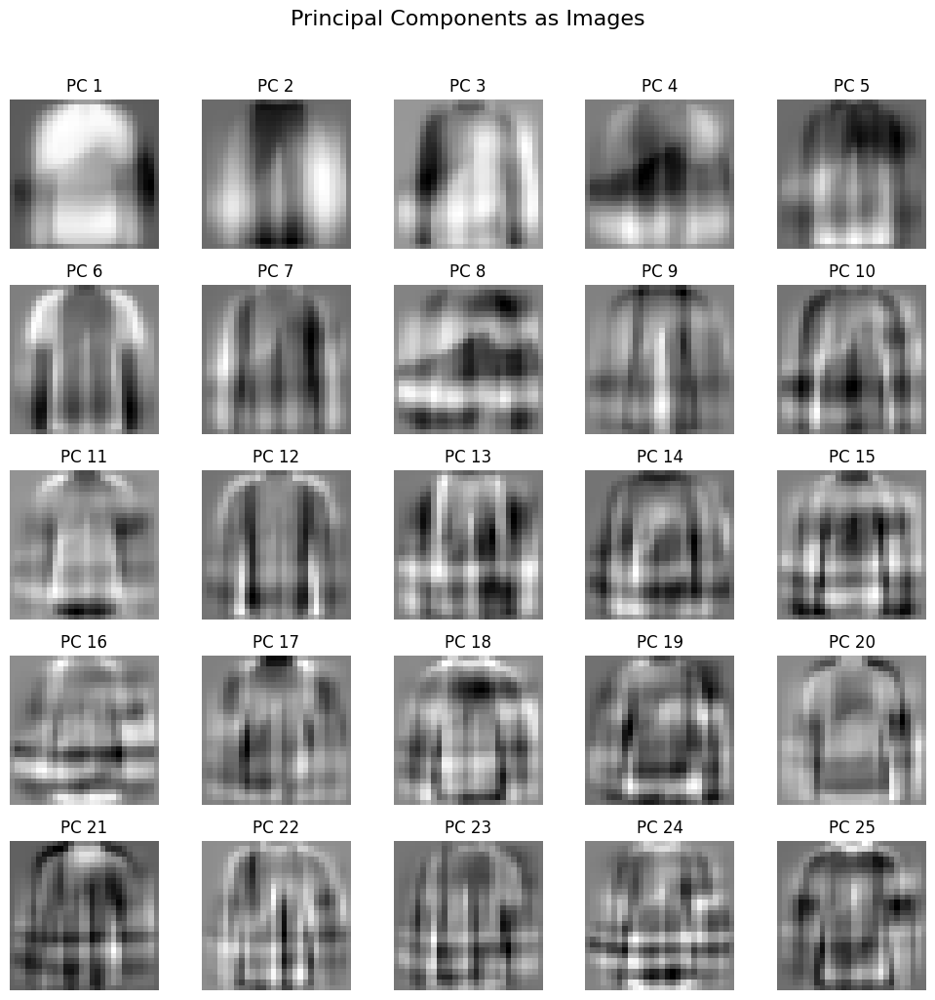

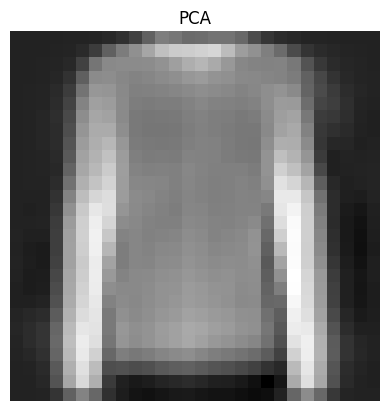

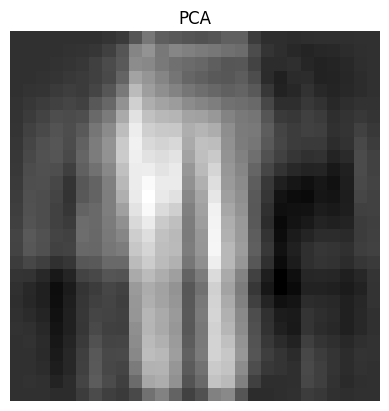

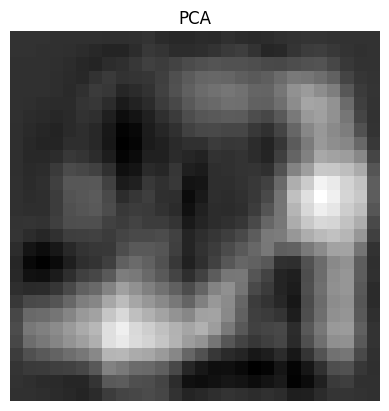

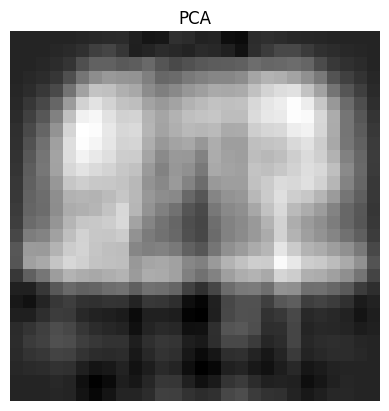

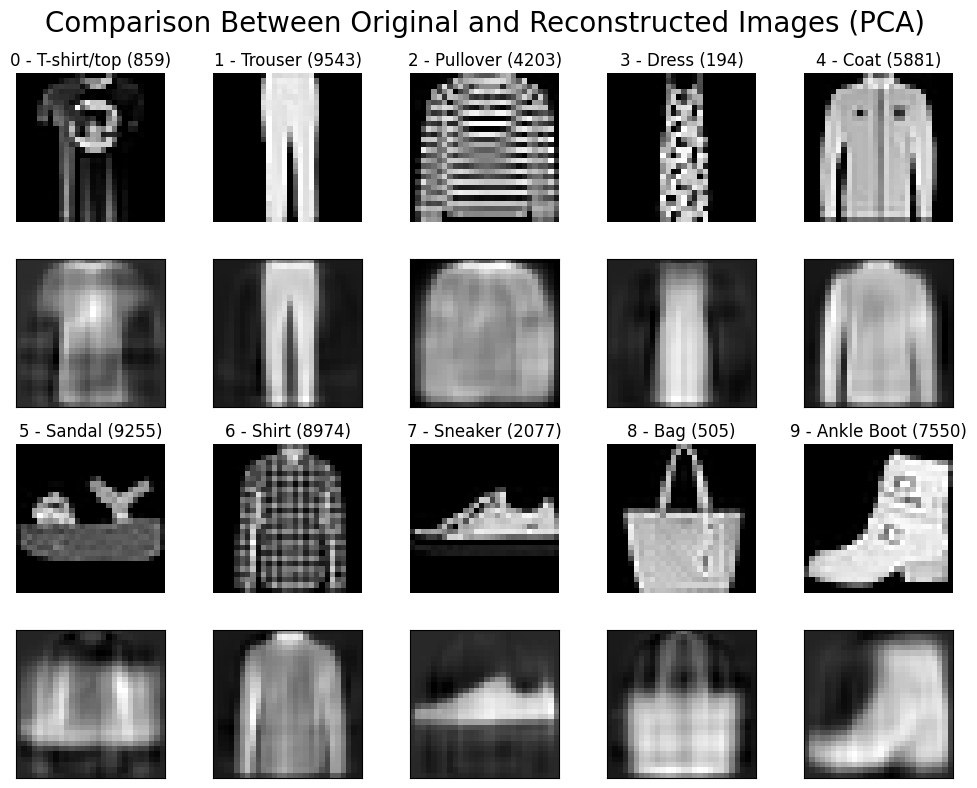

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 3 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


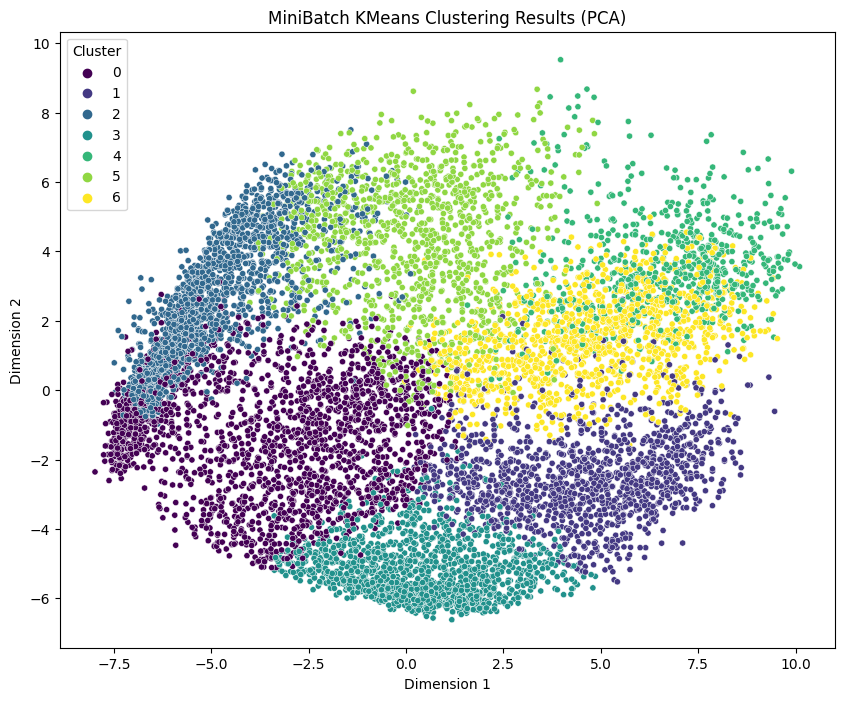

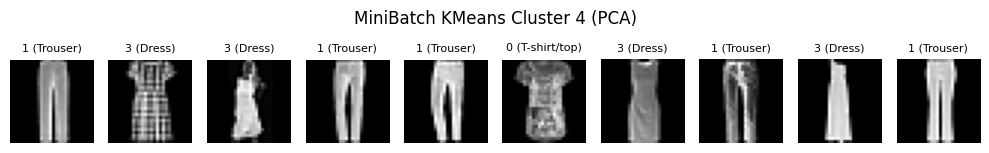

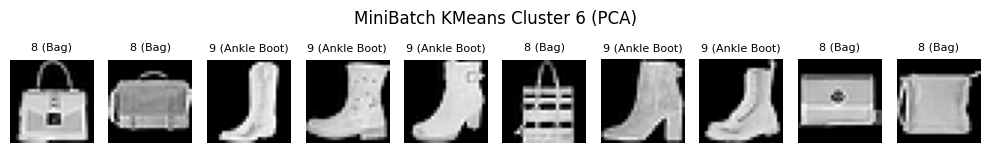

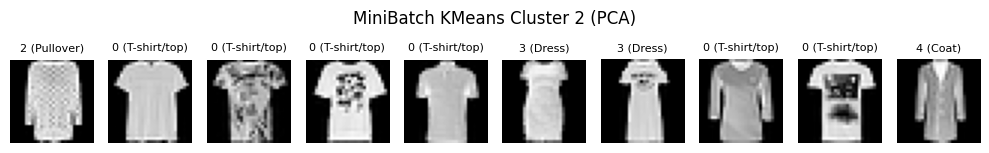

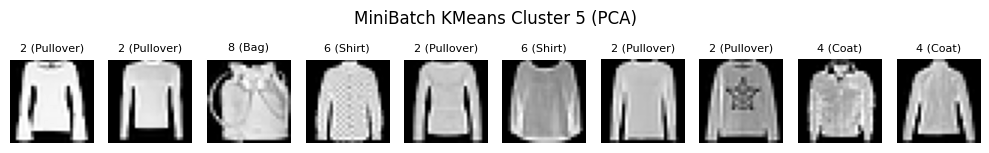

<ipython-input-91-a6092961e32f>:54: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  color_map = plt.cm.get_cmap('tab20', num_labels)
<ipython-input-91-a6092961e32f>:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


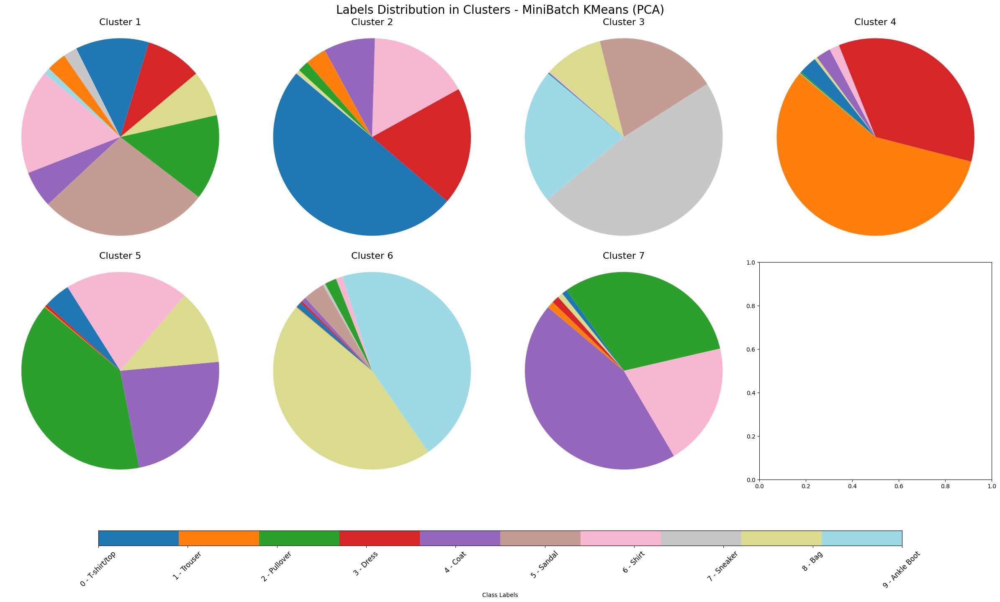

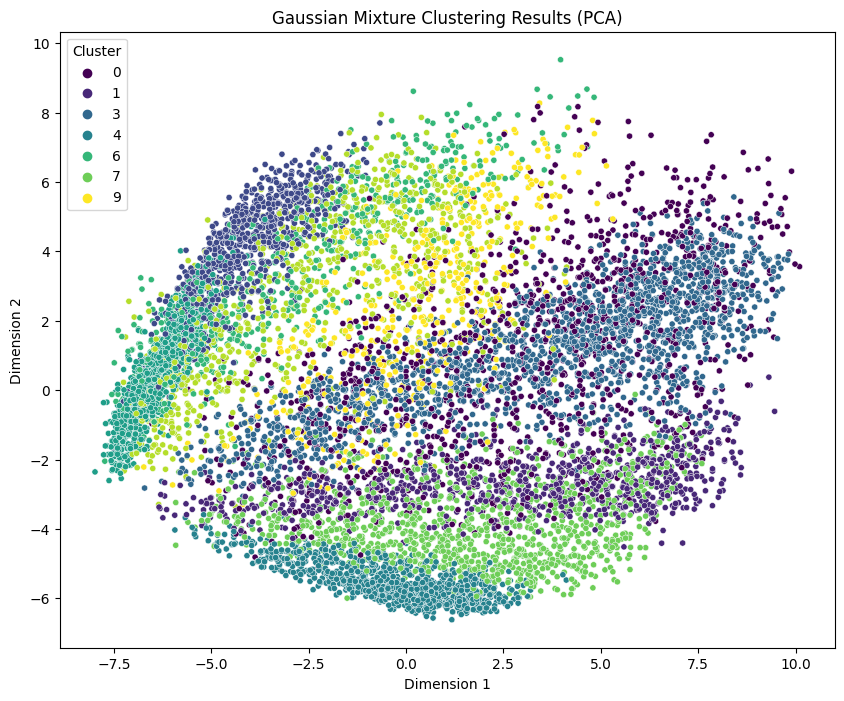

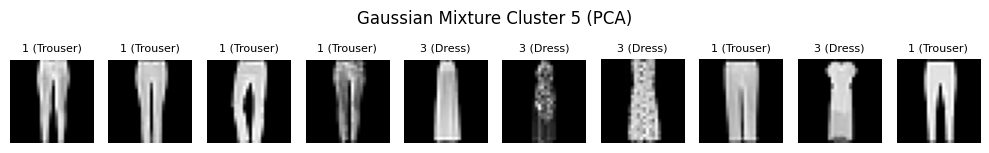

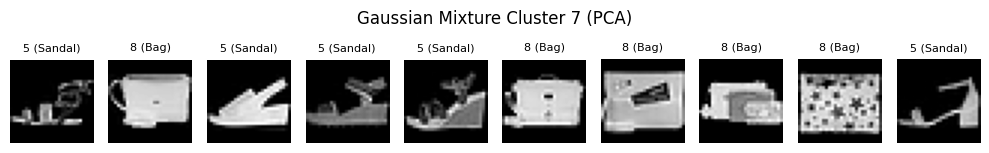

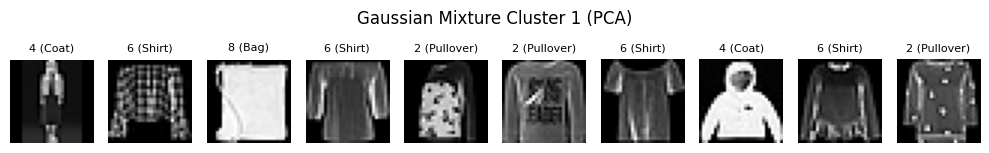

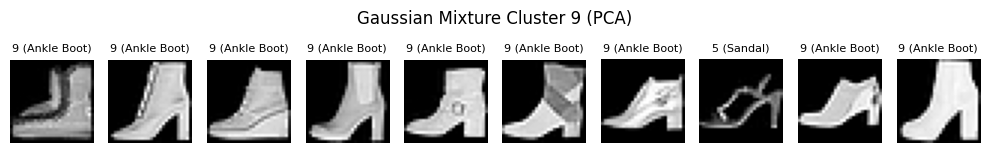

<ipython-input-91-a6092961e32f>:54: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  color_map = plt.cm.get_cmap('tab20', num_labels)
<ipython-input-91-a6092961e32f>:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


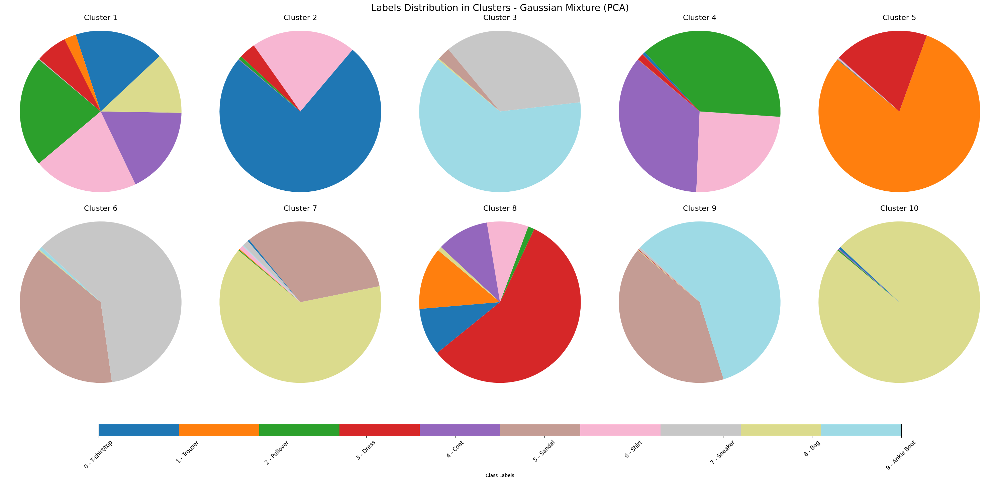

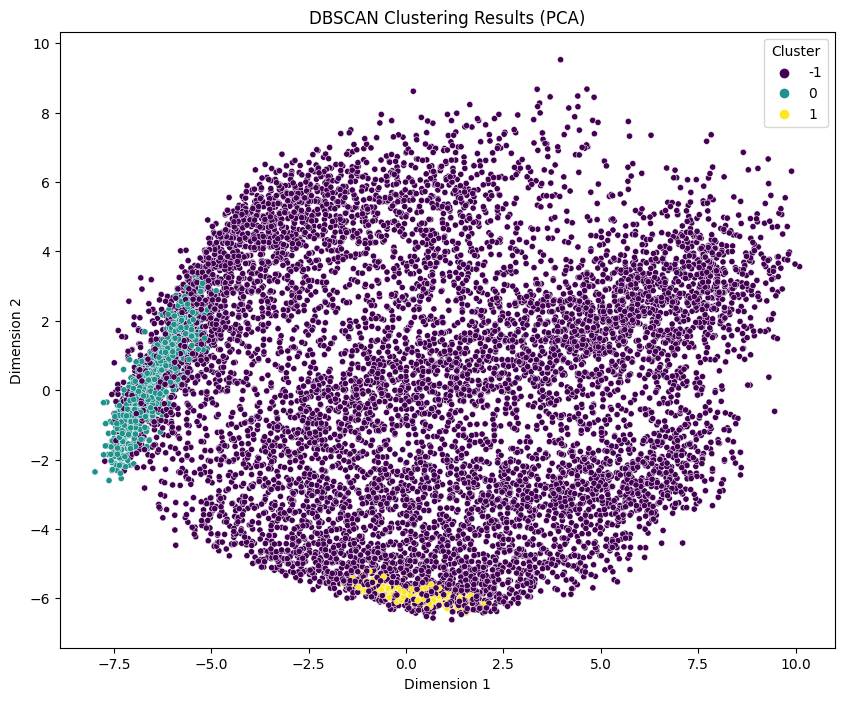

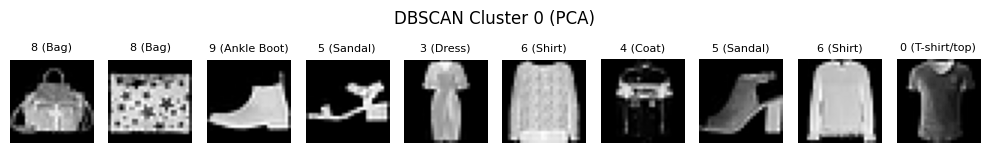

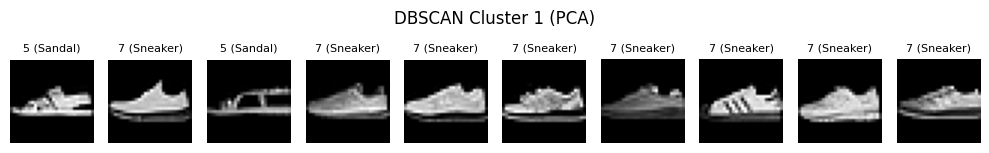

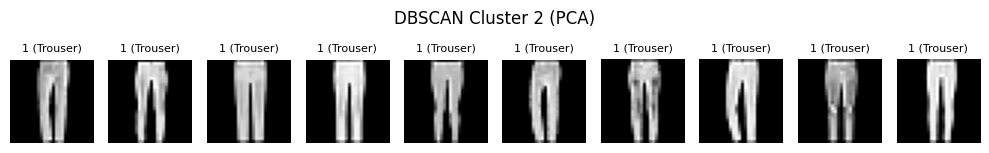

<ipython-input-91-a6092961e32f>:54: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  color_map = plt.cm.get_cmap('tab20', num_labels)
<ipython-input-91-a6092961e32f>:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


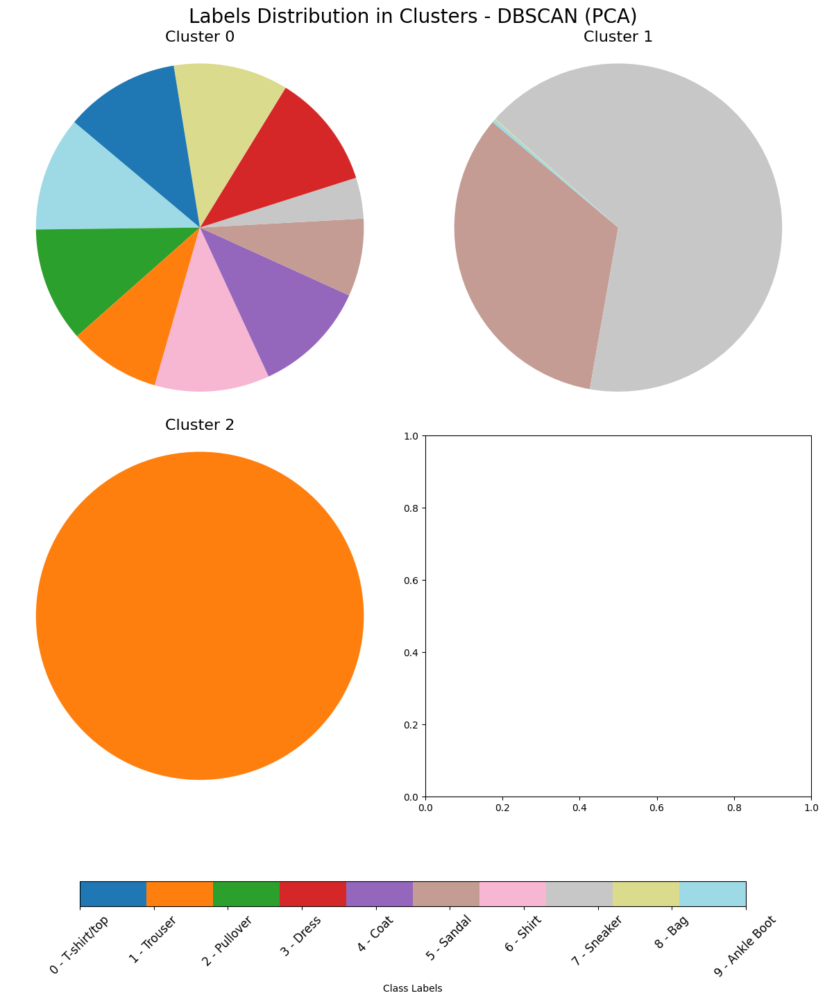

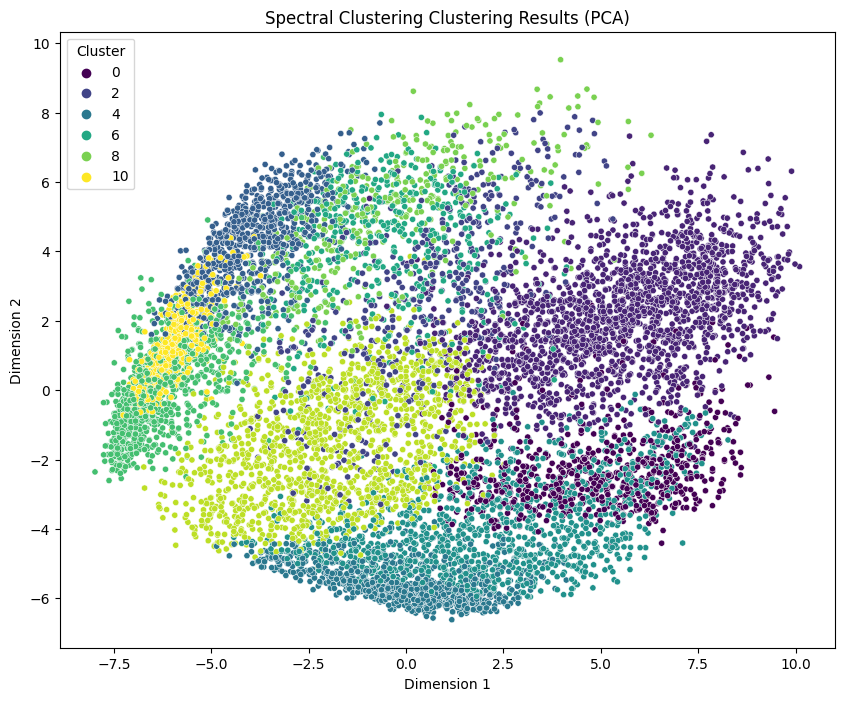

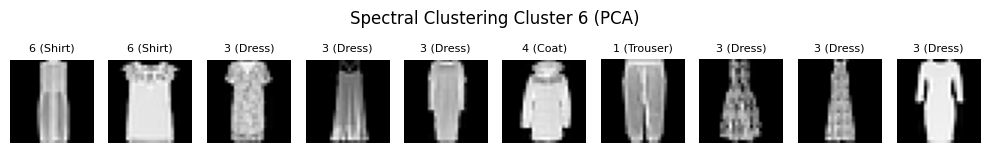

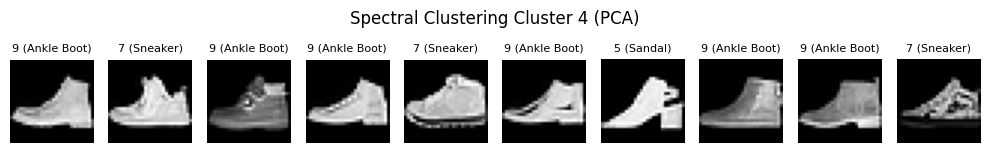

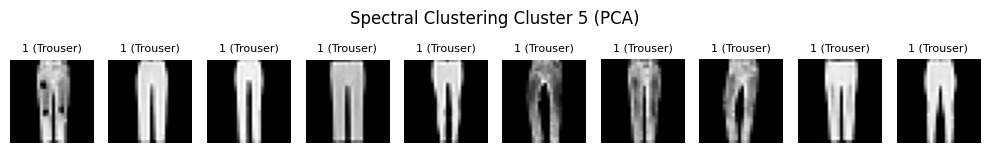

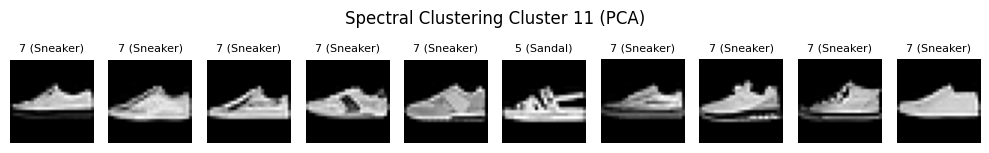

<ipython-input-91-a6092961e32f>:54: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  color_map = plt.cm.get_cmap('tab20', num_labels)
<ipython-input-91-a6092961e32f>:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


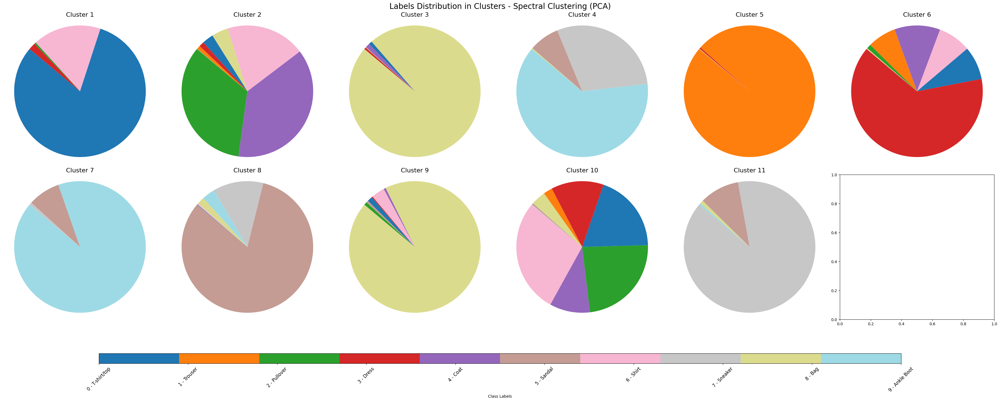

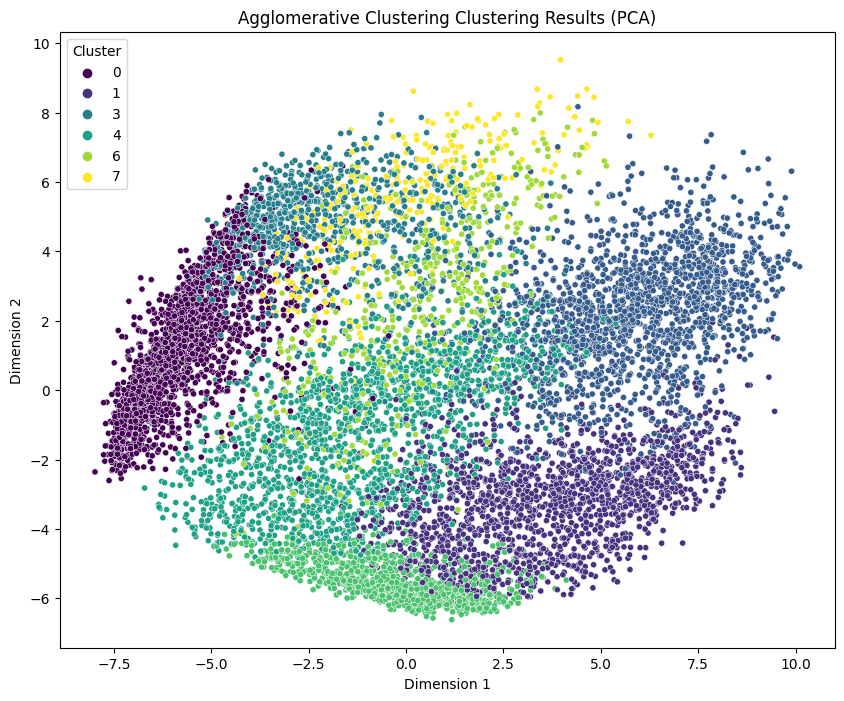

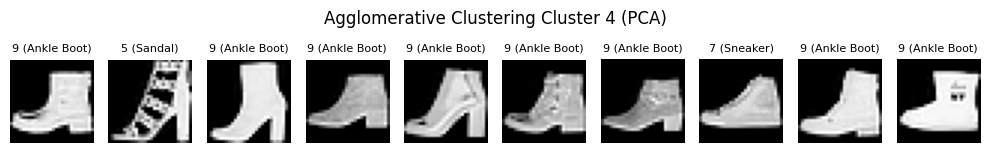

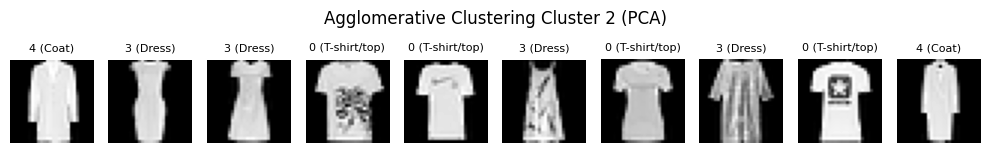

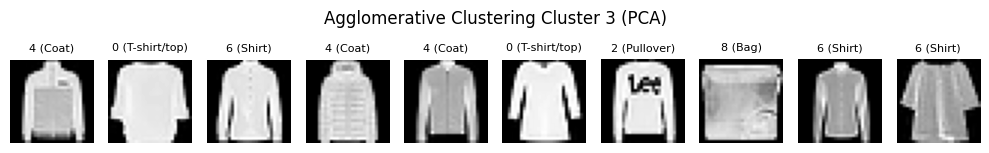

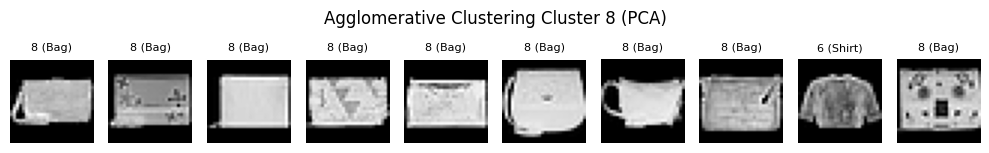

<ipython-input-91-a6092961e32f>:54: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  color_map = plt.cm.get_cmap('tab20', num_labels)
<ipython-input-91-a6092961e32f>:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


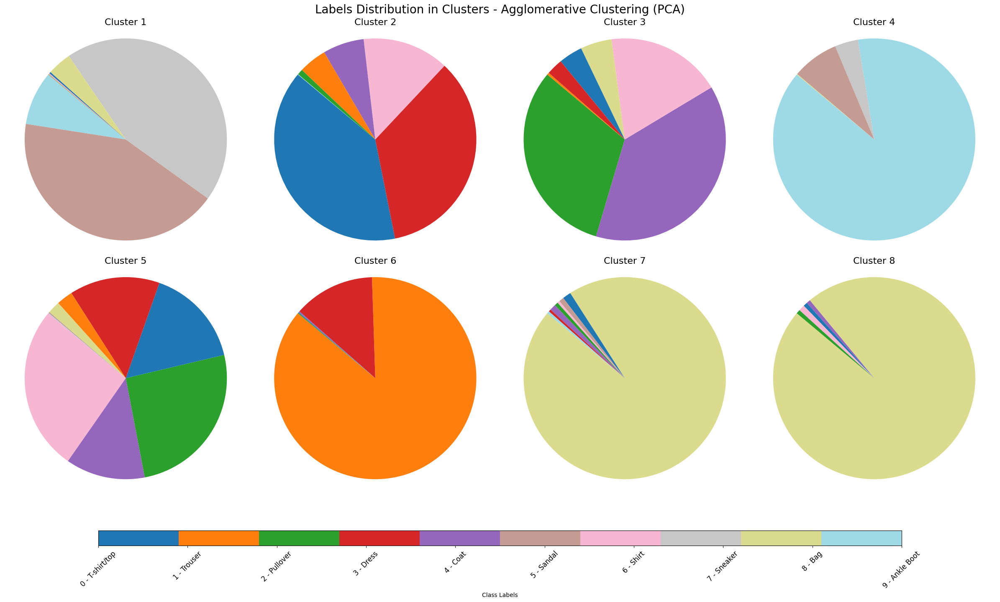

In [ ]:
# @title PCA
from sklearn.decomposition import PCA

name = "PCA"

def plot_pca_components_as_images(pca_model, n_cols=5, img_shape=(28, 28)):
    n_components = min(pca_model.n_components_, 25)  # Limiting to 25 components for better visualization
    n_rows = (n_components - 1) // n_cols + 1

    plt.figure(figsize=(2 * n_cols, 2 * n_rows))
    for i in range(n_components):
        plt.subplot(n_rows, n_cols, i + 1)
        plt.imshow(pca_model.components_[i].reshape(img_shape), cmap='gray')
        plt.title(f'PC {i + 1}')
        plt.axis('off')

    plt.suptitle('Principal Components as Images', y=1.02, fontsize=16)
    plt.tight_layout()
    plt.show()

def plot_cumulative_variance(pca, variance_threshold=0.8):
    cumulative_variance = np.cumsum(pca.explained_variance_ratio_)

    plt.figure(figsize=(8, 6))
    plt.plot(cumulative_variance, marker='o', linestyle='-')
    plt.axhline(y=variance_threshold, color='r', linestyle='--', label=f'{variance_threshold} Threshold')
    plt.xlabel('Number of Components')
    plt.ylabel('Cumulative Variance Explained')
    plt.title('Cumulative Variance Explained by PCA Components')
    plt.legend()
    plt.grid(True)
    plt.show()

pca = PCA(n_components=25)
# fit and training time
start_time = time.time()
x_test_reduced = pca.fit(x_train).transform(x_test)
end_time = time.time()

# reconstruct
print(f"Original Shape:{x_test.shape}   Reduced Shape:{x_test_reduced.shape}")
reconstructed = pca.inverse_transform(x_test_reduced)

# Plots
plot_cumulative_variance(pca)
plot_pca_components_as_images(pca)
display_case_studies(reconstructed, name)
compare_images_plot(x_test, reconstructed, y_test, name)

data['Dimensionality Reduction Technique'] = name
data['Training Time'] = end_time - start_time

df = clustering_metric_loop(df, x_test_reduced, name)

Original Shape:(10000, 784)   Reduced Shape:(10000, 2)


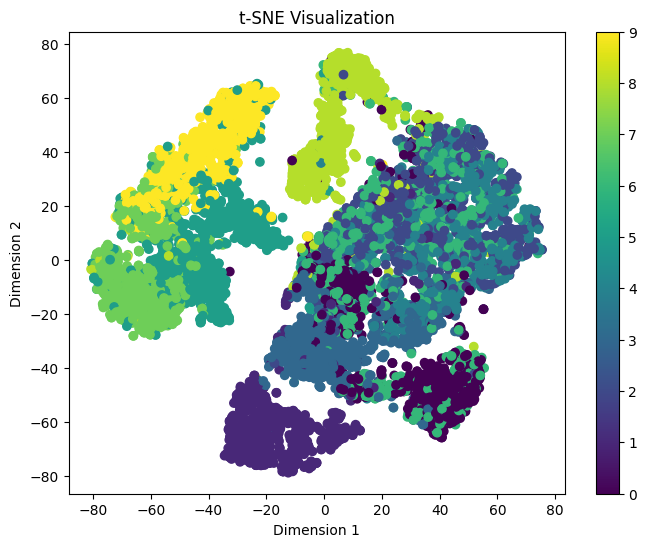

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 3 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


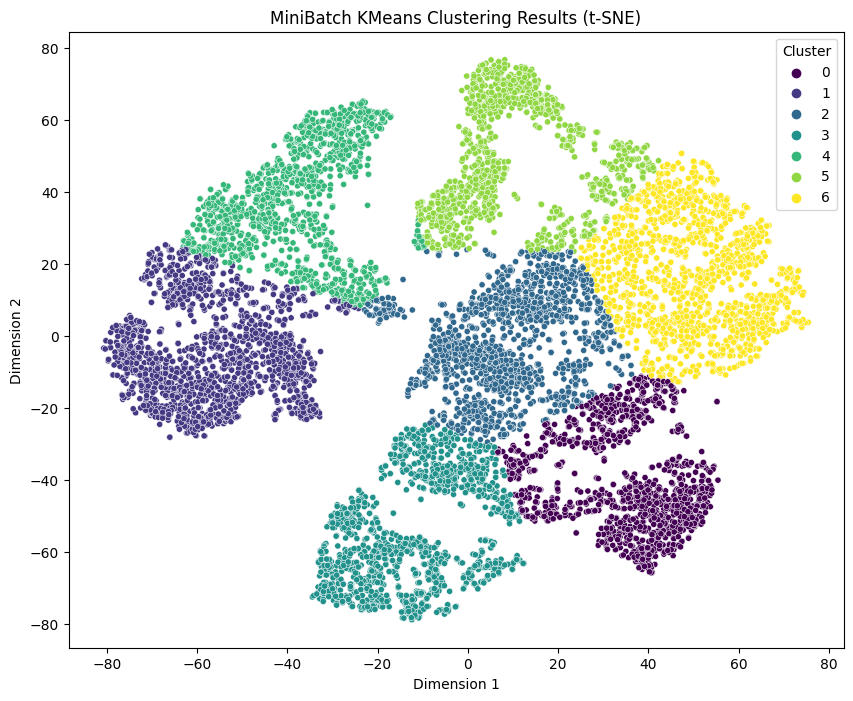

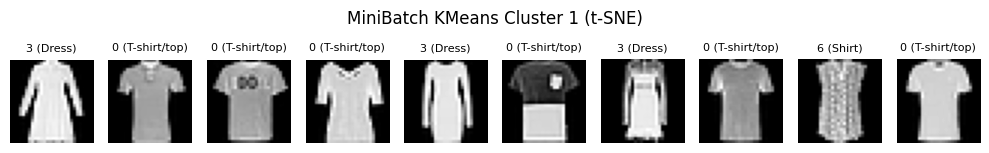

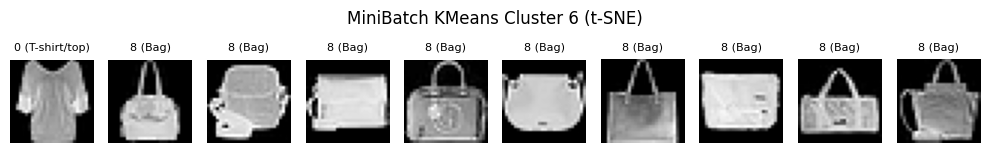

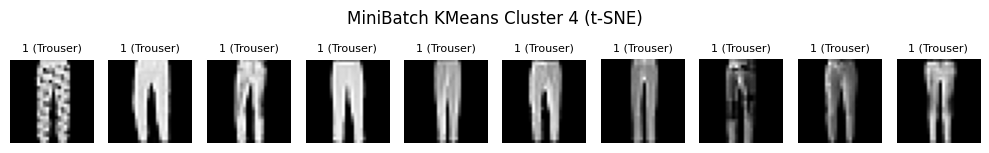

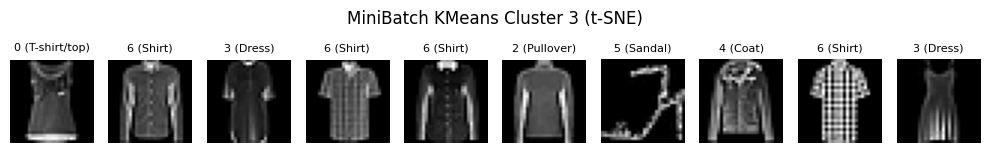

<ipython-input-91-a6092961e32f>:54: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  color_map = plt.cm.get_cmap('tab20', num_labels)
<ipython-input-91-a6092961e32f>:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


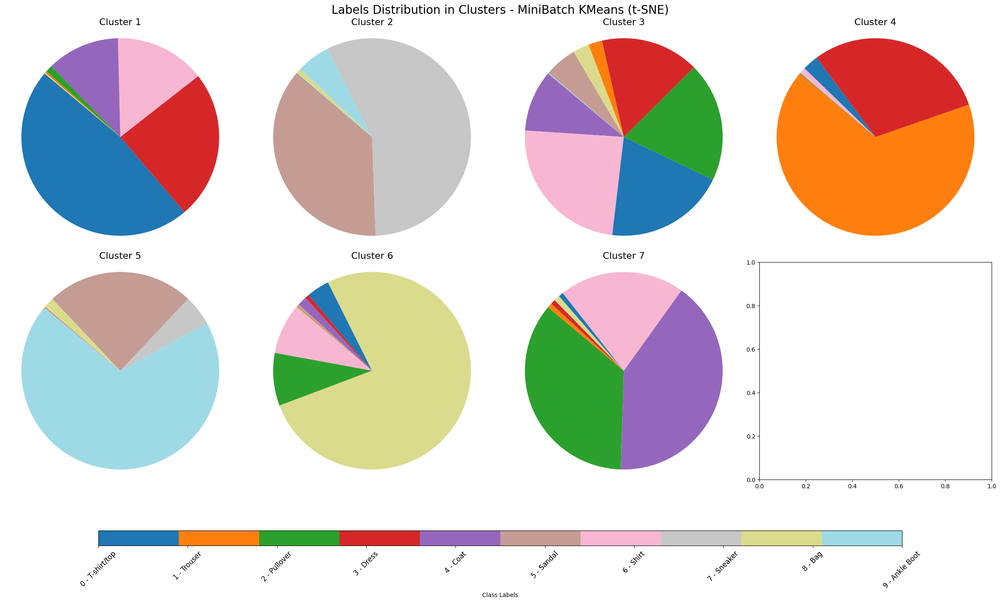

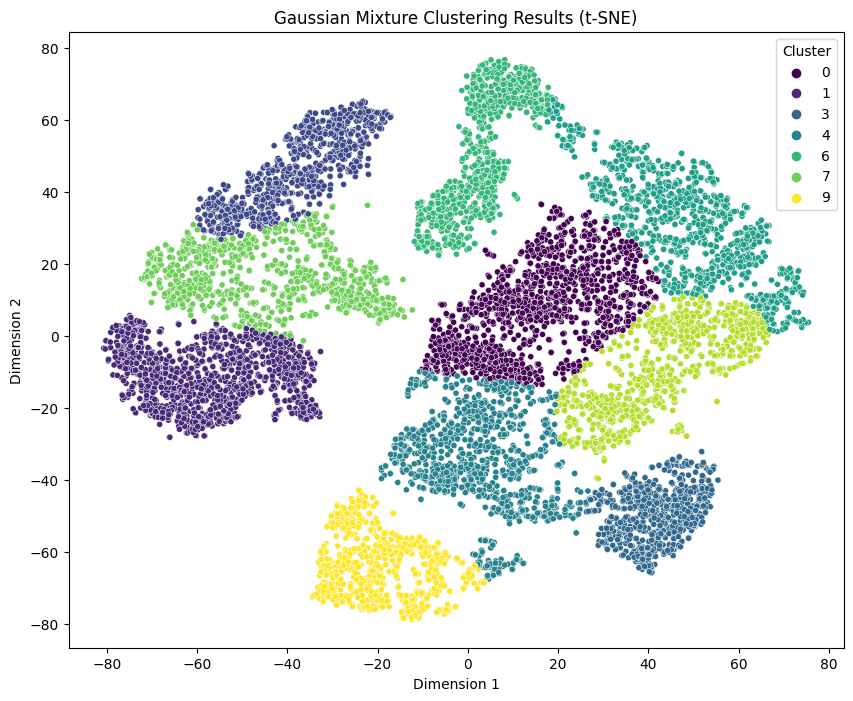

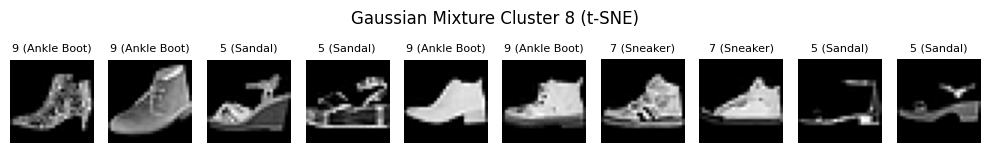

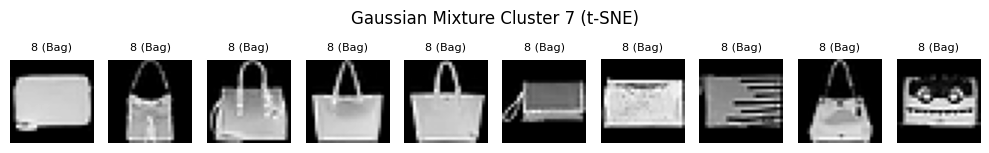

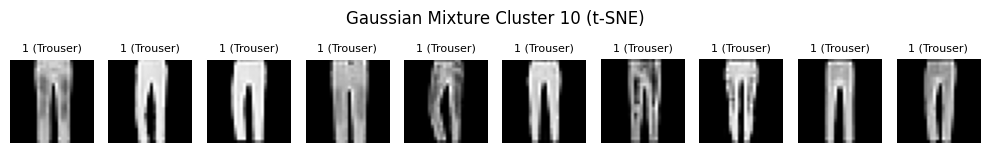

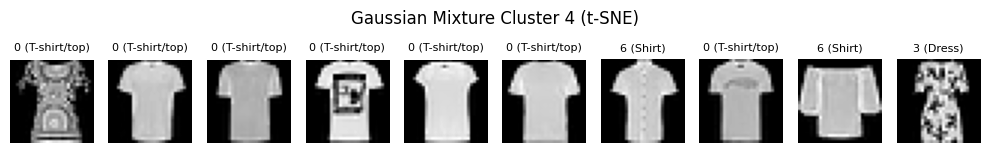

<ipython-input-91-a6092961e32f>:54: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  color_map = plt.cm.get_cmap('tab20', num_labels)
<ipython-input-91-a6092961e32f>:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


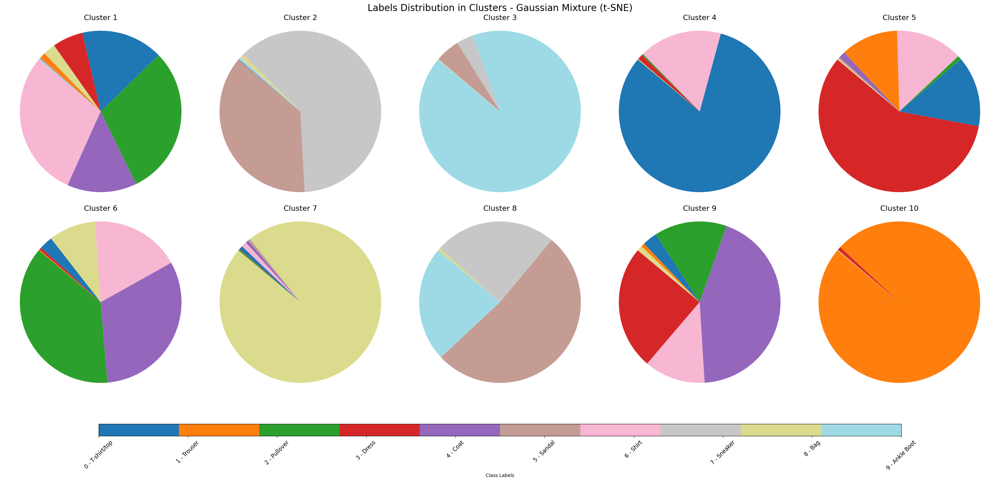

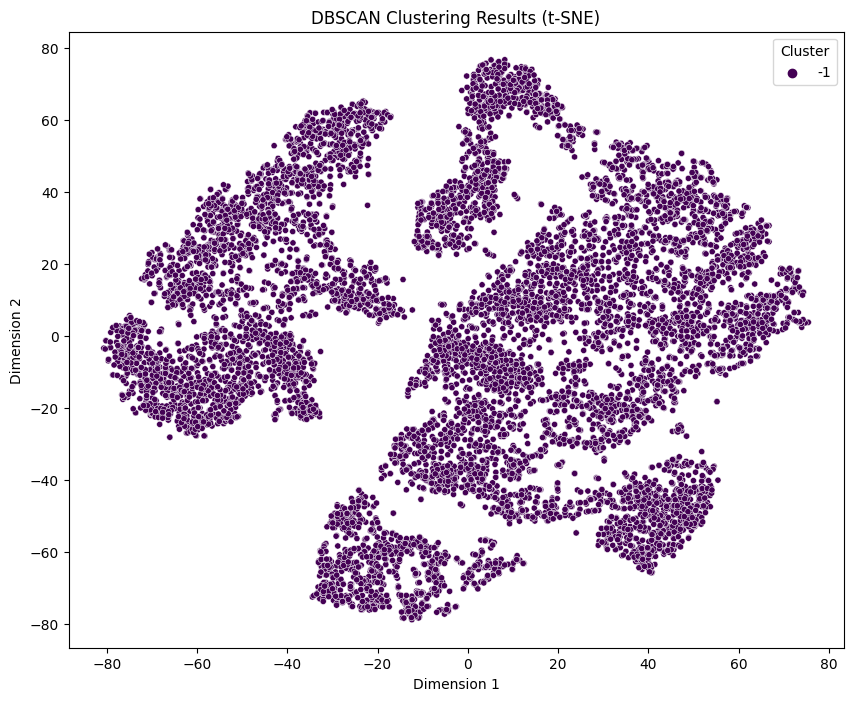

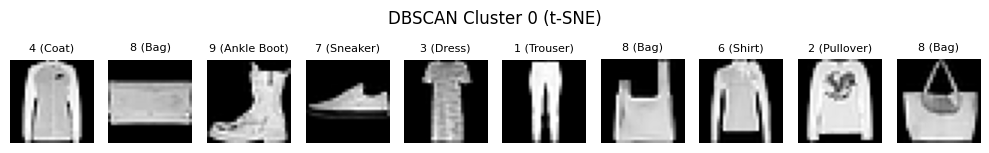

<ipython-input-91-a6092961e32f>:54: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  color_map = plt.cm.get_cmap('tab20', num_labels)
<ipython-input-91-a6092961e32f>:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


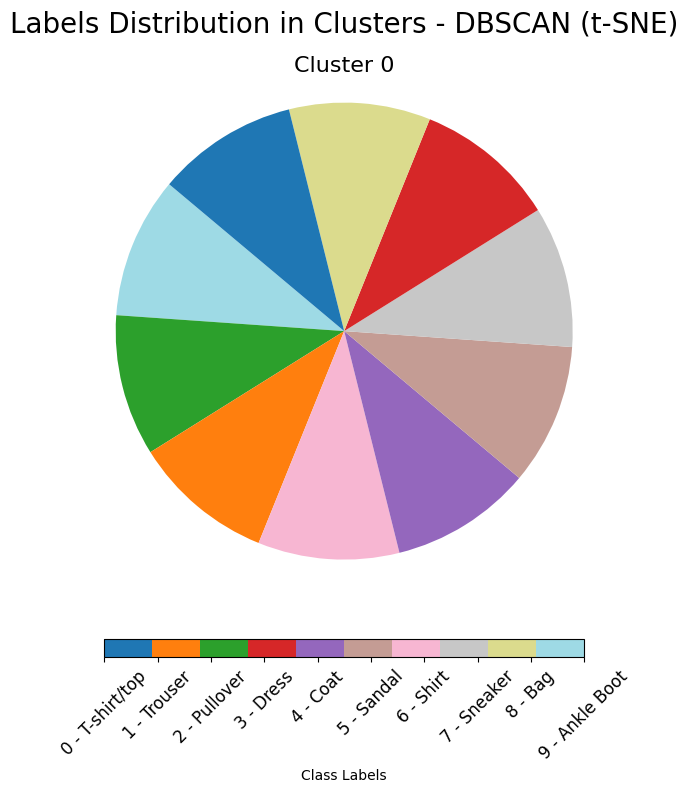

/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_spectral_embedding.py:274: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(


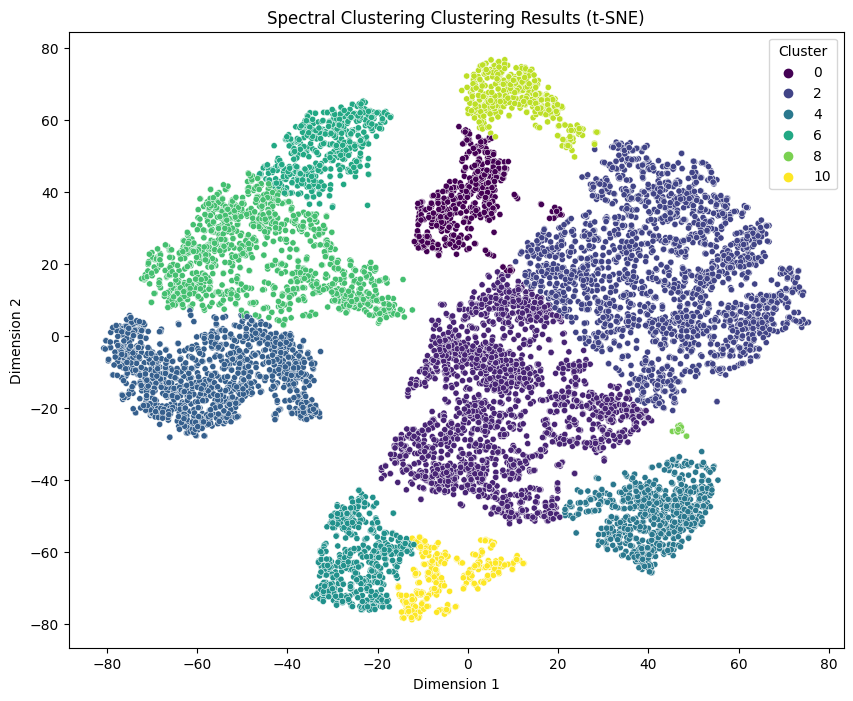

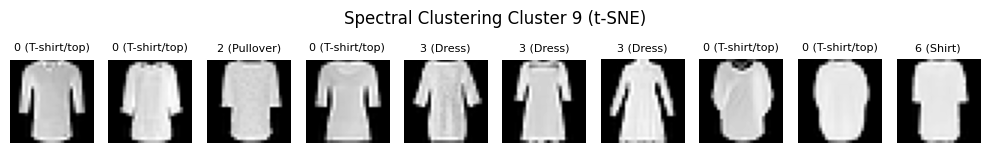

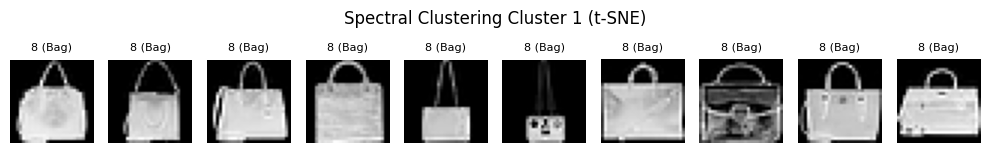

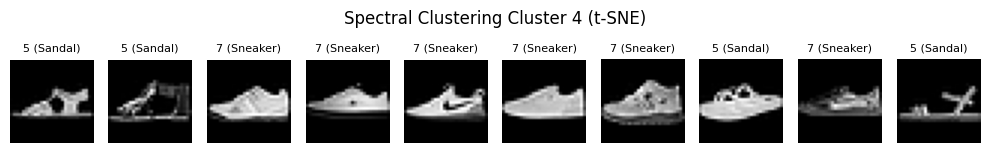

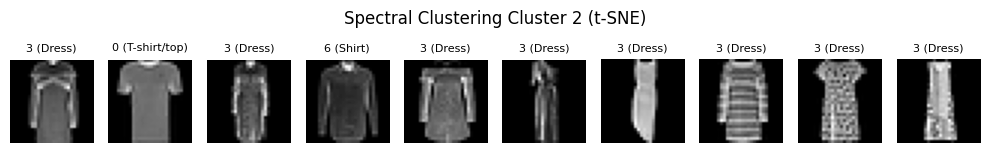

<ipython-input-91-a6092961e32f>:54: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  color_map = plt.cm.get_cmap('tab20', num_labels)
<ipython-input-91-a6092961e32f>:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


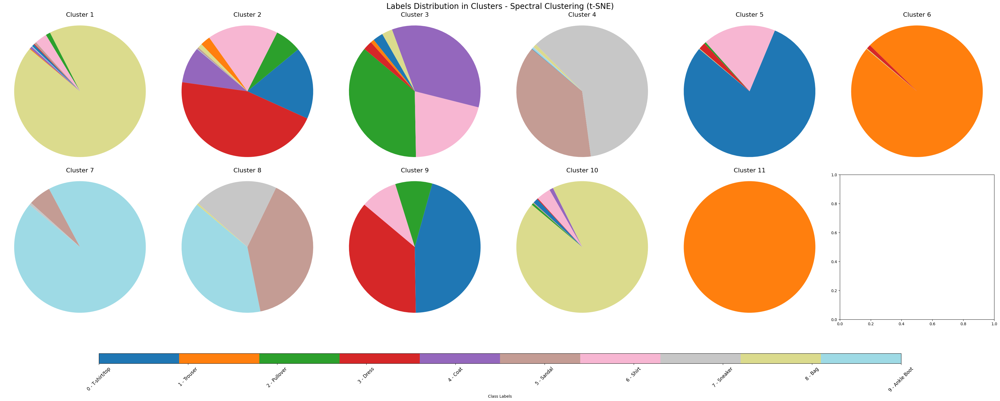

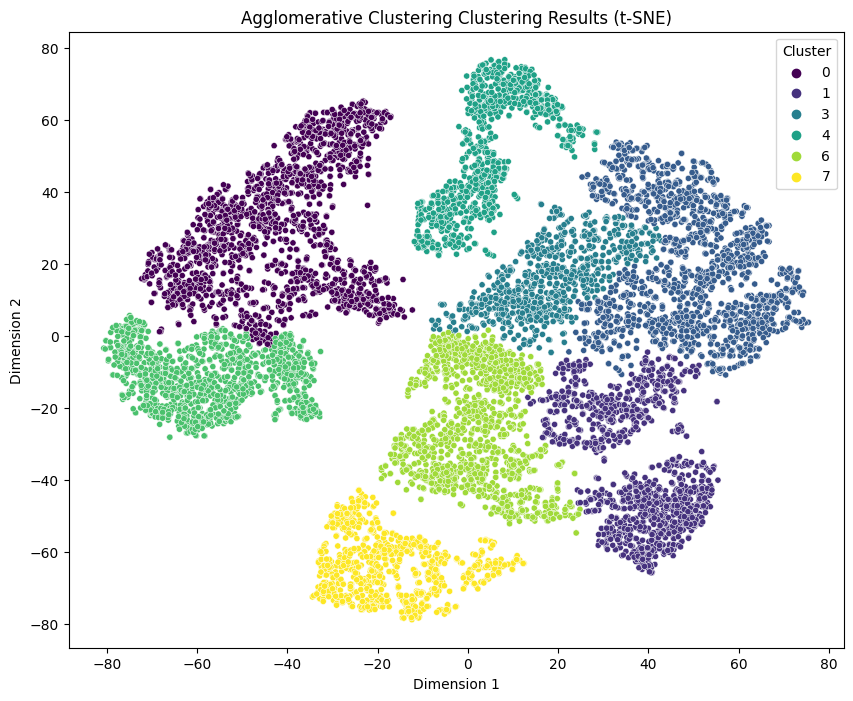

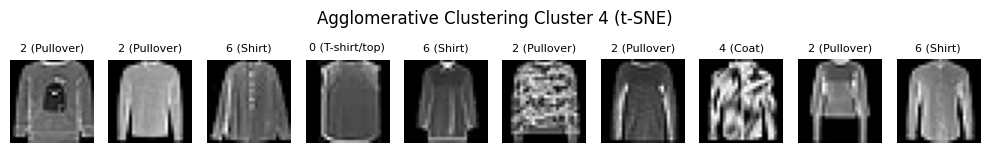

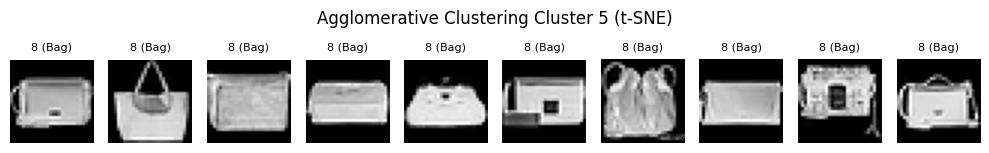

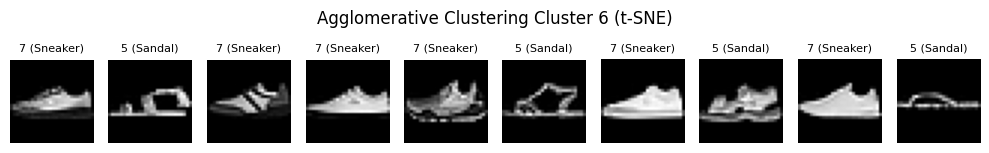

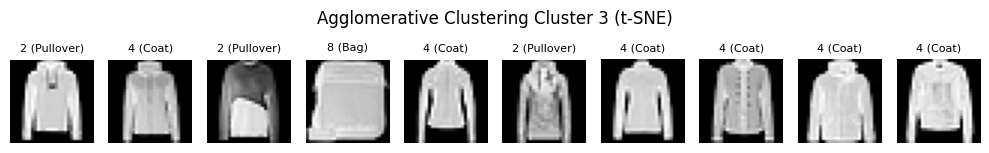

<ipython-input-91-a6092961e32f>:54: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  color_map = plt.cm.get_cmap('tab20', num_labels)
<ipython-input-91-a6092961e32f>:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


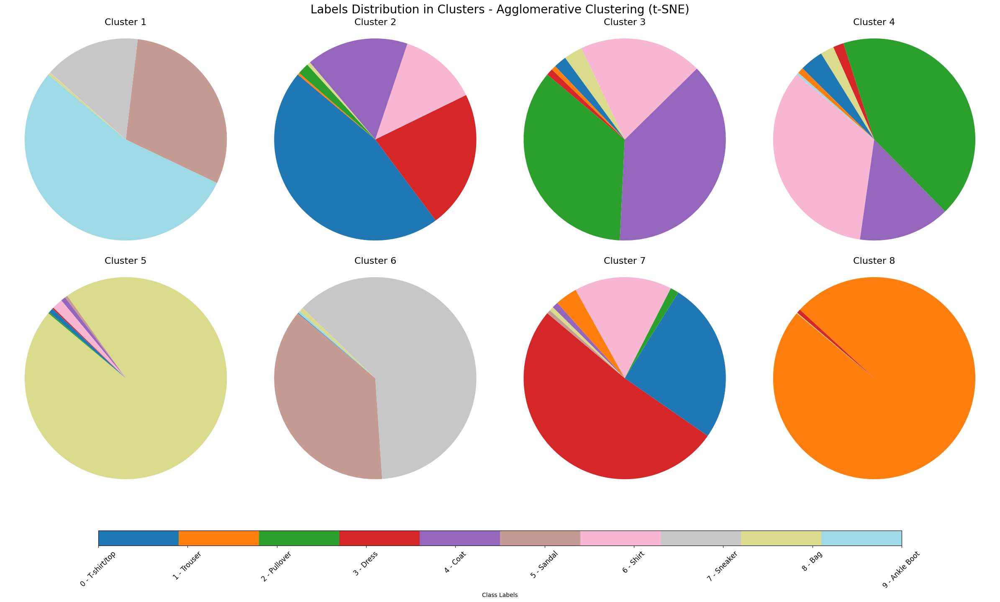

In [ ]:
# @title t-SNE
from sklearn.manifold import TSNE

def scatterplot(x_test_reduced):
  color_map = plt.cm.get_cmap('tab20', 10)

  plt.figure(figsize=(8, 6))
  plt.scatter(x_test_reduced[:, 0], x_test_reduced[:, 1], c=y_test, cmap=color_map, s=10, alpha=1.0)
  plt.colorbar()
  plt.title('t-SNE Visualization')
  plt.xlabel('Dimension 1')
  plt.ylabel('Dimension 2')
  plt.show()

tsne = TSNE(n_components=2, random_state=42)

# fit and training time
start_time = time.time()
x_test_reduced = tsne.fit_transform(x_test) #Since t-SNE doesn't get trained, only the test set was used
end_time = time.time()

print(f"Original Shape:{x_test.shape}   Reduced Shape:{x_test_reduced.shape}")
scatterplot(x_test_reduced)


# reconstruct and compare not available

data['Dimensionality Reduction Technique'] = "t-SNE"
data['Training Time'] = end_time - start_time

df = clustering_metric_loop(df, x_test_reduced, "t-SNE")

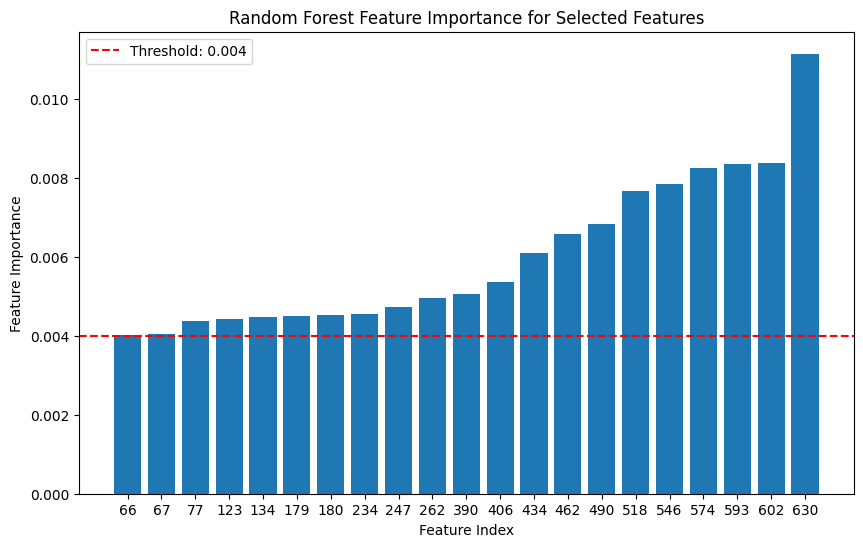

Original Shape:(10000, 784)   Reduced Shape:(10000, 21)


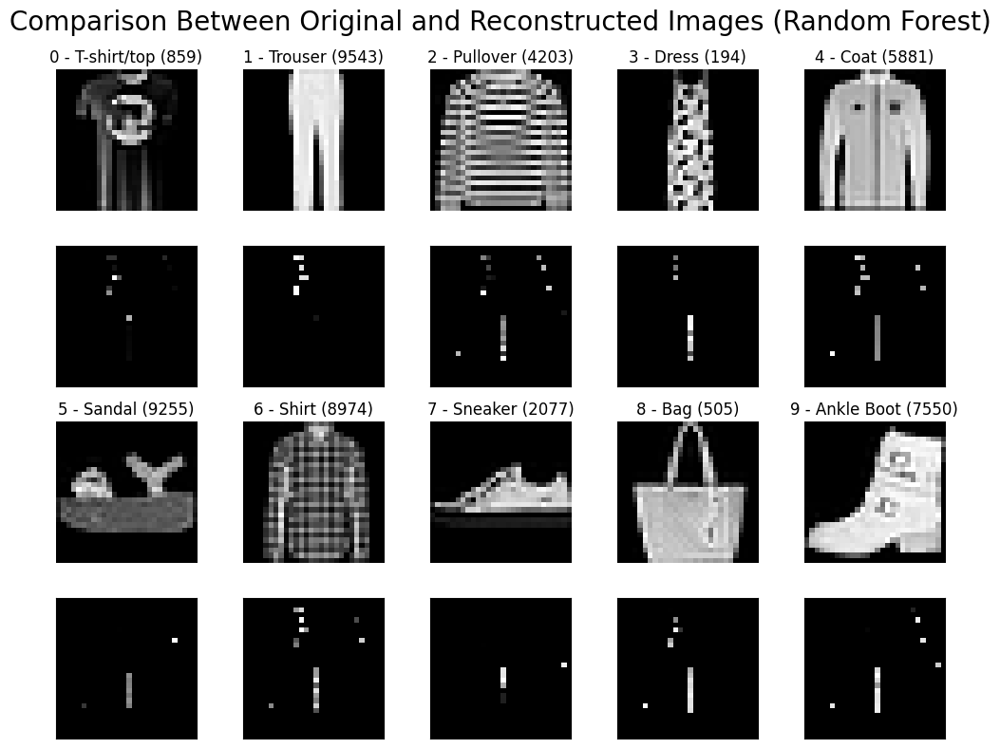

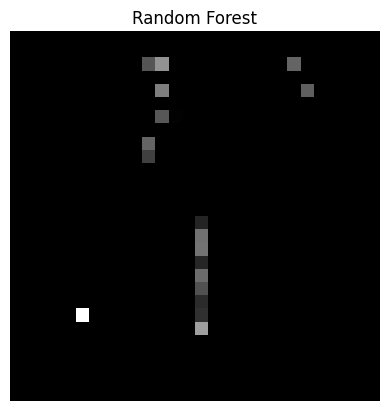

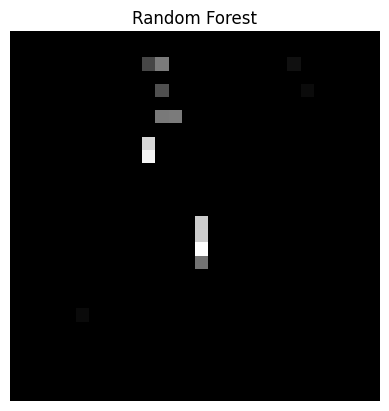

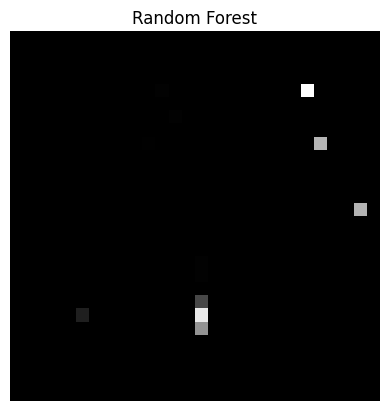

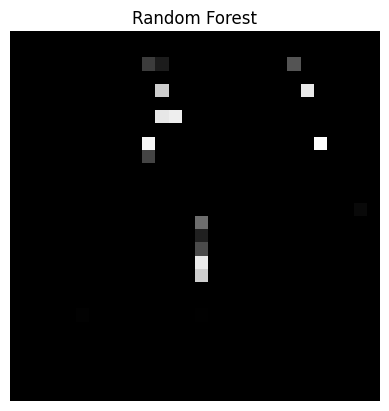

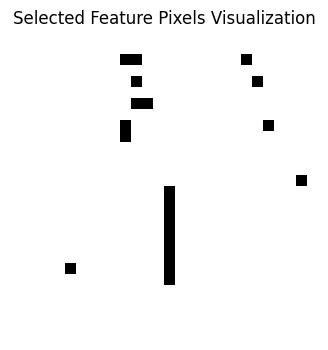

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 3 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


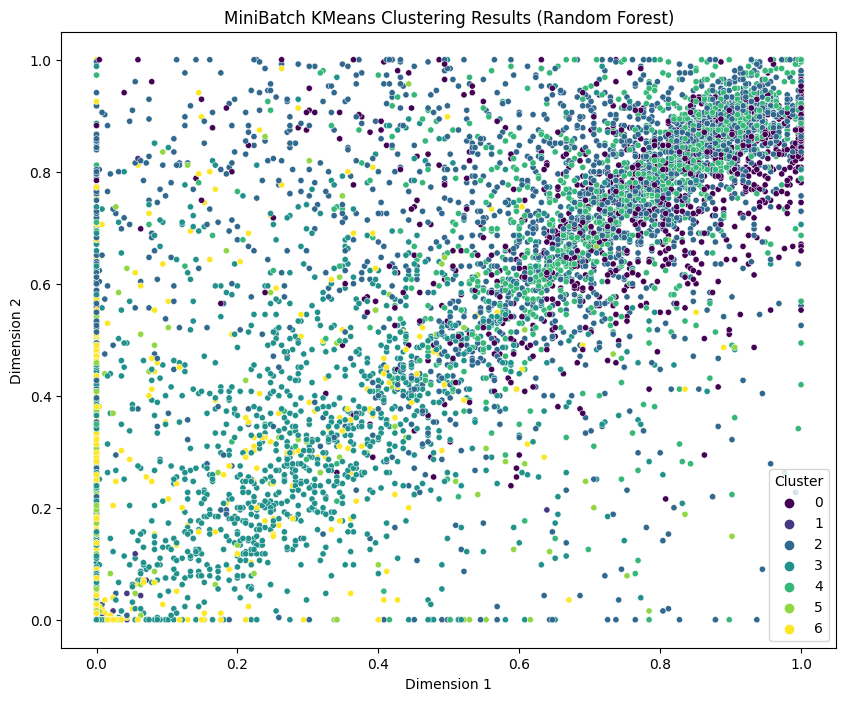

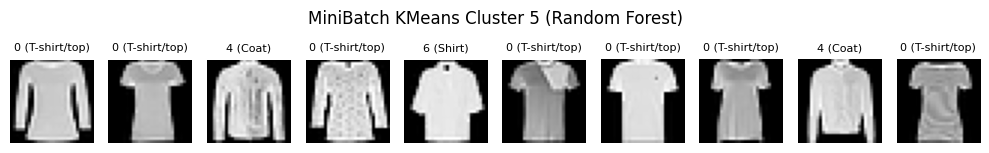

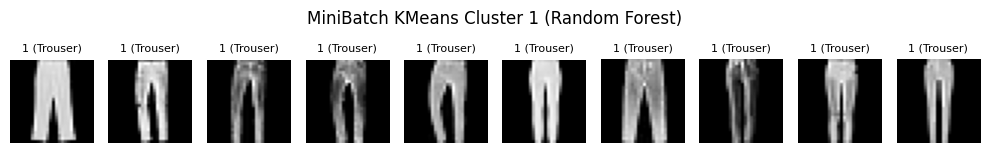

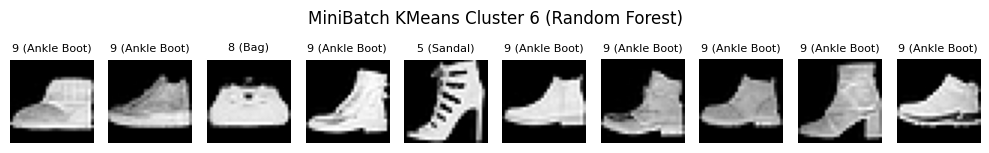

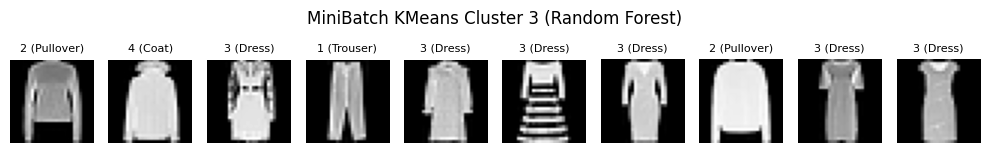

<ipython-input-91-a6092961e32f>:54: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  color_map = plt.cm.get_cmap('tab20', num_labels)
<ipython-input-91-a6092961e32f>:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


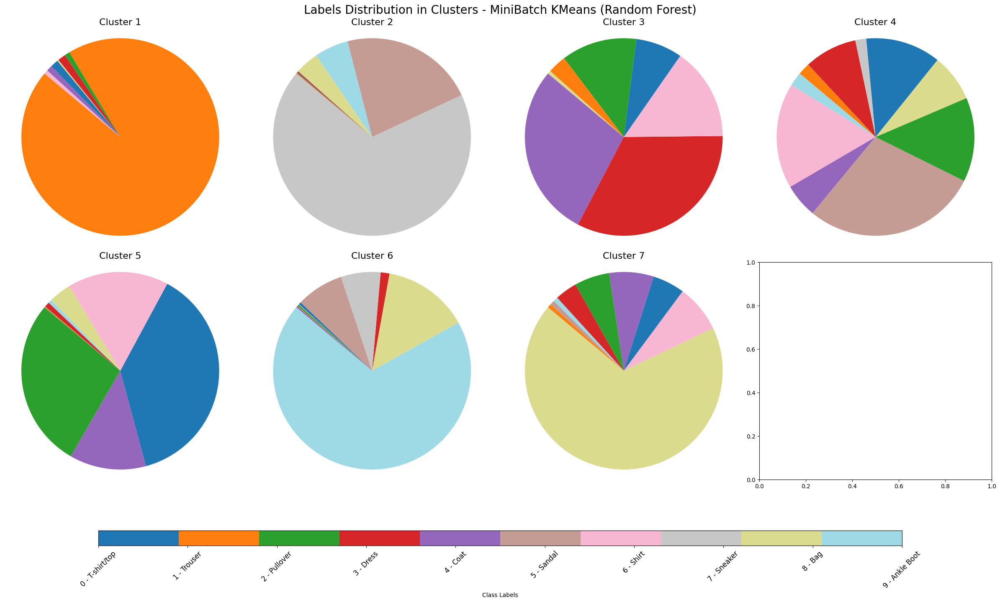

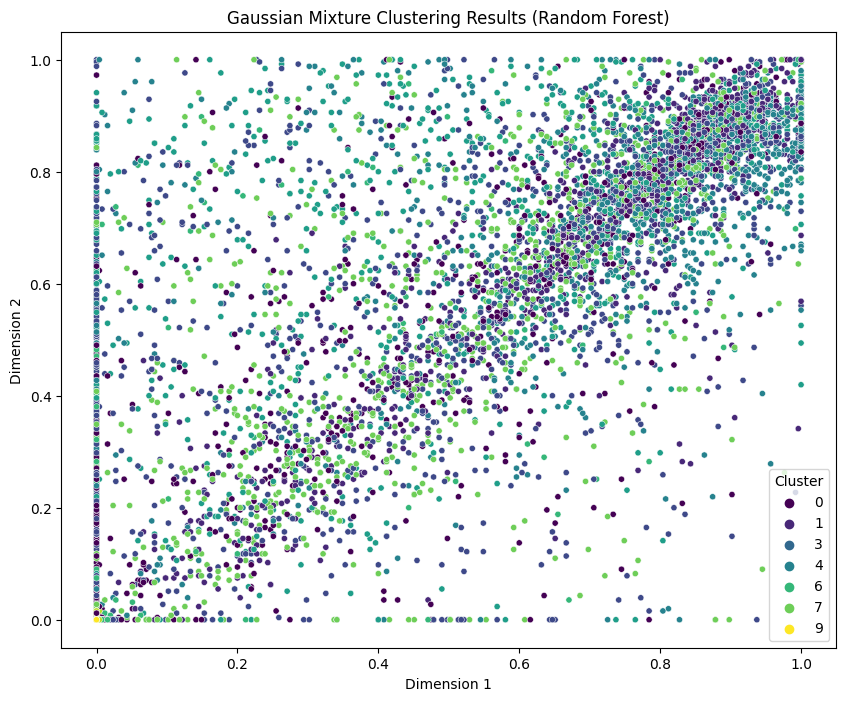

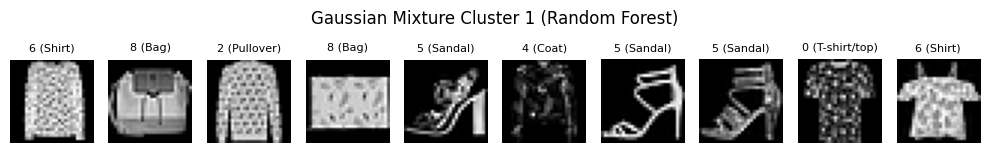

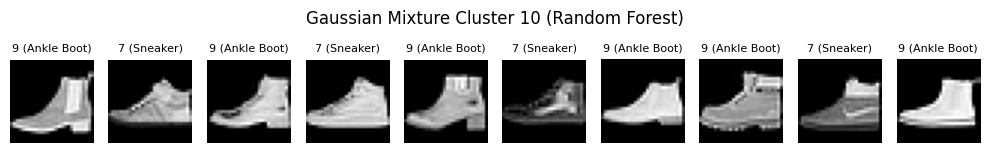

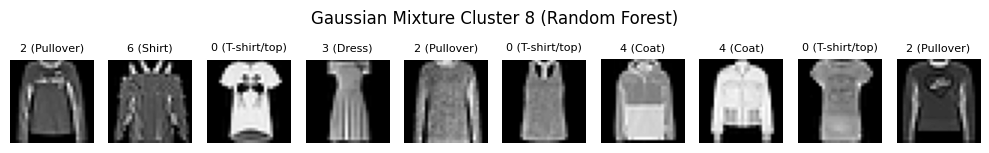

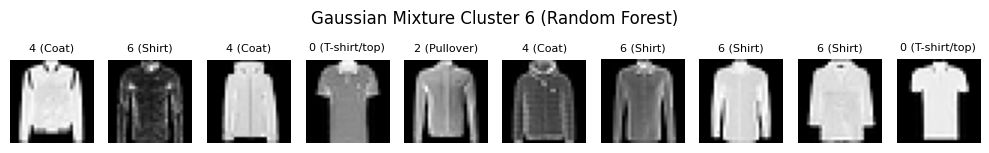

<ipython-input-91-a6092961e32f>:54: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  color_map = plt.cm.get_cmap('tab20', num_labels)
<ipython-input-91-a6092961e32f>:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


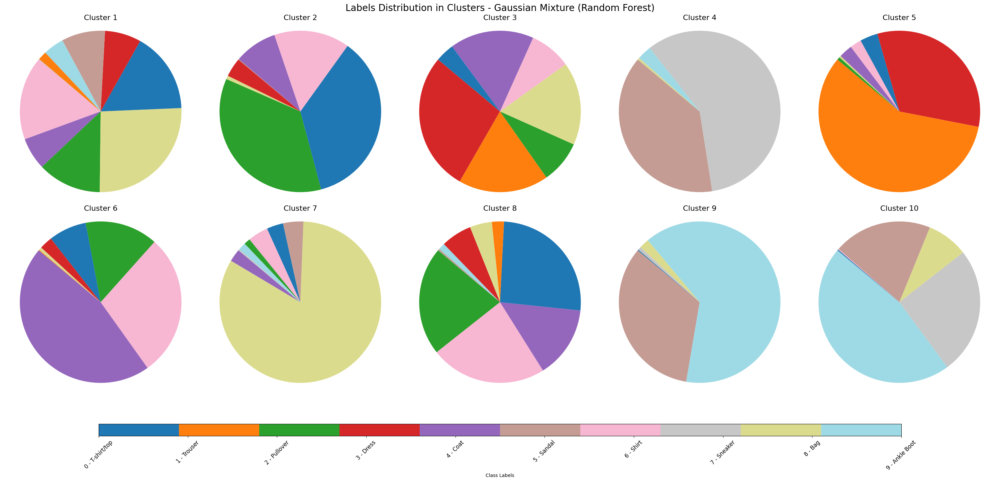

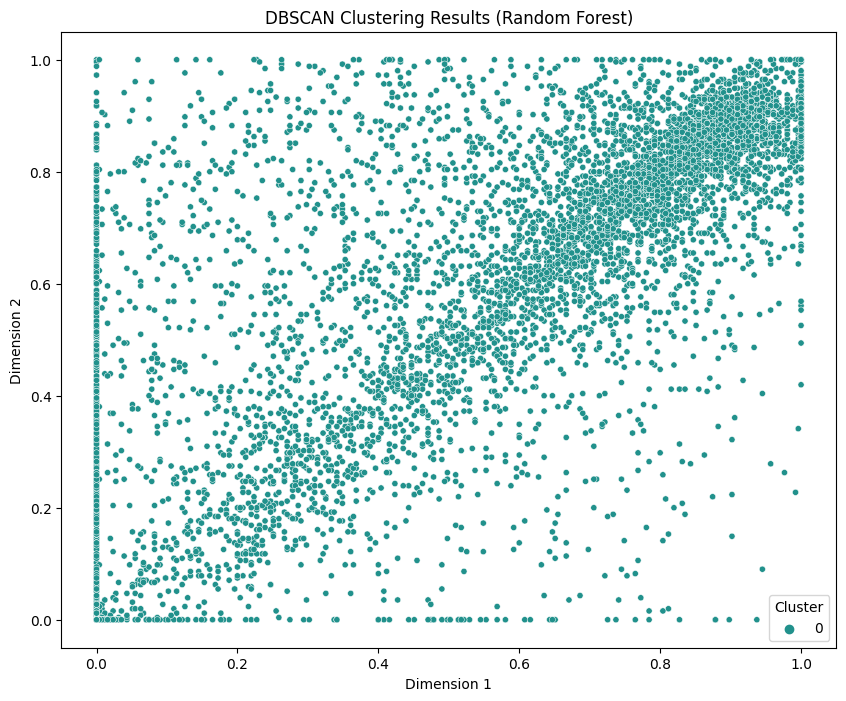

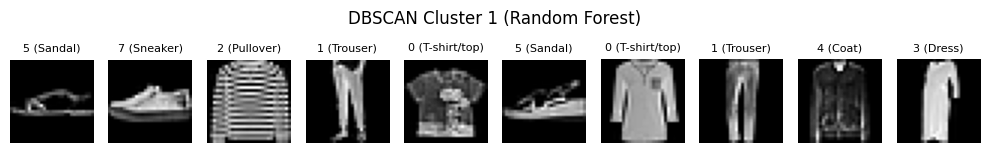

<ipython-input-91-a6092961e32f>:54: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  color_map = plt.cm.get_cmap('tab20', num_labels)
<ipython-input-91-a6092961e32f>:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


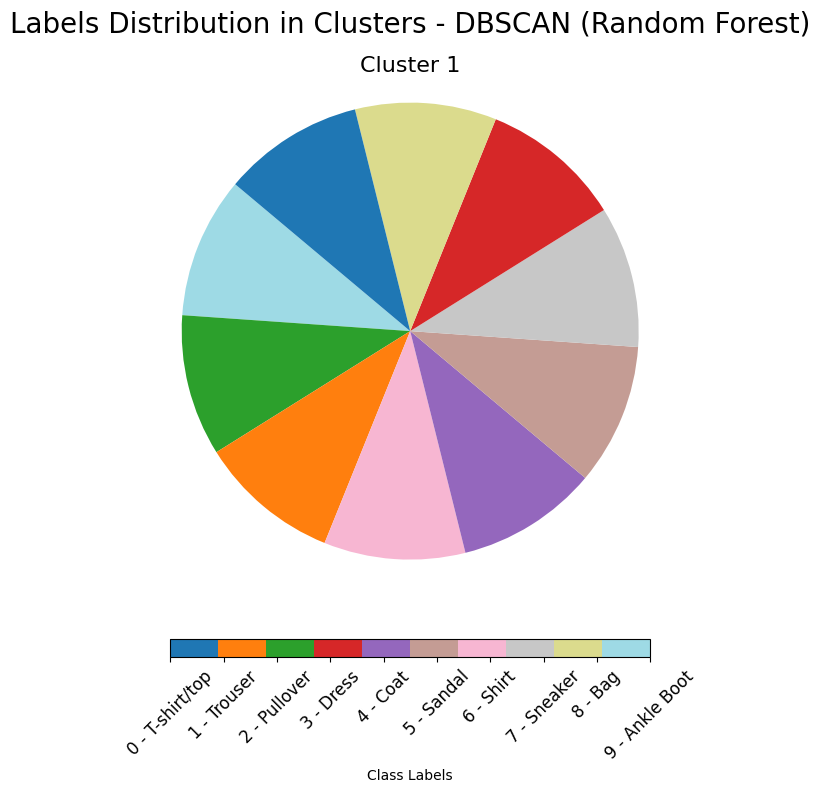

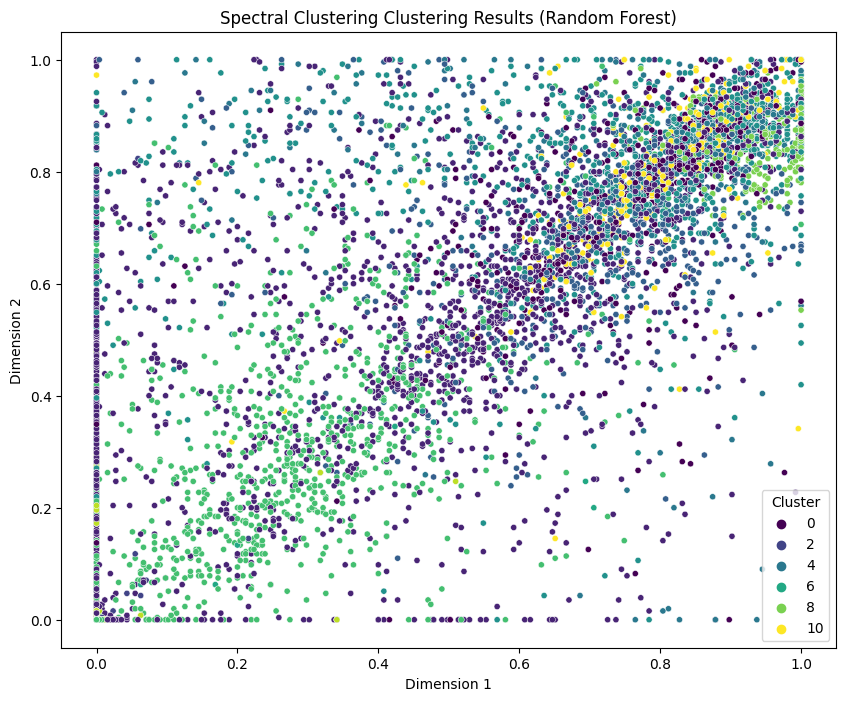

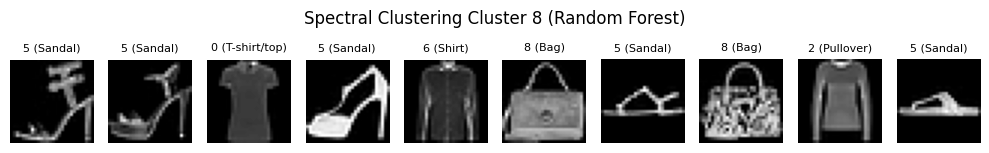

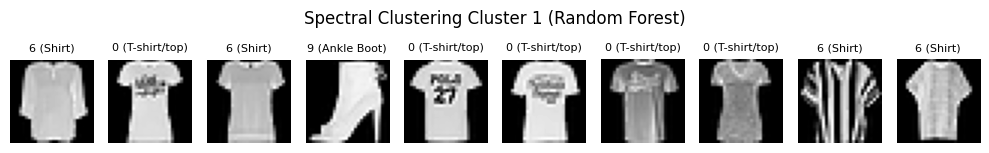

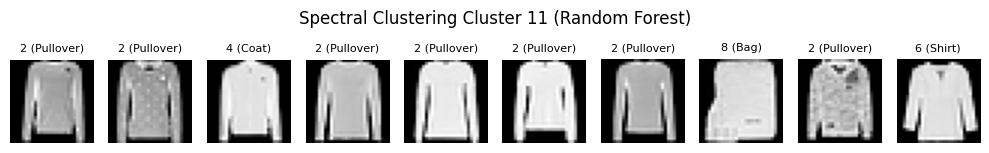

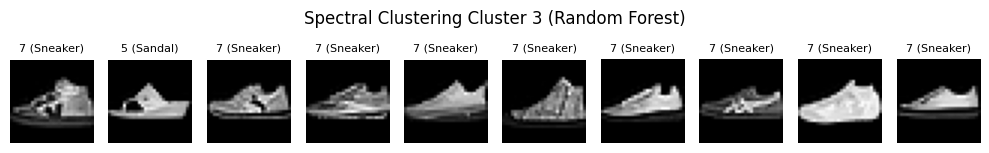

<ipython-input-91-a6092961e32f>:54: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  color_map = plt.cm.get_cmap('tab20', num_labels)
<ipython-input-91-a6092961e32f>:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


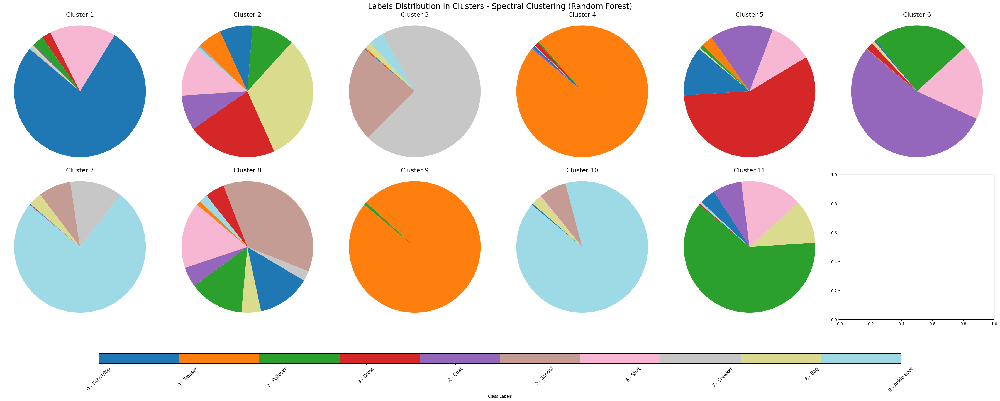

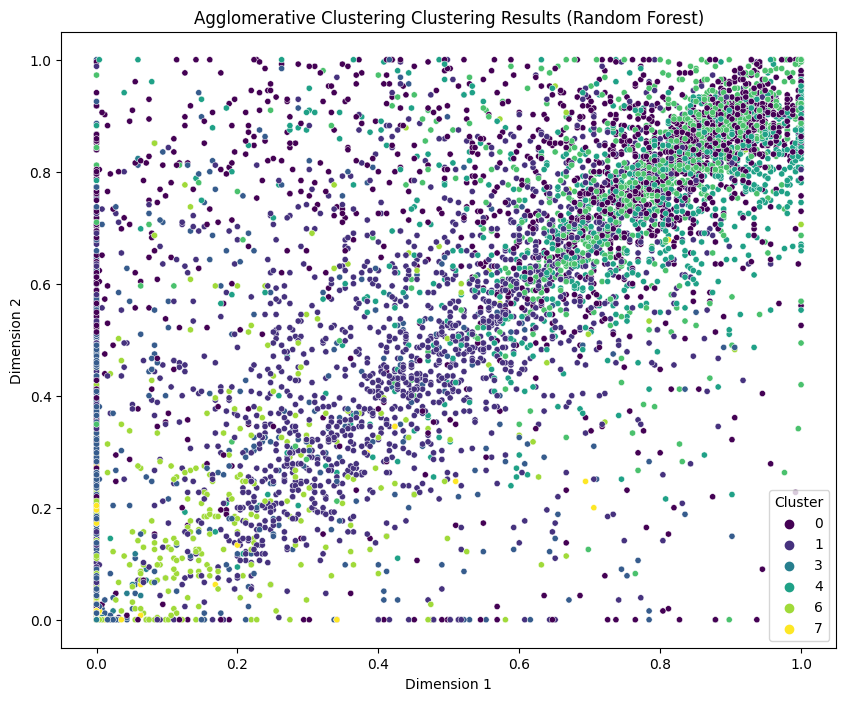

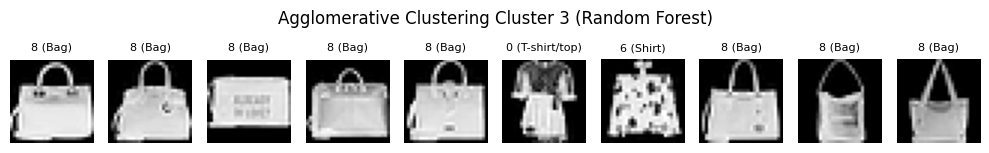

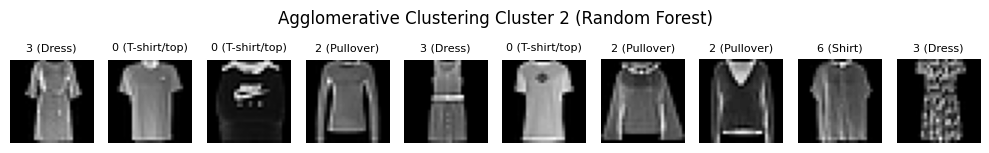

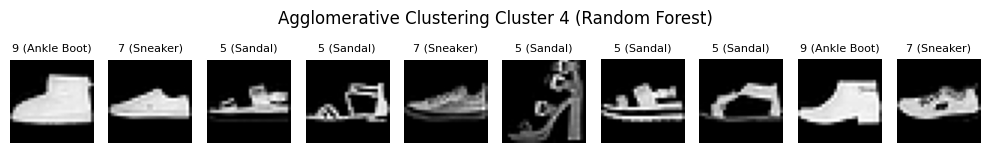

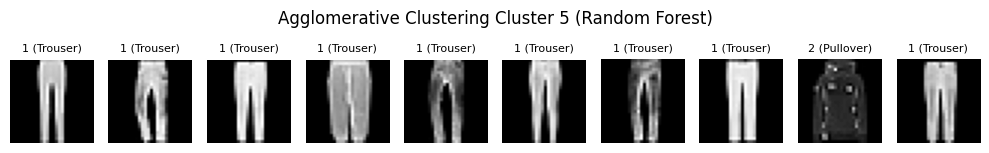

<ipython-input-91-a6092961e32f>:54: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  color_map = plt.cm.get_cmap('tab20', num_labels)
<ipython-input-91-a6092961e32f>:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


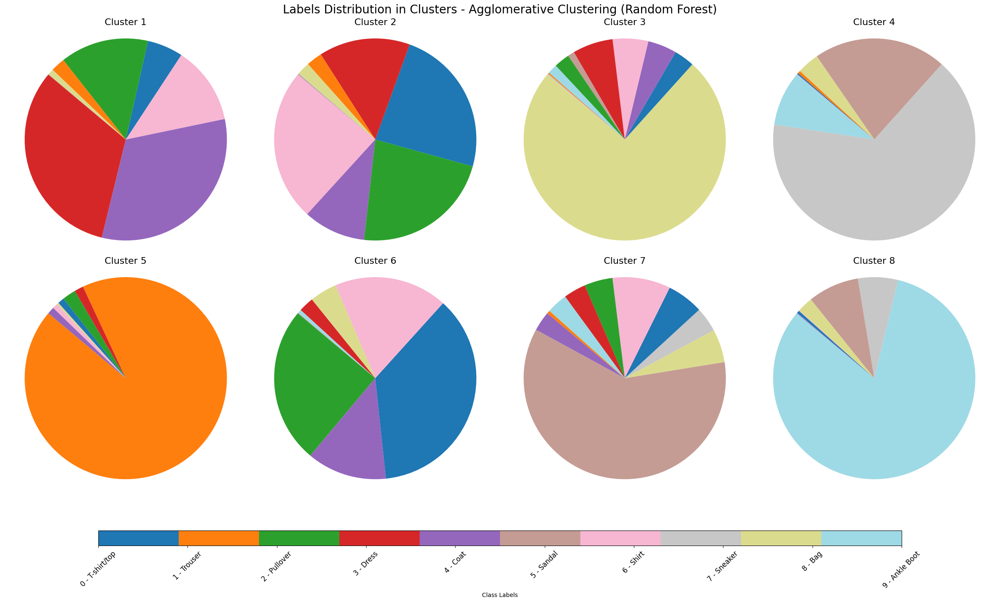

In [ ]:
# @title Random Forest

from sklearn.ensemble import RandomForestClassifier
from sklearn.feature_selection import SelectFromModel

name = "Random Forest"

def reconstruct_imgs_rf(x, selected_features_indices):
    reconstructed_data = np.zeros((x.shape[0], 28 * 28))  # Initialize for image reshape
    reconstructed_data[:, selected_features_indices] = x

    # Reshape into images
    reconstructed_images = reconstructed_data.reshape(x.shape[0], 28, 28)

    return reconstructed_images

def plot_feature_importances(random_forest, selected_features_indices, threshold_value):
    # Get the feature importances of the selected features
    feature_importances = random_forest.feature_importances_[selected_features_indices]

    # Plot the feature importances for selected features
    sorted_idx = np.argsort(feature_importances)

    plt.figure(figsize=(10, 6))
    plt.bar(range(len(sorted_idx)), feature_importances[sorted_idx], align="center")
    plt.xticks(range(len(selected_features_indices)), selected_features_indices)
    plt.xlabel("Feature Index")
    plt.ylabel("Feature Importance")
    plt.title("Random Forest Feature Importance for Selected Features")

    # Add a threshold line
    plt.axhline(y=threshold_value, color='r', linestyle='--', label=f'Threshold: {threshold_value}')
    plt.legend()
    plt.show()

def visualize_selected_features(selected_features_indices):
    # Create a binary mask with all ones (white background)
    mask = np.zeros((28, 28))

    # Set the selected feature pixels to 0 (black pixels)
    mask.flat[selected_features_indices] = 1

    # Plotting the inverted mask
    plt.figure(figsize=(4, 4))
    plt.imshow(mask, cmap='binary_r')  # Use binary_r colormap for inverted binary colors
    plt.title('Selected Feature Pixels Visualization')
    plt.axis('off')
    plt.show()

def random_forest_clustering(x, y, x_test):
  # Train a Random Forest classifier
  random_forest = RandomForestClassifier(n_estimators=100, random_state=42)
  random_forest.fit(x, y)

  # Choose a threshold value
  threshold_value = 0.004

  # Use SelectFromModel to select features based on importance
  sfm = SelectFromModel(random_forest, threshold = threshold_value)
  sfm.fit(x, y)

  # Get the selected features
  selected_features_indices = np.where(sfm.get_support())[0]

  # Transform the data to keep only selected features
  x_reduced = sfm.transform(x_test)

  # Plot
  plot_feature_importances(random_forest, selected_features_indices, threshold_value)

  return x_reduced, selected_features_indices

# fit and training time
start_time = time.time()
x_test_reduced, selected_feature_indices = random_forest_clustering(x_train, y_train, x_test)
end_time = time.time()

print(f"Original Shape:{x_test.shape}   Reduced Shape:{x_test_reduced.shape}")

# reconstruct
reconstructed = reconstruct_imgs_rf(x_test_reduced, selected_feature_indices)

#Plots
compare_images_plot(x_test, reconstructed, y_test, name)
display_case_studies(reconstructed, name)
visualize_selected_features(selected_feature_indices)

# Clustering and Metrics
data['Dimensionality Reduction Technique'] = name
data['Training Time'] = end_time - start_time
df = clustering_metric_loop(df, x_test_reduced, name)

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 784)]             0         
                                                                 
 encoded_layer_1 (Dense)     (None, 128)               100480    
                                                                 
 encoded_layer_2 (Dense)     (None, 64)                8256      
                                                                 
 encoded_layer_3 (Dense)     (None, 32)                2080      
                                                                 
 decoded_layer_1 (Dense)     (None, 64)                2112      
                                                                 
 decoded_layer_2 (Dense)     (None, 128)               8320      
                                                                 
 decoded_layer_3 (Dense)     (None, 784)               101136

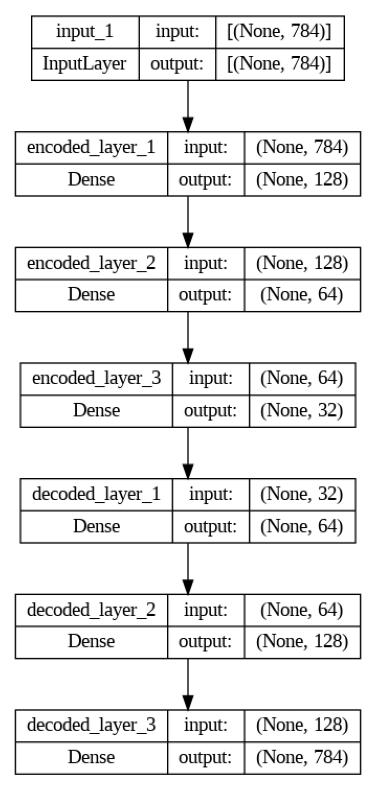

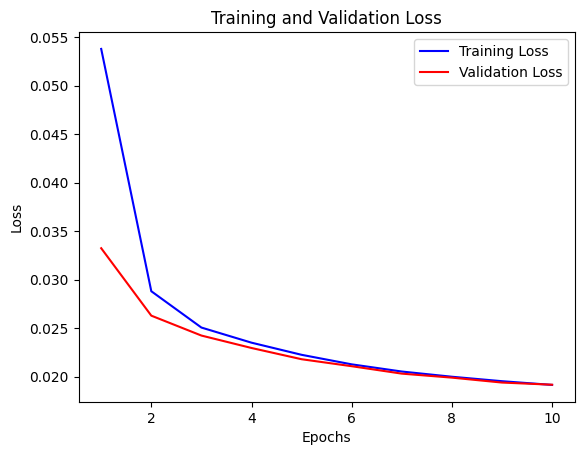

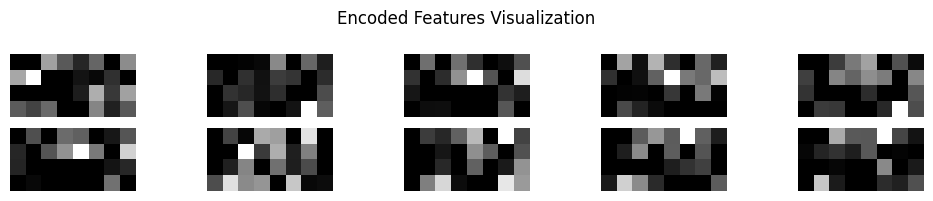

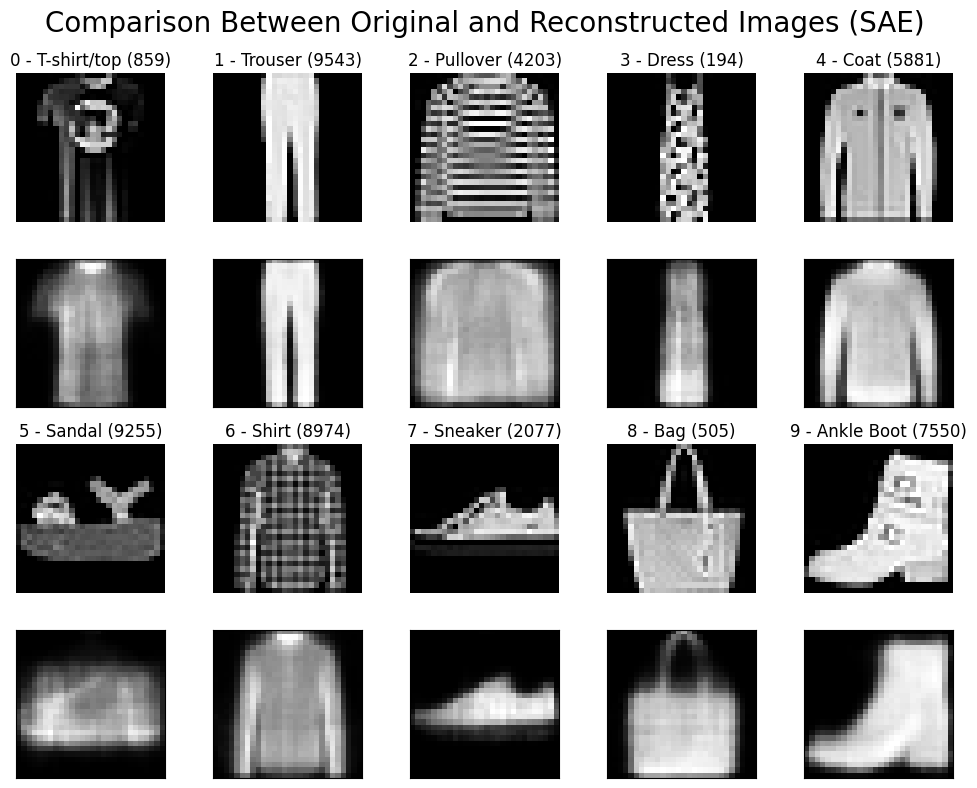

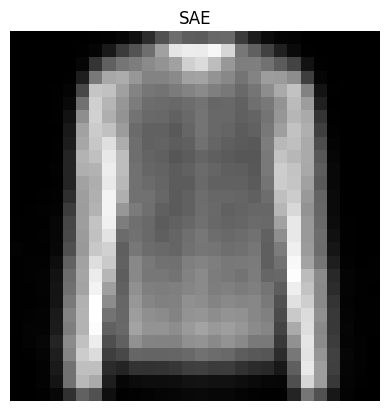

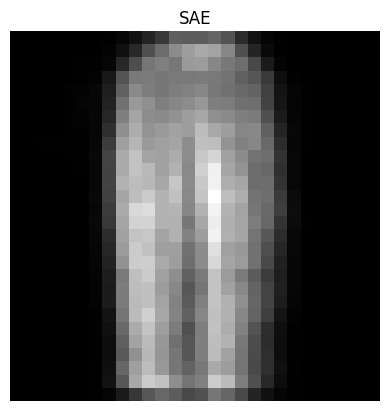

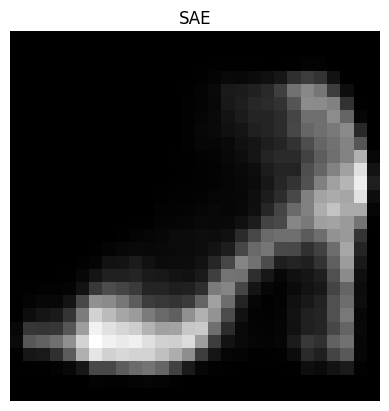

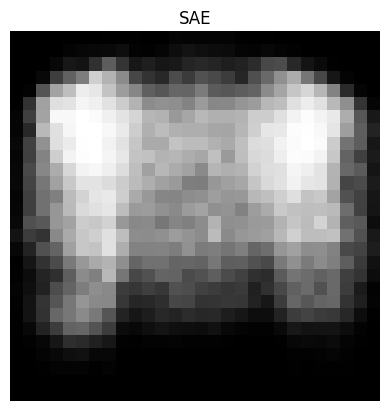

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 3 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


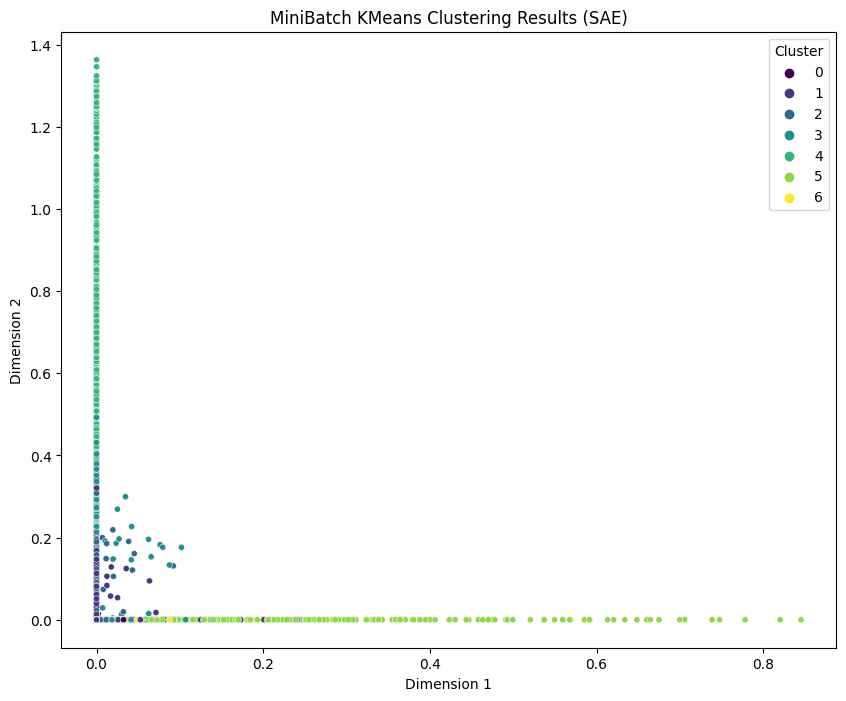

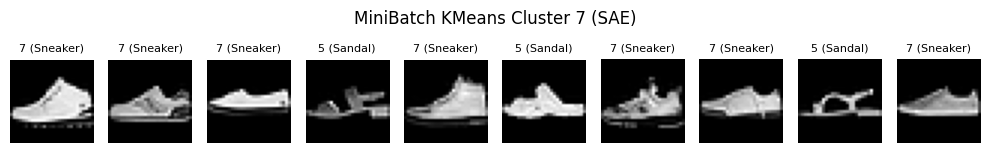

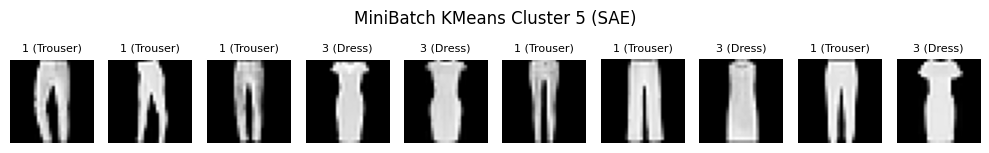

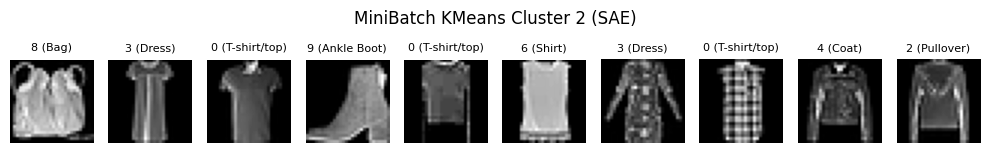

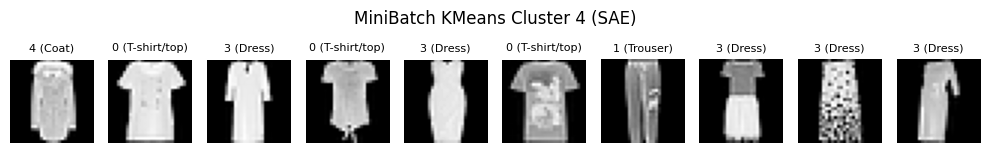

<ipython-input-91-a6092961e32f>:54: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  color_map = plt.cm.get_cmap('tab20', num_labels)
<ipython-input-91-a6092961e32f>:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


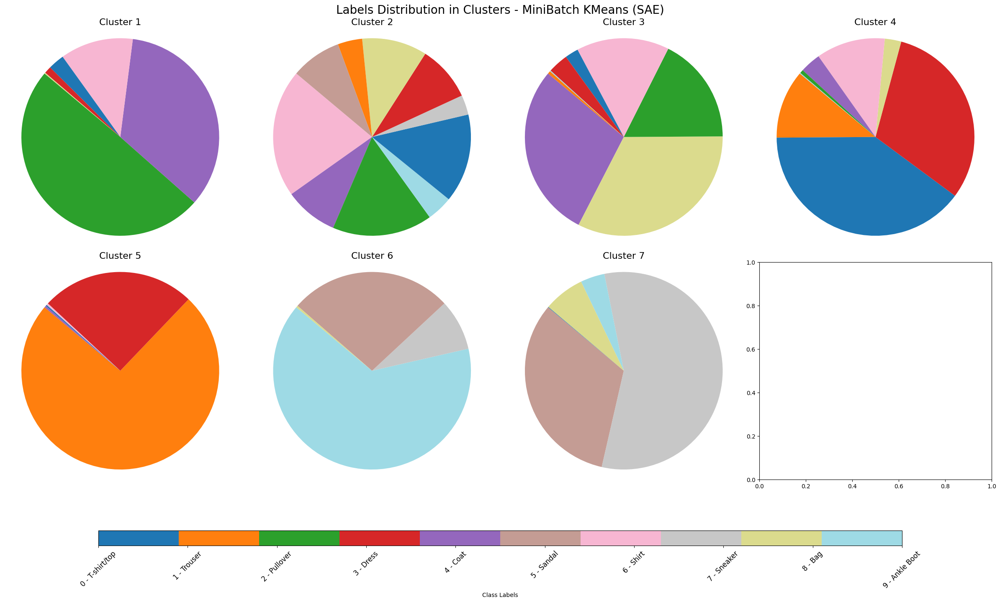

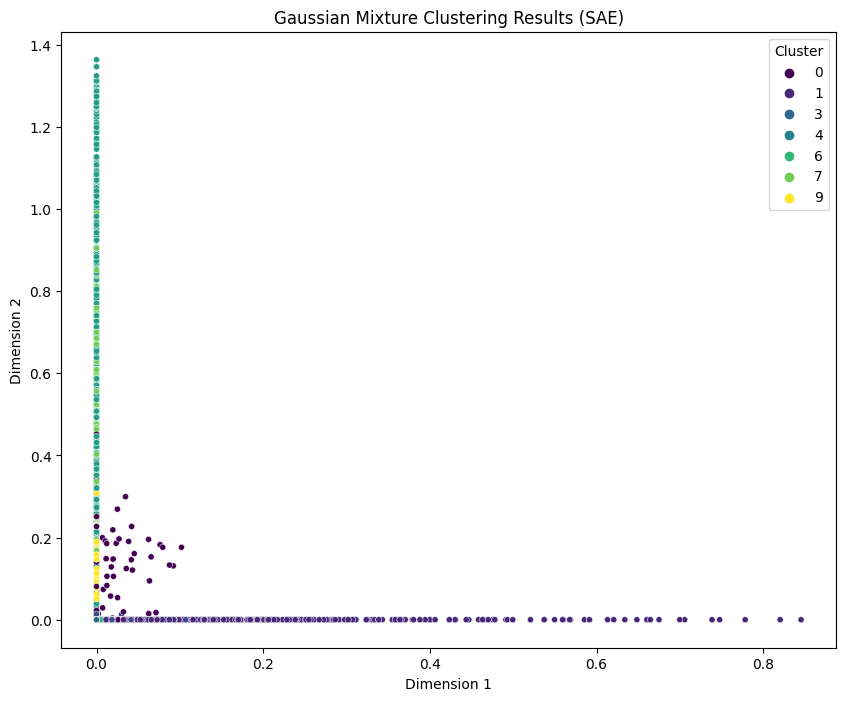

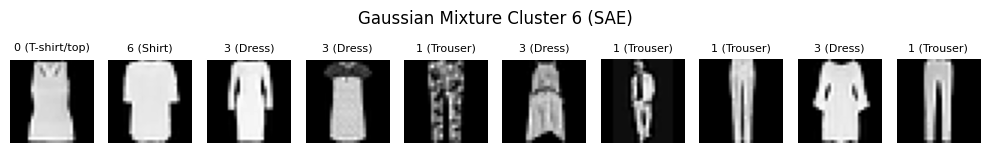

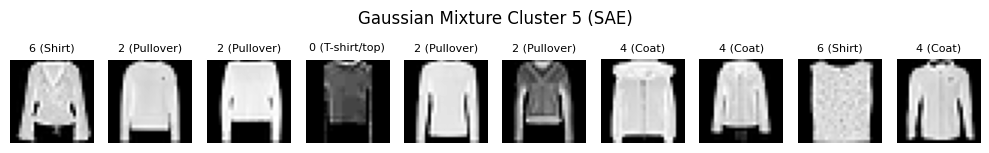

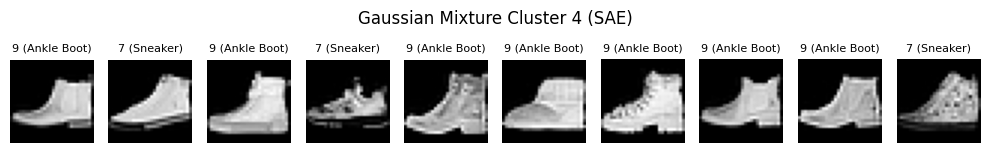

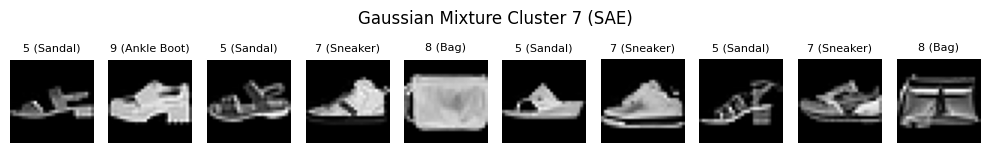

<ipython-input-91-a6092961e32f>:54: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  color_map = plt.cm.get_cmap('tab20', num_labels)
<ipython-input-91-a6092961e32f>:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


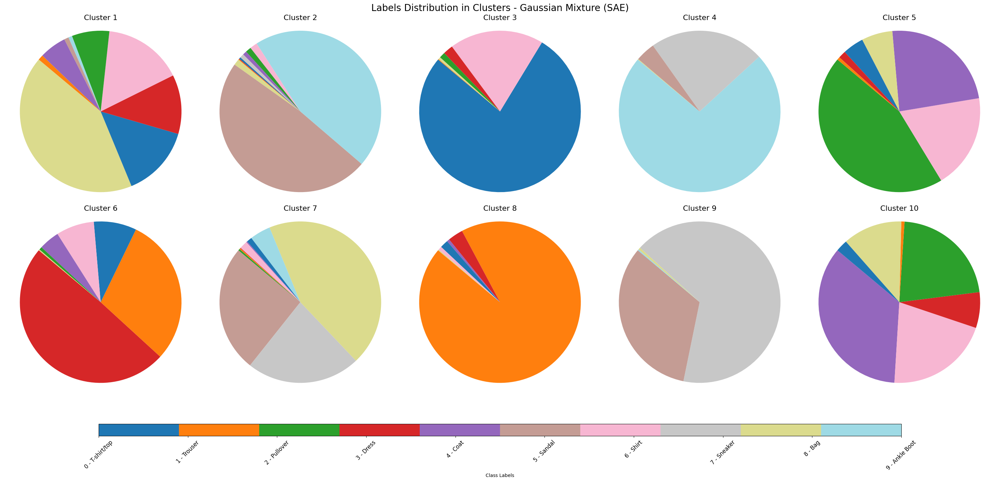

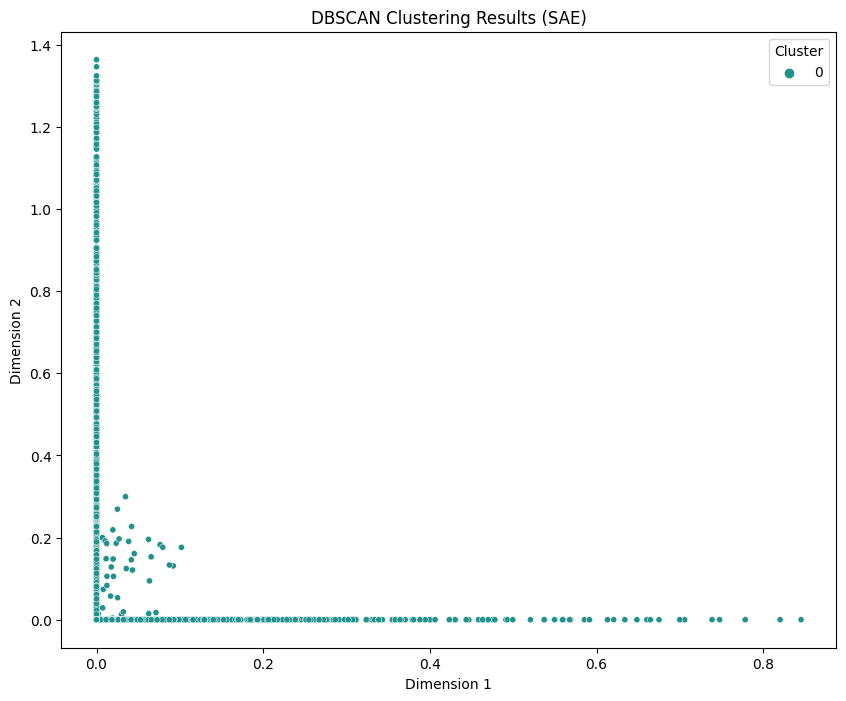

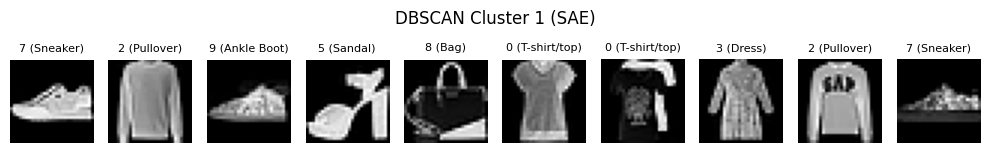

<ipython-input-91-a6092961e32f>:54: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  color_map = plt.cm.get_cmap('tab20', num_labels)
<ipython-input-91-a6092961e32f>:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


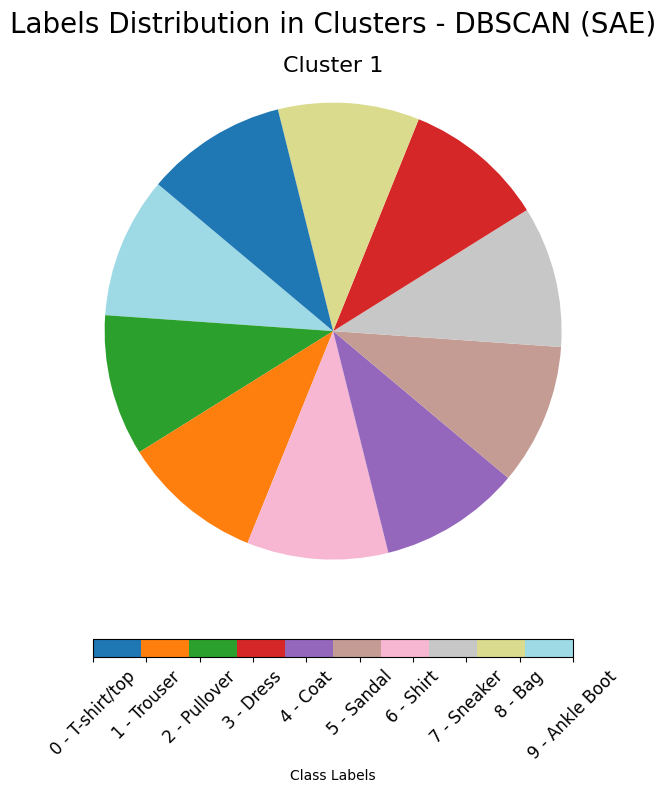

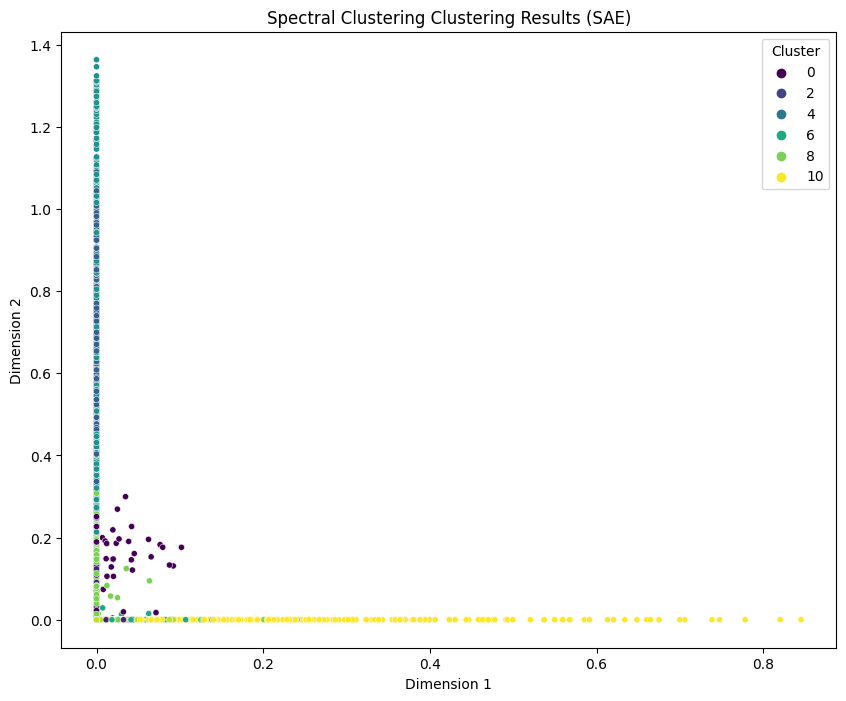

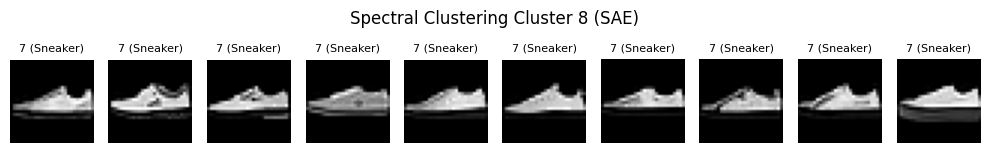

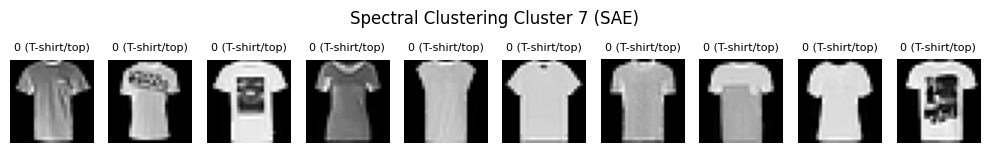

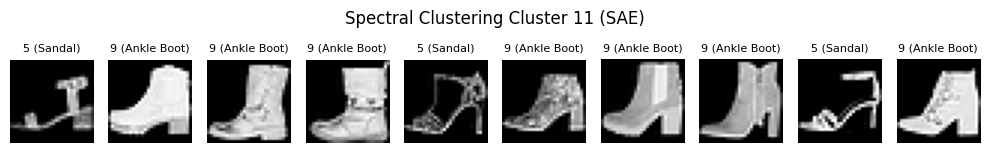

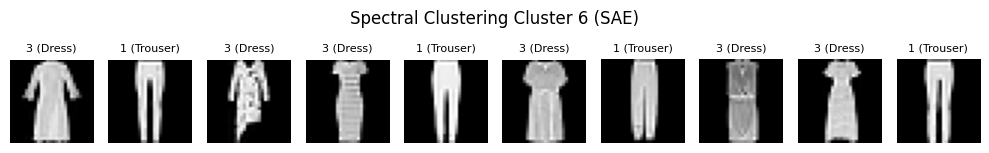

<ipython-input-91-a6092961e32f>:54: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  color_map = plt.cm.get_cmap('tab20', num_labels)
<ipython-input-91-a6092961e32f>:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


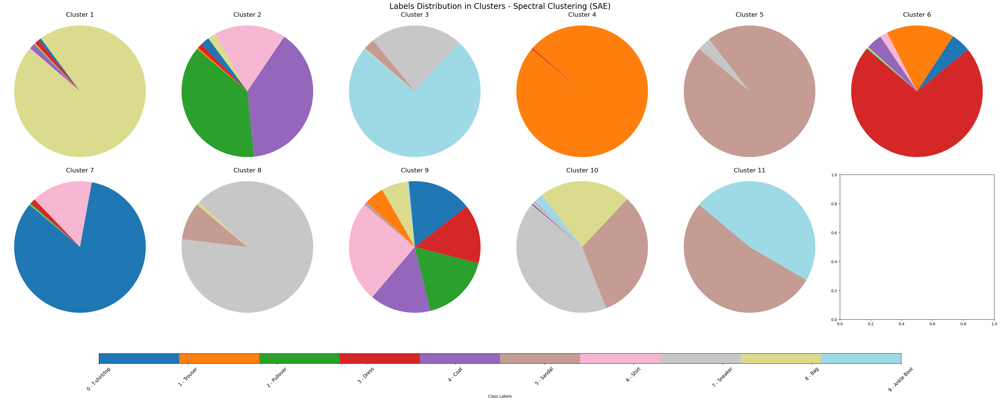

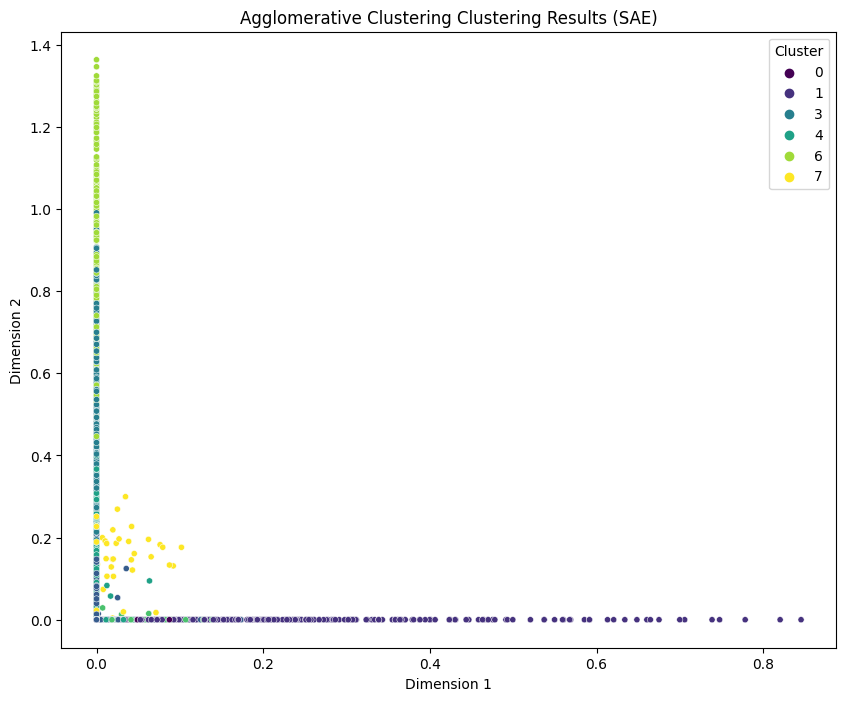

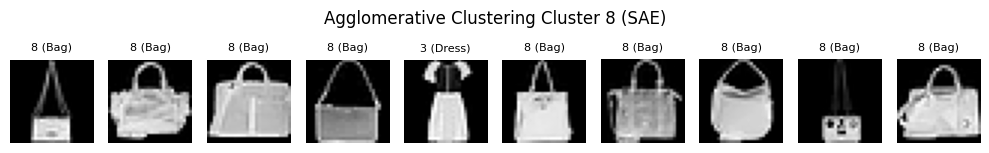

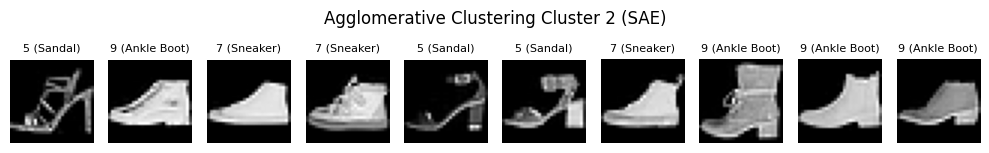

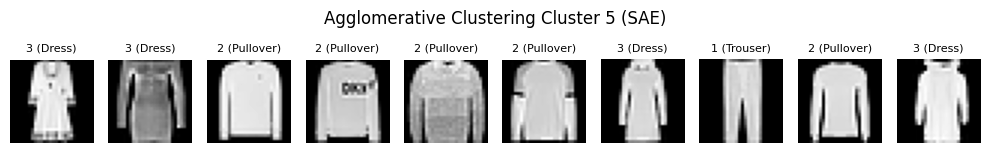

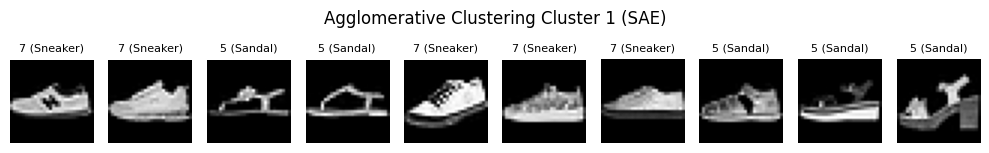

<ipython-input-91-a6092961e32f>:54: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  color_map = plt.cm.get_cmap('tab20', num_labels)
<ipython-input-91-a6092961e32f>:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


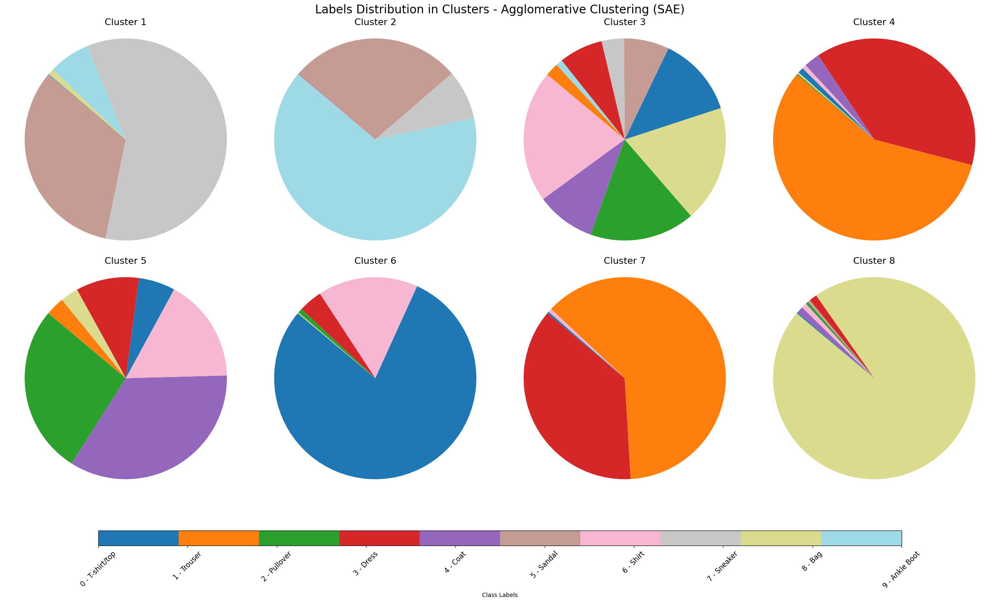

In [ ]:
# @title SAE
from keras.models import Sequential,Model
from keras.layers import Dense, Reshape, Conv2D, MaxPool2D, Conv2DTranspose
from keras.optimizers import Adam, SGD
from keras import regularizers
from tensorflow import keras
from tensorflow.keras import layers
from keras.utils import plot_model
from tensorflow.keras import models

import tensorflow as tf
tf.keras.backend.clear_session()

name = "SAE"

def SAE_constructor():
  # Define a Stacked Autoencoder model
  autoencoder = Sequential()
  input_img = keras.Input(shape=(784,))

  # Encoder with sparsity constraint
  encoded = layers.Dense(128, activation='relu', activity_regularizer=regularizers.l1(1e-4), name='encoded_layer_1')(input_img)
  encoded = layers.Dense(64, activation='relu', activity_regularizer=regularizers.l1(1e-4), name='encoded_layer_2')(encoded)
  encoded = layers.Dense(32, activation='relu', activity_regularizer=regularizers.l1(1e-4), name='encoded_layer_3')(encoded)

  # Decoder
  decoded = layers.Dense(64, activation='relu', name='decoded_layer_1')(encoded)
  decoded = layers.Dense(128, activation='relu', name='decoded_layer_2')(decoded)
  decoded = layers.Dense(784, activation='sigmoid', name='decoded_layer_3')(decoded)

  autoencoder = keras.Model(input_img, decoded)

  return autoencoder

sae = SAE_constructor()
sae.compile(optimizer=Adam(), loss='mean_squared_error')
sae.summary()

# Train SAE
start_time = time.time()
history = sae.fit(x_train, x_train, epochs=10, batch_size=128, shuffle=True, validation_data=(x_val, x_val))
end_time = time.time()

# Extract the encoder part from the trained SAE
encoder_layers = sae.layers[1:4]  # Extract layers from input to the last layer of the encoder
encoder = Model(inputs=sae.input, outputs=encoder_layers[-1].output)

# Make Predictions
reconstructed = sae.predict(x_test)
x_test_reduced = encoder.predict(x_test)
print(f"Original Shape:{x_test.shape}   Reduced Shape:{x_test_reduced.shape}")

# Plots
show_plot_model(sae)
plot_loss(history)
plot_features(x_test_reduced)
#visualize_weights(sae) #weights represent the learned parameters determining the network's behavior
compare_images_plot(x_test, reconstructed, y_test, name)
display_case_studies(reconstructed, name)

# Clustering + Metrics
data['Dimensionality Reduction Technique'] = name
data['Training Time'] = end_time - start_time
df = clustering_metric_loop(df, x_test_reduced, name)


Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 28, 28, 1)]       0         
                                                                 
 conv2d (Conv2D)             (None, 28, 28, 32)        320       
                                                                 
 batch_normalization (Batch  (None, 28, 28, 32)        128       
 Normalization)                                                  
                                                                 
 max_pooling2d (MaxPooling2  (None, 14, 14, 32)        0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (None, 14, 14, 16)        4624      
                                                                 
 batch_normalization_1 (Bat  (None, 14, 14, 16)        64    

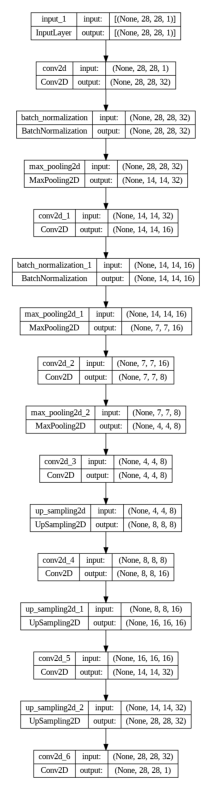

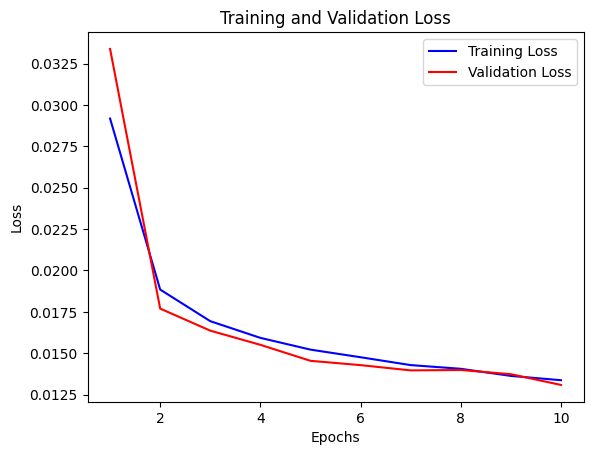

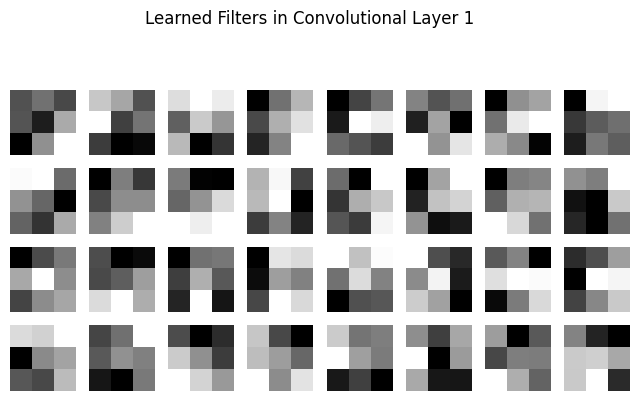

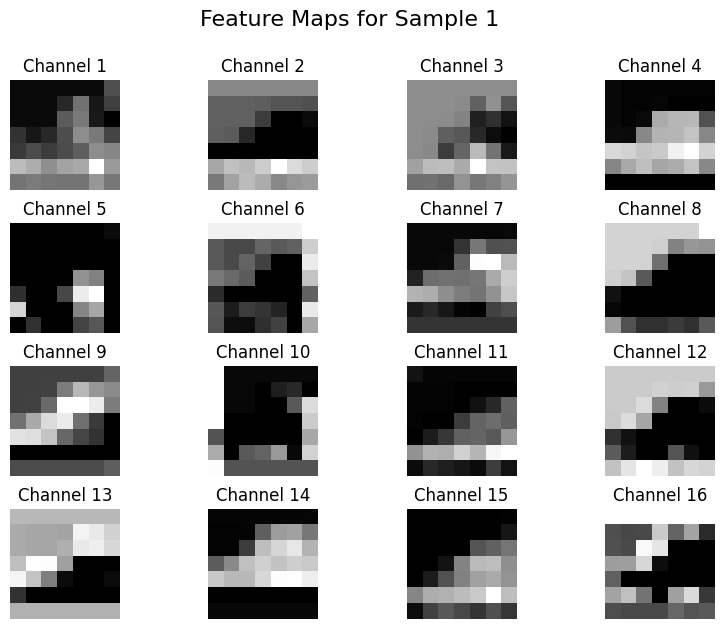

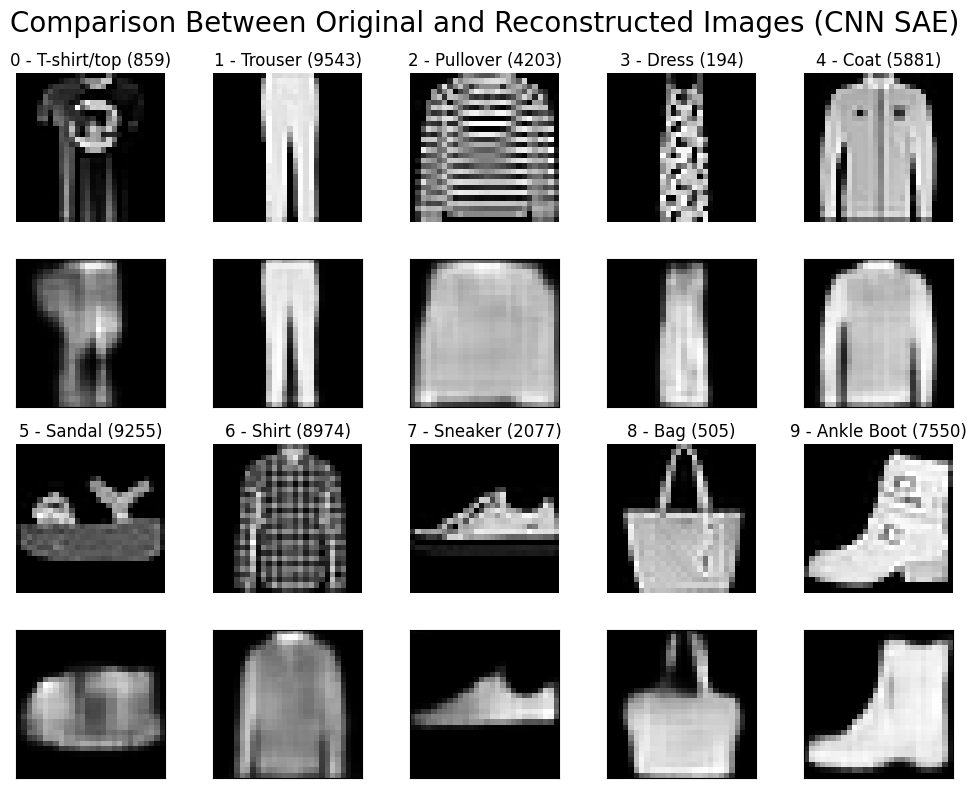

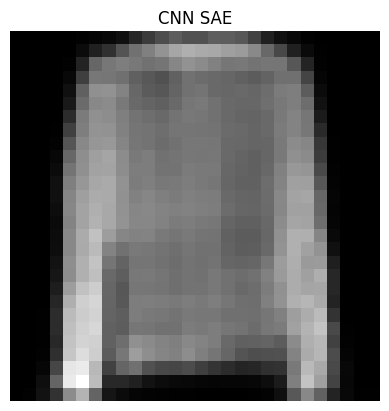

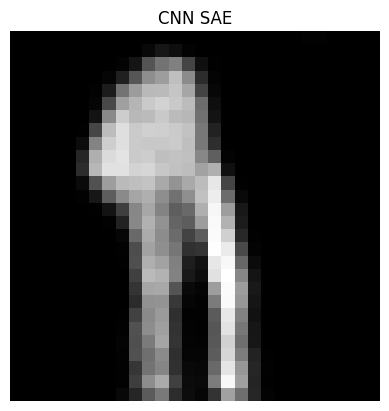

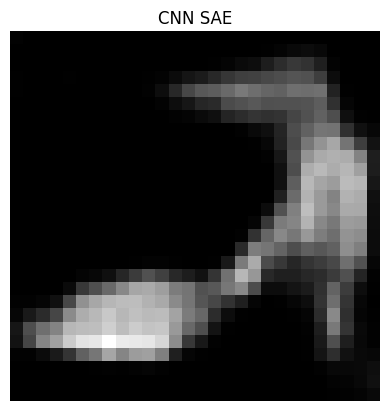

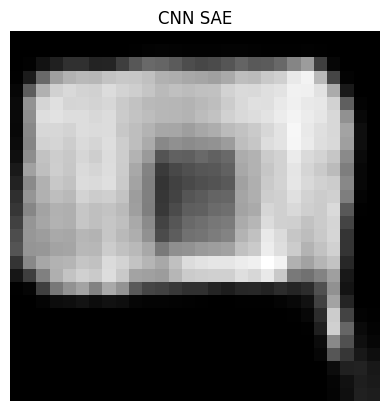

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 3 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


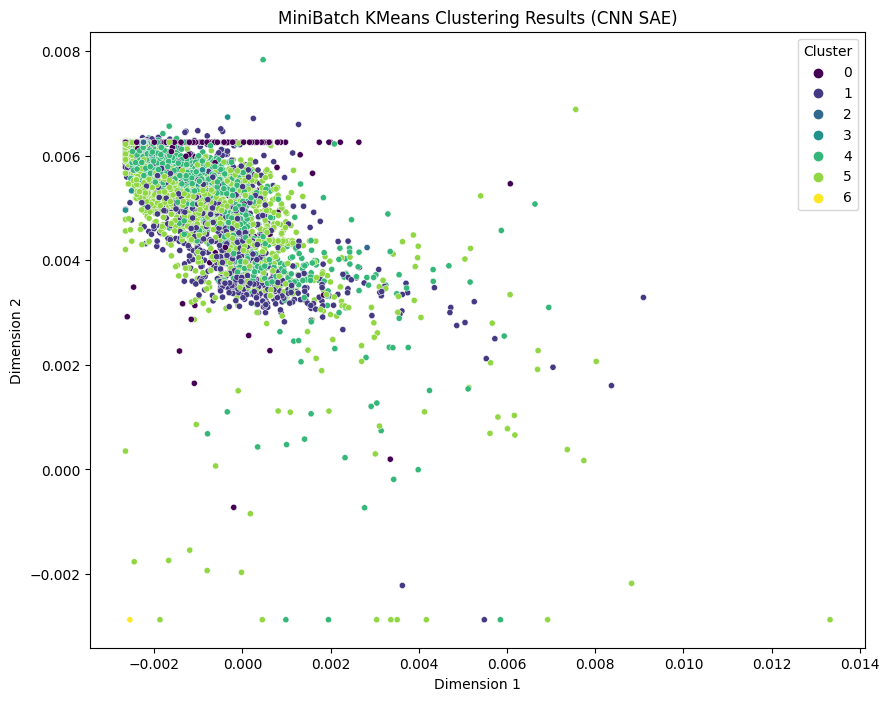

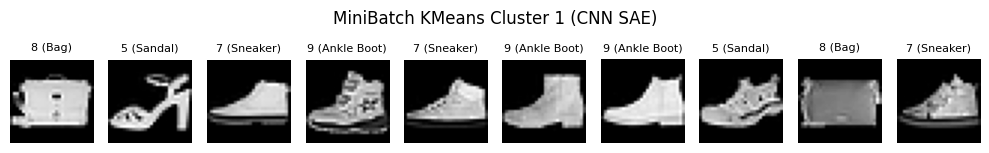

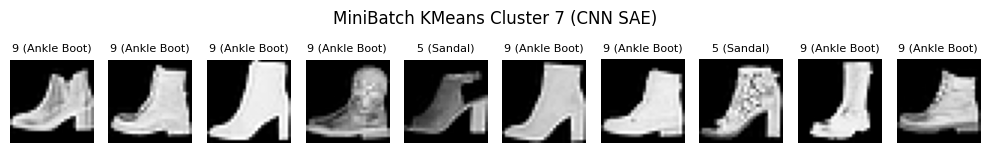

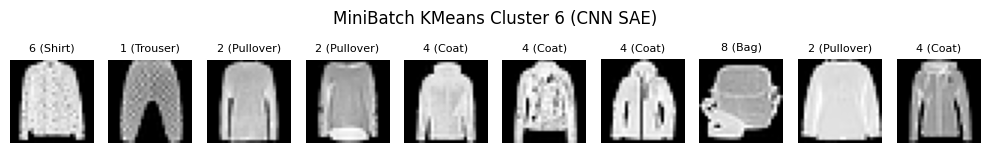

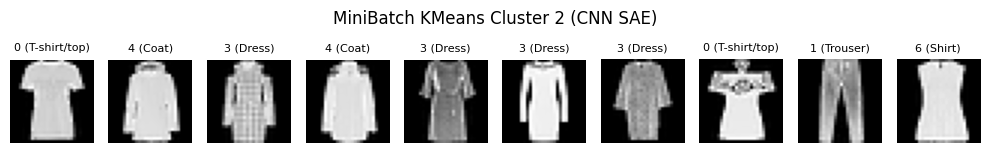

<ipython-input-91-a6092961e32f>:54: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  color_map = plt.cm.get_cmap('tab20', num_labels)
<ipython-input-91-a6092961e32f>:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


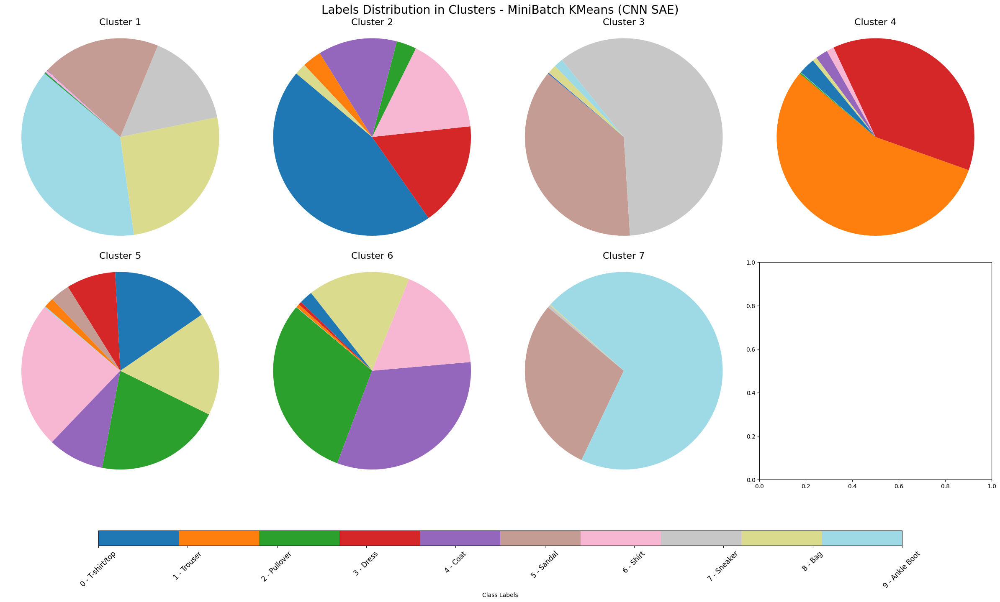

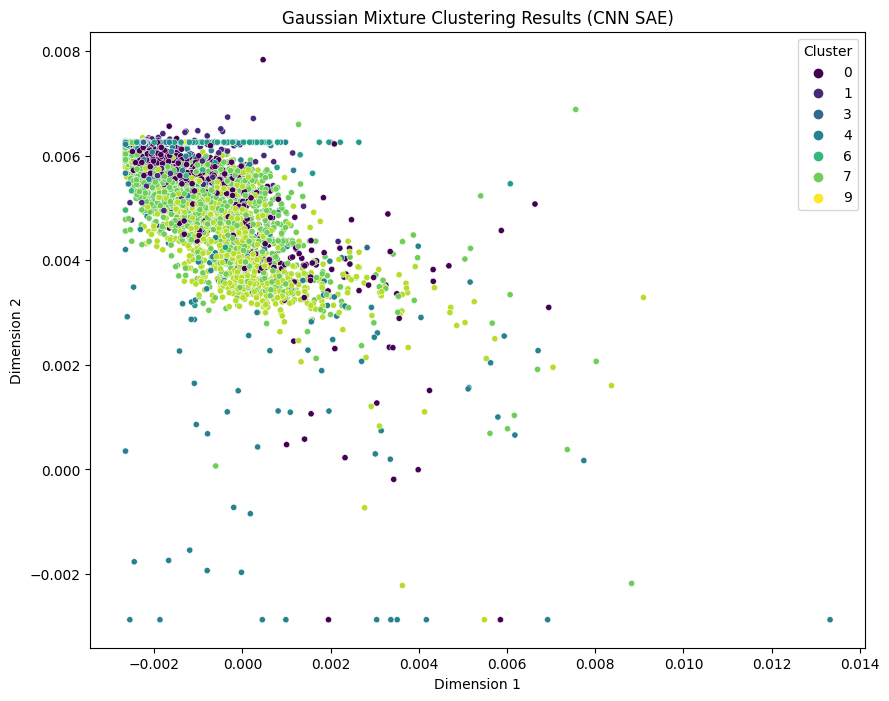

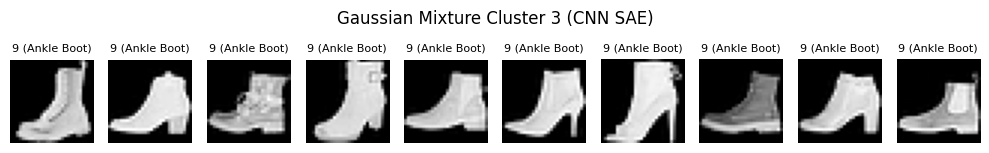

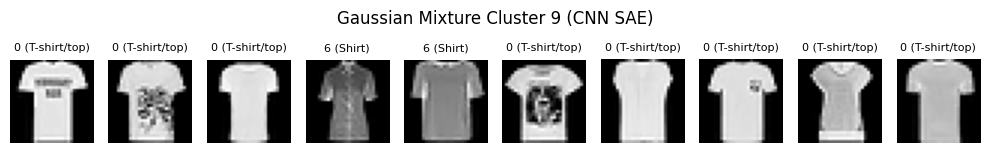

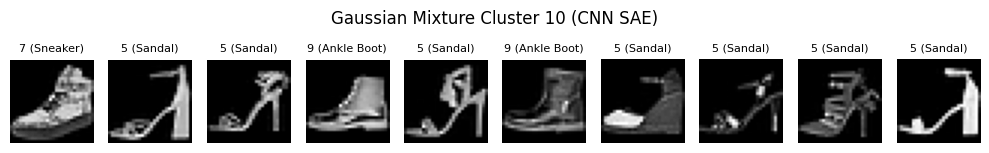

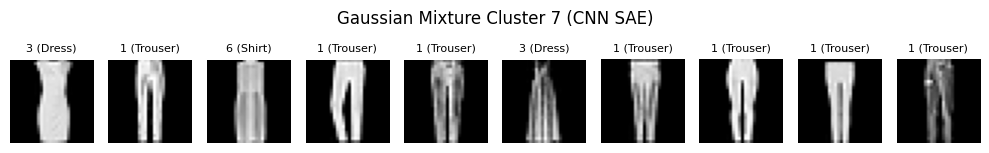

<ipython-input-91-a6092961e32f>:54: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  color_map = plt.cm.get_cmap('tab20', num_labels)
<ipython-input-91-a6092961e32f>:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


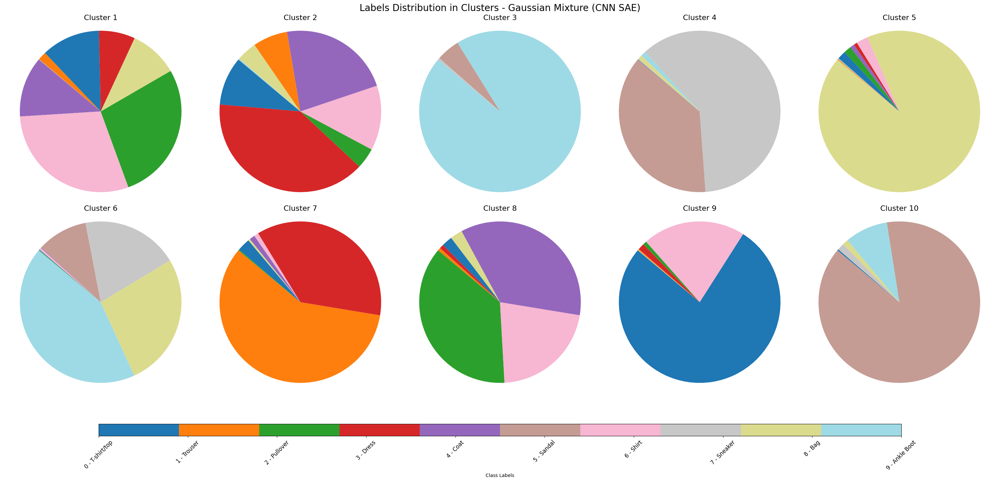

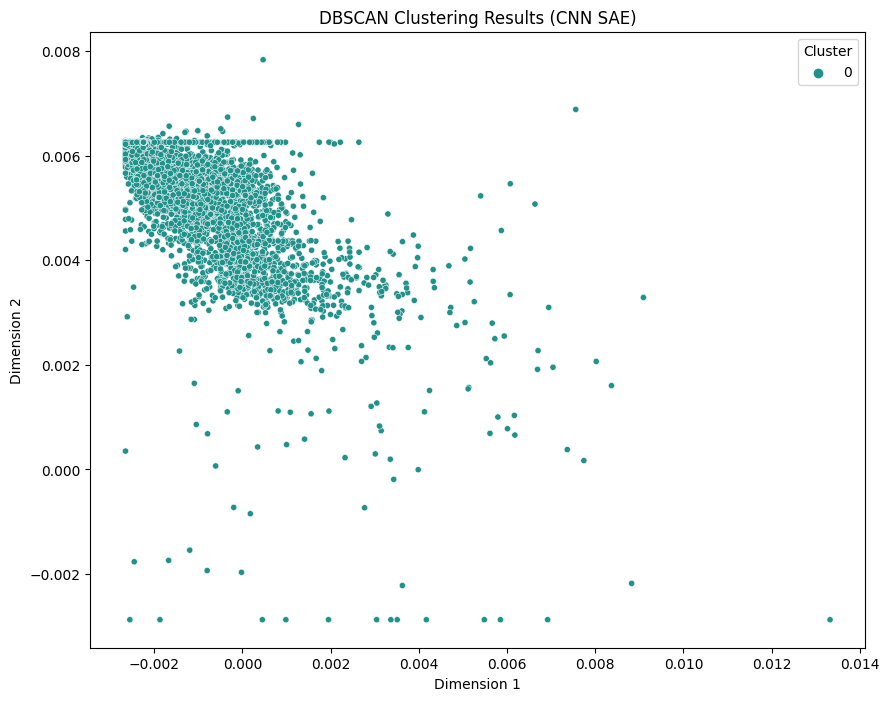

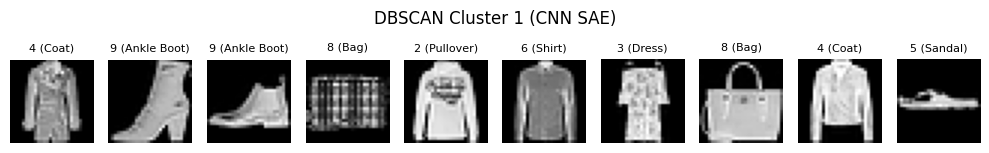

<ipython-input-91-a6092961e32f>:54: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  color_map = plt.cm.get_cmap('tab20', num_labels)
<ipython-input-91-a6092961e32f>:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


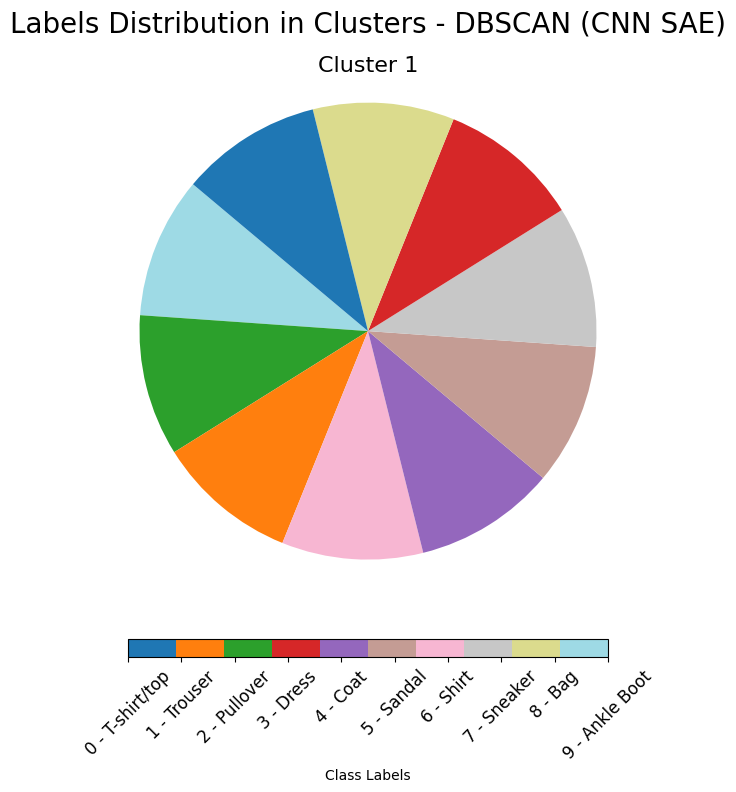

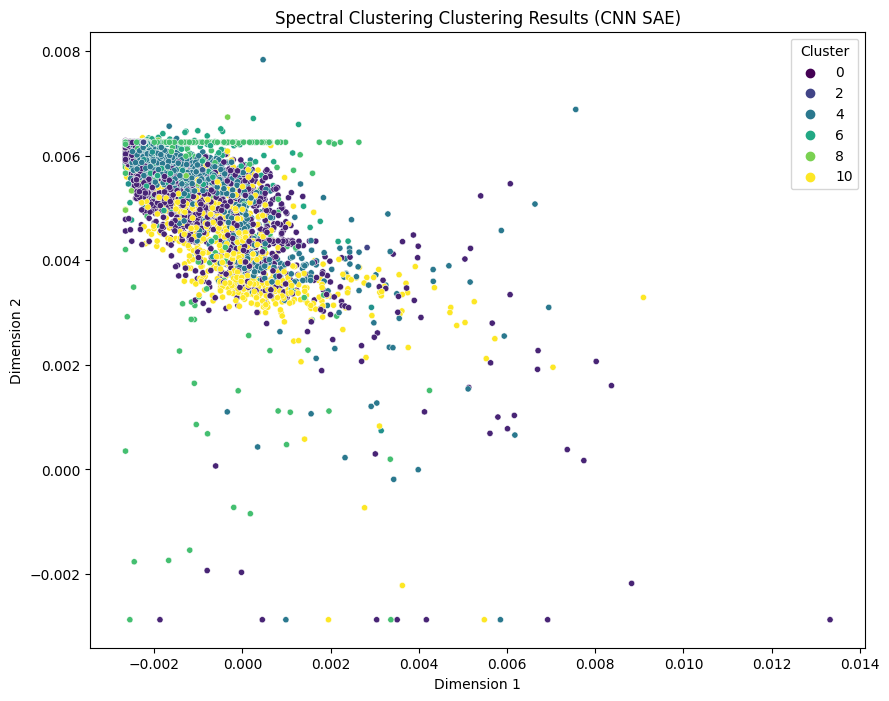

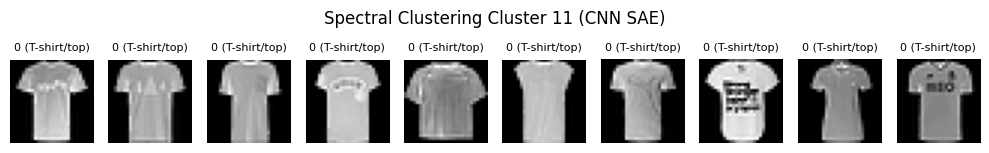

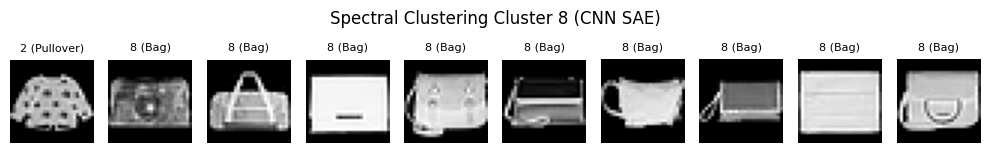

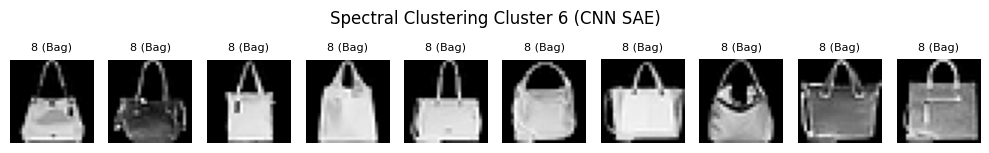

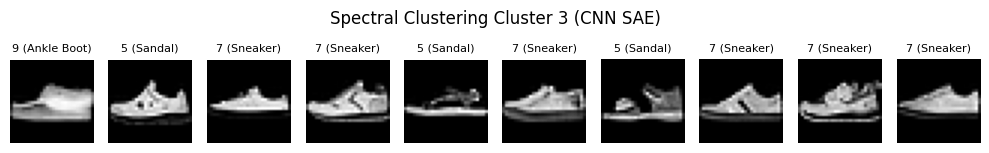

<ipython-input-91-a6092961e32f>:54: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  color_map = plt.cm.get_cmap('tab20', num_labels)
<ipython-input-91-a6092961e32f>:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


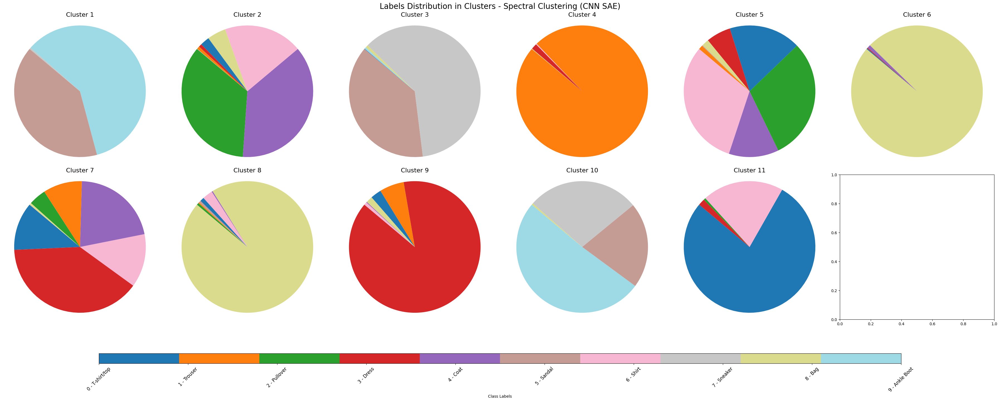

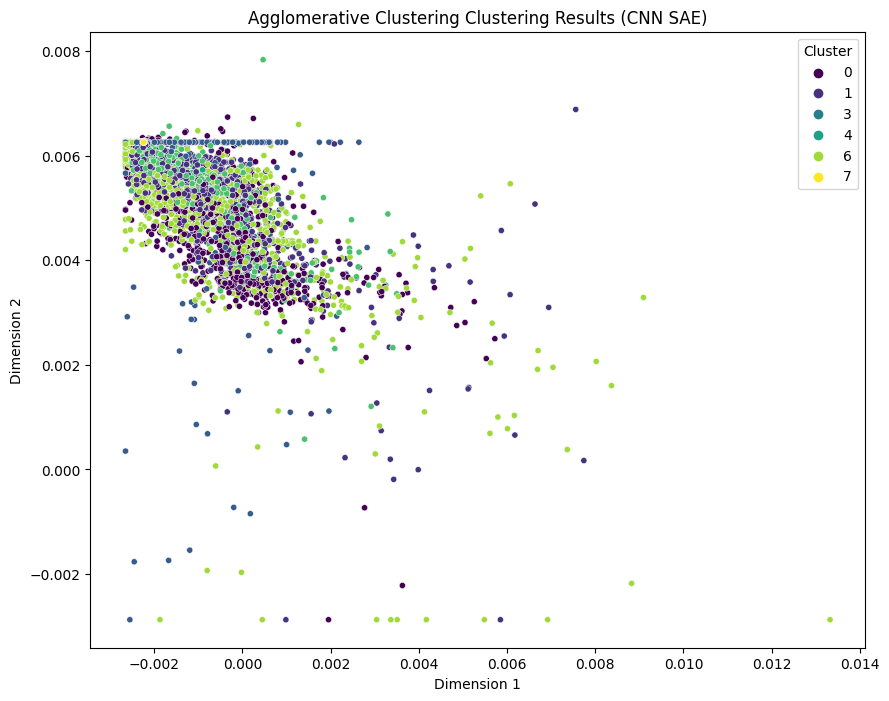

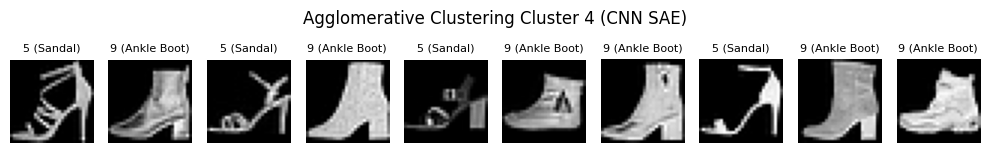

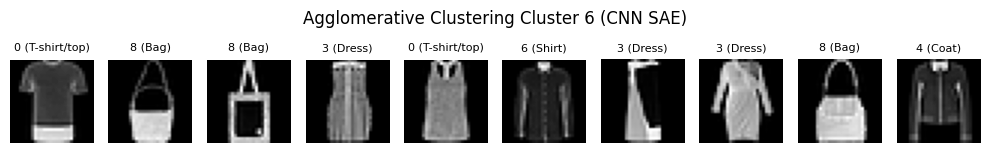

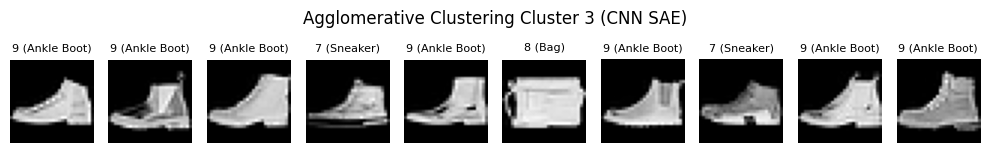

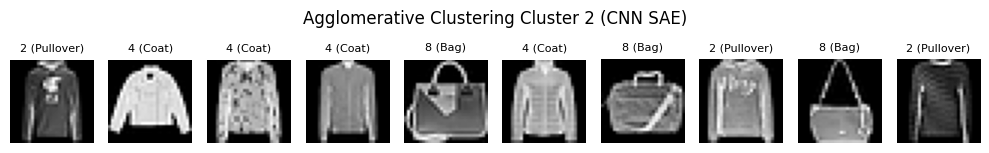

<ipython-input-91-a6092961e32f>:54: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  color_map = plt.cm.get_cmap('tab20', num_labels)
<ipython-input-91-a6092961e32f>:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


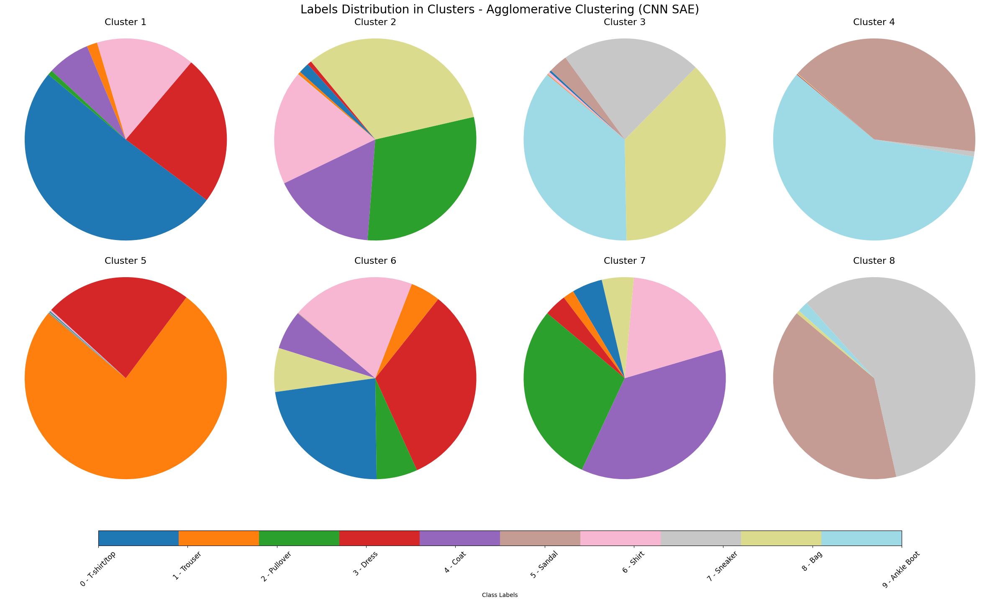

In [ ]:
# @title CNN SAE
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D
from tensorflow.keras.optimizers import Adam
from keras.utils import plot_model
from tensorflow.keras.layers import Dropout, BatchNormalization

from keras import backend as K
K.clear_session()

name = "CNN SAE"

def CSAE_constructor():
    input_img = Input(shape=(28, 28, 1))

    x = Conv2D(32, (3, 3), activation='relu', padding='same')(input_img)
    x = BatchNormalization()(x)
    x = MaxPooling2D((2, 2), padding='same')(x)
    x = Conv2D(16, (3, 3), activation='relu', padding='same')(x)
    x = BatchNormalization()(x)
    x = MaxPooling2D((2, 2), padding='same')(x)
    x = Conv2D(8, (3, 3), activation='relu', padding='same')(x)
    encoded = MaxPooling2D((2, 2), padding='same')(x)

    x = Conv2D(8, (3, 3), activation='relu', padding='same')(encoded)
    x = UpSampling2D((2, 2))(x)
    x = Conv2D(16, (3, 3), activation='relu', padding='same')(x)
    x = UpSampling2D((2, 2))(x)
    x = Conv2D(32, (3, 3), activation='relu')(x)
    x = UpSampling2D((2, 2))(x)
    decoded = Conv2D(1, (3, 3), activation='sigmoid', padding='same')(x)

    autoencoder = Model(input_img, decoded)

    return autoencoder

conv_ae =  CSAE_constructor()
conv_ae.compile(optimizer=Adam(), loss='mean_squared_error')
conv_ae.summary()

# Reshape as Images
x_train_reshaped = x_train.reshape(-1, 28, 28)
x_test_reshaped = x_test.reshape(-1, 28, 28)
x_val_reshaped = x_val.reshape(-1, 28, 28)

# Train CSAE
start_time = time.time()
conv_ae_fit = conv_ae.fit(x_train_reshaped, x_train_reshaped,
                epochs=10,
                batch_size=128,
                shuffle=True,
                validation_data=(x_val_reshaped, x_val_reshaped))
end_time = time.time()

# Extract the encoder part from the trained CSAE
encoder_layers = conv_ae.layers[1:7]  # Extract layers from input to the last layer of the encoder
encoder = Model(inputs=conv_ae.input, outputs=encoder_layers[-1].output)

# Make Predictions
reconstructed = conv_ae.predict(x_test_reshaped)
x_test_reduced = encoder.predict(x_test_reshaped)
print(f"Original Shape:{x_test.shape}   Reduced Shape:{x_test_reduced.shape}")

# Plots
show_plot_model(conv_ae)
plot_loss(conv_ae_fit)
visualize_filters(conv_ae, 0)
plot_feature_maps(x_test_reduced, sample_index=0)
compare_images_plot(x_test, reconstructed, y_test, name)
display_case_studies(reconstructed, name)

# Clustering + Metrics
data['Dimensionality Reduction Technique'] = name
data['Training Time'] = end_time - start_time
x_test_reduced = preprocess_data(x_test_reduced)
df = clustering_metric_loop(df, x_test_reduced, name)

In [ ]:
# @title Print Dataframe
from IPython.display import display

display(df)
df.to_csv('df.csv')

,Dimensionality Reduction Technique,Clustering Algorithm,Training Time,Execution Time,Number of Clusters,Calinski–Harabasz,Davies–Bouldin,Silhouette Coefficient,Adjusted Rand Index
0,NaN,MiniBatch KMeans,NaN,0.569973,7,1458.139106,2.120687,0.14277,0.327078
1,NaN,Gaussian Mixture,NaN,226.285828,10,1053.556578,2.091835,0.120216,0.398149
2,NaN,DBSCAN,NaN,5.009519,1,NaN,NaN,NaN,NaN
3,NaN,Spectral Clustering,NaN,14.408930,11,1117.814945,1.981281,0.145695,0.380276
4,NaN,Agglomerative Clustering,NaN,36.839825,8,1270.351124,1.945353,0.120939,0.32041
5,PCA,MiniBatch KMeans,2.394890,0.290982,7,1456.603794,2.076162,0.135849,0.287677
6,PCA,Gaussian Mixture,2.394890,8.061339,10,820.584661,3.081163,0.087159,0.39058
7,PCA,DBSCAN,2.394890,0.377493,3,525.418188,1.565217,-0.035141,0.024151
8,PCA,Spectral Clustering,2.394890,8.896297,11,1130.634342,1.920112,0.138348,0.430776
9,PCA,Agglomerative Clustering,2.394890,8.384504,8,1301.238993,1.776801,0.149711,0.383933
